Please run those two cells before running the Notebook!

As those plotting settings are standard throughout the book, we do not show them in the book every time we plot something.

In [1]:
# %matplotlib inline
%config InlineBackend.figure_format = "retina"

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
from pandas.errors import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

# feel free to modify, for example, change the context to "notebook"
sns.set_theme(context="talk", style="whitegrid", 
              palette="colorblind", color_codes=True, 
              rc={"figure.figsize": [12, 8]})

In [3]:
import matplotlib.pyplot as plt


def get_font_family():
    import platform
    system_name = platform.system()
    if system_name == "Darwin" :
        font_family = "AppleGothic"
    elif system_name == "Windows":
        font_family = "Malgun Gothic"
    elif system_name == "Linux":
        font_family = "NanumGothic"
    return font_family


font_family = get_font_family()
plt.rc("font", family=font_family)
plt.rc('axes', unicode_minus=False)

# Chapter 14 - 머신러닝 프로젝트를 위한 고급 개념

이전 장에서는 머신러닝을 사용하여 실제 문제를 해결하기 위한 가능한 워크플로를 소개했습니다. 우리는 데이터를 청소하고, 모델을 훈련하고 튜닝하며, 마지막으로 모델의 성능을 평가하는 전체 프로젝트를 살펴보았습니다. 그러나 실제로는 여기서 프로젝트가 끝나지 않습니다. 이전 프로젝트에서는 단순한 결정 트리 분류기를 사용했으며, 이는 대부분 최소 실행 가능한 제품(MVP) 또는 벤치마크로 사용할 수 있습니다. 이 장에서는 프로젝트의 가치를 높이고 비즈니스 이해관계자들이 보다 쉽게 적응할 수 있도록 하는 몇 가지 고급 개념을 다룹니다.

MVP를 생성한 후, 이를 기준으로 삼아 모델의 성능을 향상시키고 싶어질 것입니다. 모델의 성능을 개선하려고 할 때, 과소적합과 과적합의 균형을 맞추는 것도 중요합니다. 이를 위한 몇 가지 방법이 있으며, 다음과 같은 사항들이 포함됩니다:

- **더 많은 데이터 수집 (관찰값)**
- **더 많은 특징 추가** - 예를 들어 외부 데이터 소스를 사용하거나 현재 사용 가능한 정보로 특징 공학을 수행하여 데이터에 추가합니다.
- **더 복잡한 모델 사용**
- **관련 특징만 선택**
- **하이퍼파라미터 튜닝**

데이터 과학자들이 실제 모델링에 20%의 시간을 사용하면서 데이터 수집 및 정리에 80%의 시간을 사용한다는 일반적인 고정관념이 있습니다. 이와 같은 고정관념에 맞춰, 더 많은 데이터를 추가하면 모델의 성능이 크게 향상될 수 있습니다. 특히 분류 문제에서 불균형한 데이터 문제를 다룰 때는 더욱 그렇습니다. 그러나 추가 데이터(관찰값 또는 특징)가 항상 가능한 것은 아니며, 단순히 너무 복잡할 수도 있습니다. 이 경우 더 복잡한 모델을 사용하거나 하이퍼파라미터를 튜닝하여 약간의 성능 향상을 추구할 수 있습니다.

이 장의 첫 부분에서는 보다 진보된 분류기 사용법에 대해 설명할 것입니다. 이러한 분류기는 결정 트리에도 기반을 두고 있습니다. 그중 일부(XGBoost 및 LightGBM)는 카글과 같은 머신러닝 대회에서 성공적인 모델로 자주 사용됩니다. 또한 머신러닝 모델 스태킹의 개념을 도입하여 예측 성능을 추가로 향상시키는 방법을 설명합니다.

또 다른 실제 문제는 불균형한 데이터와 관련이 있습니다. 즉, 하나의 클래스(예: 연체 또는 사기)가 실제로는 거의 관찰되지 않는 경우입니다. 이는 소수 클래스 관찰값을 정확하게 캡처하는 모델을 학습시키기 어렵게 만듭니다. 신용카드 사기 데이터셋에서 소수 클래스가 전체 관찰값의 0.17%에 불과한 경우를 예시로 들며, 이러한 불균형 문제를 처리하는 몇 가지 일반적인 접근 방식을 소개하고 성능을 비교합니다.

또한, 하이퍼파라미터 튜닝에 대해서도 설명합니다. 이전 장에서는 그리드 검색이나 무작위 검색을 사용했으며, 이 방법들은 모두 비정보 방식으로 수행됩니다. 이 장에서는 Bayesian 최적화를 도입하여 특정 값을 탐색할 선택을 돕는 과거 관찰값을 사용하여 탐색을 진행합니다. 이는 프로젝트의 튜닝 단계를 크게 단축시킬 수 있습니다.

많은 산업(특히 금융)에서는 모델의 예측 뒤에 있는 논리를 이해하는 것이 중요합니다. 예를 들어, 은행은 대출 부결 사유를 제공해야 하는 법적 의무가 있을 수 있으며, 대출 연체 가능성을 예측하여 고객에게 대출 한도를 줄일 수도 있습니다. 모델의 설명 가능성을 높이기 위해, 특징 중요도와 모델 설명 가능성을 평가하는 다양한 접근 방식을 탐구합니다. 특히, 블랙박스로 여겨지는 복잡한 모델에서 설명 가능성은 중요하며, 이러한 통찰력을 활용해 가장 관련성이 높은 특징만 선택함으로써 모델의 성능을 더욱 향상시킬 수 있습니다.

이 장에서는 다음과 같은 몇 가지 고급 개념을 소개합니다:

- 앙상블 분류기 탐구
- 범주형 특징을 인코딩하는 대체 접근 방식 탐구
- 불균형 데이터 처리에 대한 다양한 접근 방식 조사
- 스태킹 앙상블에서 군중의 지혜 활용
- Bayesian 하이퍼파라미터 최적화
- 특징 중요도 조사
- 특징 선택 기술 탐구
- 설명 가능한 AI 기술 탐구

## 14.1 앙상블 분류기 탐구 

**13장, "적용된 머신러닝: 신용 불이행 예측"** 에서는 전체 머신러닝 파이프라인을 구축하는 방법을 학습했습니다. 이 과정에는 결측값 대체, 범주형 특징 인코딩 등의 전처리 단계와 머신러닝 모델이 포함됩니다. 우리의 작업은 고객의 신용 불이행, 즉 부채 상환 불가능성을 예측하는 것이었으며, 분류기로 결정 트리 모델을 사용했습니다.

결정 트리는 간단한 모델로 간주되며, 그 단점 중 하나는 훈련 데이터에 대한 과적합입니다. 결정 트리는 고분산 모델 그룹에 속하는데, 이는 훈련 데이터의 작은 변화가 트리 구조와 예측에 큰 영향을 미칠 수 있음을 의미합니다. 이러한 문제를 해결하기 위해 결정 트리와 같은 모델들을 앙상블 모델의 구성 요소로 사용하여 최종 모델의 일반화 성능과 견고성을 향상시킬 수 있습니다. 이렇게 하면 초기 고분산 추정치가 저분산의 집합 추정치로 변환됩니다.

높은 수준에서 앙상블 모델은 두 가지 그룹으로 나눌 수 있습니다:

- **평균화 방법** - 여러 모델을 독립적으로 예측하여 평균을 구합니다. 이러한 방법은 결합된 모델이 하나의 모델보다 분산이 줄어들어 더 나은 성능을 갖게 됩니다. 예시: 랜덤 포레스트, 극도로 무작위화된 트리.
- **부스팅 방법** - 이 접근법에서는 여러 기본 추정치를 순차적으로 구축하며, 각 추정치는 결합된 추정치의 편향을 줄이기 위해 노력합니다. 이 방법의 기본 가정은 여러 약한 모델의 결합이 강력한 앙상블을 만든다는 것입니다. 예시: 그래디언트 부스팅 트리, XGBoost, LightGBM, CatBoost.

이 레시피에서는 앙상블 모델을 선택하여 결정 트리 접근법의 성능을 개선하려고 합니다. 이러한 모델들은 결정 트리에 기반하므로, 특징 스케일링에 대한 동일한 원칙이 적용되며(명시적인 필요성 없음), 이전에 생성된 파이프라인의 대부분을 재사용할 수 있습니다.

### Getting Ready

이 레시피에서는 이전 장의 "파이프라인으로 프로젝트 구성하기" 레시피에서 이미 구축한 신용 불이행 예측 파이프라인을 바탕으로 합니다. 여기에는 데이터를 불러오고 분류기를 학습시키는 과정이 포함됩니다.

이 레시피에서는 이상치 제거 절차가 없는 변형을 사용합니다. 우리는 마지막 단계(분류기)를 더 복잡한 앙상블 모델로 대체할 것입니다. 또한, 데이터에서 기본 모델의 성능을 비교하기 위해 먼저 결정 트리 파이프라인을 피팅합니다. 독자의 편의를 위해, 이 장과 함께 제공되는 노트북에 모든 필수 단계를 다시 설명했습니다.

Prepare the Pipeline:

In [4]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from chapter_14_utils import performance_evaluation_report

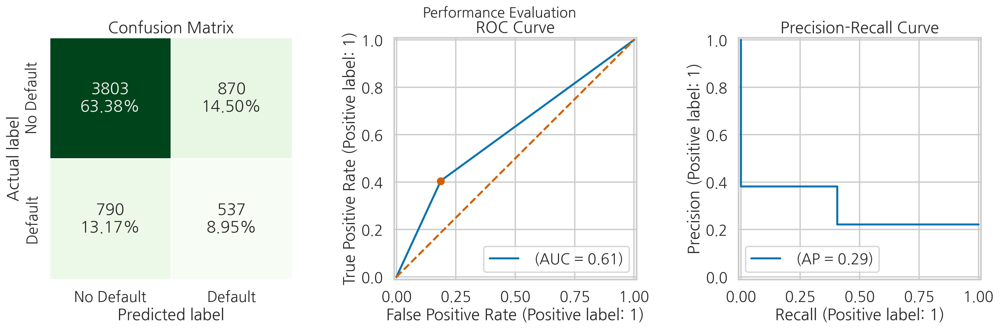

In [6]:
# 신용카드 불이행 데이터셋 로드
df = pd.read_csv("./datasets/credit_card_default.csv", na_values="")

# 특징(X)과 타겟(y) 분리
X = df.copy()
y = X.pop("default_payment_next_month")  # 타겟 변수 추출

# 훈련/테스트 데이터 분할 (80:20 비율)
# stratify=y로 타겟 변수의 분포 유지
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    stratify=y, 
                                                    random_state=42)

# 수치형과 범주형 특징 구분
num_features = X_train.select_dtypes(include="number").columns.to_list()  # 수치형 특징
cat_features = X_train.select_dtypes(include="object").columns.to_list()  # 범주형 특징

# 수치형 특징을 위한 파이프라인 - 중앙값으로 결측치 대체
num_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median"))
])

# 각 범주형 특징의 고유값 목록 생성
cat_list = [list(X_train[col].dropna().unique()) for col in cat_features]

# 범주형 특징을 위한 파이프라인
# 1. 최빈값으로 결측치 대체
# 2. 원-핫 인코딩 (첫 번째 카테고리는 제외)
cat_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("onehot", OneHotEncoder(categories=cat_list, sparse_output=False, 
                            handle_unknown="error", drop="first"))
])

# 수치형과 범주형 파이프라인을 결합
preprocessor = ColumnTransformer(
    transformers=[
        ("numerical", num_pipeline, num_features),
        ("categorical", cat_pipeline, cat_features)
    ], 
    remainder="drop"  # 지정되지 않은 열은 제외
)

# 전처리기와 결정트리 분류기를 결합한 최종 파이프라인
tree_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor),
           ("classifier", DecisionTreeClassifier(random_state=42))]
)

# 파이프라인 학습
tree_pipeline.fit(X_train, y_train)

# 성능 평가 
LABELS = ["No Default", "Default"]  # 클래스 레이블 정의
tree_perf = performance_evaluation_report(tree_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True, 
                                          show_pr_curve=True)

의사 결정 트리 모델의 성능 평가

In [7]:
print(f"Recall: {tree_perf['recall']:.4f}")

Recall: 0.4047


### How to do it...

이 레시피는 다양한 분류기를 사용하는 방법을 보여주며, 기본 설정만 사용할 경우 얼마나 쉬운지 설명합니다. 첫 번째 단계에서는 각 라이브러리에서 분류기를 가져옵니다.

- 이 레시피에서는 scikit-learn API와 XGBoost, LightGBM과 같은 라이브러리를 사용합니다. 그러나 이러한 라이브러리의 원래 접근 방식을 사용하여 모델을 학습할 수도 있으며, 이 경우 추가적인 작업이 필요할 수 있습니다. 예를 들어, pandas 데이터프레임을 해당 라이브러리가 허용하는 형식으로 변환하는 것이 필요할 수 있습니다. 이 원래 접근 방식을 사용하면 특정 하이퍼파라미터에 접근하거나 설정을 구성하는 데 추가적인 이점이 있을 수 있습니다.

- **2단계부터 5단계까지** 각 분류기에 대해 별도의 파이프라인을 만듭니다. 이미 설정된 `ColumnTransformer` 전처리기를 해당 분류기와 결합합니다. 그런 다음, 각 파이프라인을 학습 데이터에 맞추고 성능 평가 보고서를 제시합니다.

- 고려하는 일부 앙상블 모델은 `fit` 메서드에서 추가적인 기능을 제공합니다 (클래스 인스턴스화 시 하이퍼파라미터를 설정하는 것과는 반대로). 예를 들어, LightGBM의 `fit` 메서드를 사용할 때 범주형 특징의 이름/인덱스를 전달할 수 있으며, 이를 통해 알고리즘이 해당 특징을 자체적인 방식으로 처리하는 방법을 알 수 있습니다. 이와 같이 다양한 콜백을 사용할 수 있습니다.

최신 파이썬 라이브러리를 통해 이러한 분류기를 맞추는 과정이 매우 쉬워집니다. 우리는 파이프라인에서 모델의 클래스를 다른 것으로 교체하기만 합니다. 다양한 모델을 실험하기가 얼마나 간단한지 고려할 때, 이러한 모델들이 무엇을 하고 강점과 약점이 무엇인지 기본적인 이해를 가지고 있는 것이 좋습니다. 아래에서는 고려하는 알고리즘에 대해 간단히 소개합니다.

1. Import the libraries:

In [8]:
# 앙상블 학습 모델들을 임포트합니다
from sklearn.ensemble import (RandomForestClassifier,  # 랜덤 포레스트 분류기
                              GradientBoostingClassifier)  # 그래디언트 부스팅 분류기

# XGBoost 분류기를 임포트합니다 - 고성능 그래디언트 부스팅 구현체
from xgboost.sklearn import XGBClassifier

# LightGBM 분류기를 임포트합니다 - 빠르고 효율적인 그래디언트 부스팅 구현체  
from lightgbm import LGBMClassifier

# 모델 성능 평가를 위한 유틸리티 함수를 임포트합니다
from chapter_14_utils import performance_evaluation_report

2. Define and fit the Random Forest pipeline: 

**랜덤 포레스트**

랜덤 포레스트는 앙상블 모델의 예로, 여러 모델(결정 트리)을 학습하고 이를 사용해 예측을 생성합니다. 회귀 문제의 경우 모든 기저 트리의 평균값을 사용합니다. 분류의 경우 다수결 투표 방식을 사용합니다. 랜덤 포레스트는 단순히 많은 트리를 학습하고 결과를 집계하는 것 이상을 제공합니다.

- 먼저 부트스트랩 집계를 사용합니다. 각 트리는 모든 가능한 관측치의 하위 집합에서 학습됩니다. 이는 대체 샘플링을 통해 무작위로 선택되며, 특별히 지정하지 않는 한 각 트리에 사용되는 전체 관측치 수는 학습 세트 전체와 동일합니다. 단일 트리가 특정 데이터셋에 대해 높은 분산을 가질 수 있지만 (부트스트래핑 덕분에) 포레스트는 편향을 증가시키지 않고도 전반적으로 낮은 분산을 가지게 됩니다. 또한, 이 접근 방식은 모든 특징이 모든 트리에 사용되지 않으므로, 이상치의 영향을 줄일 수 있습니다. 각 스플릿을 생성할 때 각 트리가 사용할 특징의 하위 집합만 고려하여 무작위성을 추가합니다. 그 숫자는 특정 하이퍼파라미터를 통해 제어할 수 있습니다.

이 두 가지 메커니즘 덕분에 포레스트 내의 트리들은 서로 상관관계가 없고 독립적으로 구축됩니다. 후자는 트리 빌딩 단계의 병렬 처리를 허용합니다.

랜덤 포레스트는 복잡성과 성능 간의 적절한 균형을 제공합니다. 종종 추가 튜닝 없이도, 결정 트리나 선형/로지스틱 회귀와 같은 단순한 알고리즘을 사용할 때보다 더 나은 성능을 얻을 수 있습니다. 이는 랜덤 포레스트가 낮은 편향(유연성 덕분에)과 낮은 분산(여러 모델의 예측을 집계함으로써)을 제공하기 때문입니다.

<img src="https://velog.velcdn.com/images/chanhee-kang/post/e5b7b5fb-6da8-4d71-947c-62af9652be8c/image.png" alt="랜덤 포레스트 모델의 성능 평가">

Recall: 0.3542


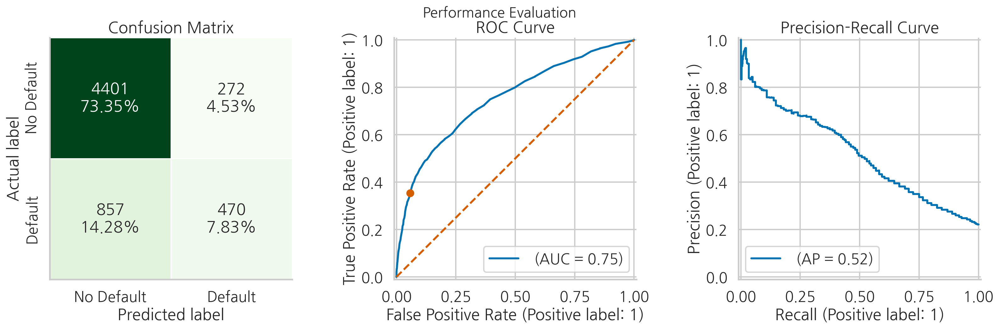

In [9]:
# 랜덤 포레스트 분류기를 생성합니다. random_state를 42로 설정하여 재현성을 확보합니다.
rf = RandomForestClassifier(random_state=42)

# 전처리기와 분류기를 포함하는 파이프라인을 생성합니다.
rf_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor),  # 데이터 전처리 단계
           ("classifier", rf)]              # 랜덤 포레스트 분류 단계
)

# 학습 데이터로 모델을 학습시킵니다
rf_pipeline.fit(X_train, y_train)

# 테스트 데이터로 모델의 성능을 평가합니다
# show_plot=True로 설정하여 ROC 곡선을 시각화합니다
# show_pr_curve=True로 설정하여 정밀도-재현율 곡선도 함께 표시합니다
rf_perf = performance_evaluation_report(rf_pipeline, X_test, 
                                        y_test, labels=LABELS, 
                                        show_plot=True,
                                        show_pr_curve=True)
                                        
# 재현율(민감도) 점수를 출력합니다
print(f"Recall: {rf_perf['recall']:.4f}")

# 그래프의 테두리를 제거하여 시각화를 깔끔하게 만듭니다
sns.despine()
# plt.savefig("images/figure_14_1", dpi=200)  # 그래프 저장 코드 (현재는 주석 처리됨)

그림 14.1: 랜덤 포레스트 모델의 성능 평가

3. Define and fit the Gradient Boosted Trees pipeline: 

**그래디언트 부스티드 트리**

그래디언트 부스티드 트리는 또 다른 유형의 앙상블 모델입니다. 이 모델의 아이디어는 여러 약한 학습기(높은 편향을 가진 얕은 결정 트리 또는 스텀프)를 학습시켜 강력한 학습기를 얻는 것입니다. 랜덤 포레스트와 달리, 그래디언트 부스티드 트리는 순차적/반복적 알고리즘입니다. 부스팅에서는 첫 번째 약한 학습기로 시작하고, 이후 학습기들이 이전 모델들의 잔차(오차 항)에 맞춰 학습하려고 시도합니다.

약한 학습기 앙상블을 만드는 이유는 강한 학습기의 경우 오차나 잘못 분류된 데이터 포인트가 대부분 데이터의 잡음일 가능성이 높아지기 때문에, 전체 모델이 학습 데이터에 과적합될 가능성이 높아지기 때문입니다.

**그래디언트**라는 용어는 트리가 그래디언트 디센트를 사용해 구축된다는 사실에서 유래합니다. 그래디언트 디센트는 최적화 알고리즘으로, 손실 함수의 그래디언트(기울기)를 사용해 전체 손실을 최소화하고 최고의 성능을 달성합니다. 손실 함수는 실제 값과 예측 값 간의 차이를 나타냅니다. 실제로 그래디언트 디센트 절차를 수행하기 위해, 그래디언트를 따르는 트리를 모델에 추가해 손실 함수의 값을 줄입니다.

부스팅 절차는 다음 단계로 설명할 수 있습니다:

1. 간단한 추정치(평균, 중앙값 등)로 시작합니다.
2. 예측의 오차에 대해 트리를 맞춥니다.
3. 예측을 트리의 예측으로 조정합니다. 그러나 이는 완전히 조정되는 것이 아니라, 학습률 하이퍼파라미터에 따라 일정 부분만 조정됩니다.
4. 또 다른 트리를 업데이트된 예측의 오차에 맞추고, 이전 단계와 같이 예측을 추가로 조정합니다.
5. 알고리즘은 지정된 라운드 수(또는 다른 종료 기준)에 도달할 때까지 오차를 반복적으로 줄여 나갑니다.
6. 최종 예측은 초기 예측과 모든 조정(학습률로 가중치가 적용된 오차 예측)의 합이 됩니다.

---

**랜덤 포레스트와의 비교**  
랜덤 포레스트와 달리, 그래디언트 부스티드 트리는 모델 학습을 위해 모든 데이터를 사용합니다. 그러나 `subsample` 하이퍼파라미터를 사용해 중복 없이 무작위 샘플링을 할 수도 있습니다. 이를 통해 확률적 그래디언트 부스티드 트리(Stochastic Gradient Boosted Trees)를 사용할 수 있습니다. 또한 랜덤 포레스트와 마찬가지로 분할 시 트리가 고려하는 특징의 일부만 사용하게 할 수 있습니다.

<img src="https://blog.kakaocdn.net/dn/cJoJOG/btq4OrtT2MK/0kSk2zJvPk3bVokacWRLUk/img.png" width=800>

Recall: 0.3323


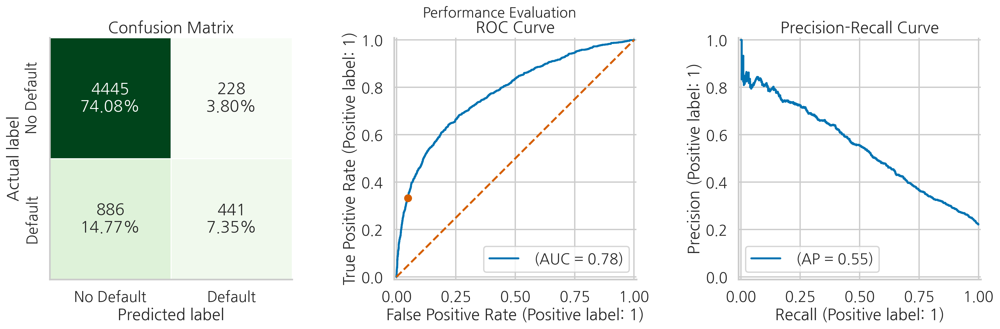

In [11]:
# 그래디언트 부스팅 분류기를 생성합니다. random_state를 42로 설정하여 재현성을 확보합니다.
gbt = GradientBoostingClassifier(random_state=42)

# 전처리기와 그래디언트 부스팅 분류기를 포함하는 파이프라인을 생성합니다.
gbt_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor),  # 데이터 전처리 단계
           ("classifier", gbt)]             # 그래디언트 부스팅 분류 단계
)

# 학습 데이터로 모델을 학습시킵니다
gbt_pipeline.fit(X_train, y_train)

# 테스트 데이터로 모델의 성능을 평가합니다
# show_plot=True로 설정하여 ROC 곡선을 시각화합니다
# show_pr_curve=True로 설정하여 정밀도-재현율 곡선도 함께 표시합니다
gbt_perf = performance_evaluation_report(gbt_pipeline, X_test, 
                                         y_test, labels=LABELS, 
                                         show_plot=True,
                                         show_pr_curve=True)

# 재현율(민감도) 점수를 출력합니다
print(f"Recall: {gbt_perf['recall']:.4f}")

# 그래프의 테두리를 제거하여 시각화를 깔끔하게 만듭니다
sns.despine()
# plt.savefig("images/figure_14_2", dpi=200)  # 그래프 저장 코드 (현재는 주석 처리됨)


그림 14.2: 그래디언트 부스팅 트리 모델의 성능 평가

4. Define and fit an XGBoost pipeline: 

**XGBoost**

익스트림 그래디언트 부스팅(XGBoost)은 그래디언트 부스티드 트리의 구현 중 하나로, 성능 개선을 위해 여러 향상을 통합하여 평가 지표와 추정 시간 측면에서 우수한 성능을 보여줍니다. 이 알고리즘은 발표 이후 여러 데이터 과학 대회에서 성공적으로 사용됩니다.

이 레시피에서는 XGBoost의 주요 기능에 대해 간략하게 소개합니다. 자세한 내용은 원본 논문(Chen et al., 2016)이나 문서를 참고하세요. XGBoost의 주요 개념은 다음과 같습니다:

- XGBoost는 사전 정렬 알고리즘과 히스토그램 기반 알고리즘을 결합해 최적의 분할을 계산합니다. 이는 모든 가능한 분할에 대한 잠재적 손실을 고려하므로, 수백 또는 수천 개의 특징을 다룰 때 중요한 그래디언트 부스티드 트리의 비효율성을 해결합니다.
- 이 알고리즘은 뉴턴-랩슨 방법을 사용해 손실 함수를 근사하여 다양한 손실 함수를 사용할 수 있게 합니다.
- XGBoost는 트리 간 상관 관계를 줄이기 위해 추가 랜덤화 매개변수를 제공합니다.
- XGBoost는 과적합 방지를 위해 Lasso(L1) 및 Ridge(L2) 정규화를 결합합니다.
- 더 효율적인 트리 가지치기 접근 방식을 제공합니다.
- XGBoost는 단조 제약이라는 기능을 가지며, 일부 정확도를 희생하고 학습 시간을 증가시켜 모델의 해석 가능성을 높입니다.
- XGBoost는 범주형 특징을 입력으로 받지 않으므로, 인코딩을 사용해야 합니다.
- 이 알고리즘은 데이터의 결측값을 처리할 수 있습니다.

Recall: 0.3625


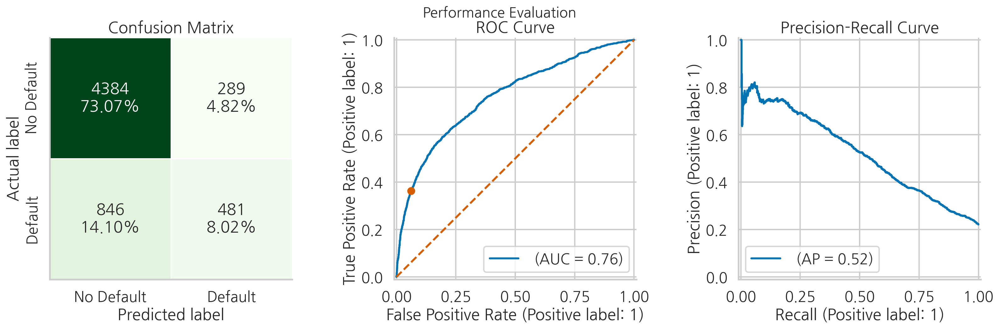

In [15]:
# XGBoost 분류기를 생성합니다. random_state를 42로 설정하여 재현성을 확보합니다.
xgb = XGBClassifier(random_state=42)

# 전처리기와 XGBoost 분류기를 포함하는 파이프라인을 생성합니다.
xgb_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor),  # 데이터 전처리 단계
           ("classifier", xgb)]             # XGBoost 분류 단계
)

# 학습 데이터로 모델을 학습시킵니다
xgb_pipeline.fit(X_train, y_train)

# 테스트 데이터로 모델의 성능을 평가합니다
# show_plot=True로 설정하여 ROC 곡선을 시각화합니다
# show_pr_curve=True로 설정하여 정밀도-재현율 곡선도 함께 표시합니다
xgb_perf = performance_evaluation_report(xgb_pipeline, X_test, 
                                         y_test, labels=LABELS, 
                                         show_plot=True,
                                         show_pr_curve=True)

# 재현율(민감도) 점수를 출력합니다                                         
print(f"Recall: {xgb_perf['recall']:.4f}")

# 그래프의 테두리를 제거하여 시각화를 깔끔하게 만듭니다
sns.despine()
# plt.savefig("images/figure_14_3", dpi=200)  # 그래프 저장 코드 (현재는 주석 처리됨)

Figure 14.3: Performance evaluation of the XGBoost model

5. Define and fit the LightGBM pipeline: 

**LightGBM**

마이크로소프트가 출시한 LightGBM은 XGBoost와 유사한 성능을 가지면서도 학습 시간이 더 빠른 그래디언트 부스티드 트리의 또 다른 구현입니다. 주요 기능은 다음과 같습니다:

- 속도 차이는 트리 성장 방식에 의해 발생합니다. 일반적으로 XGBoost와 같은 알고리즘은 레벨 단위(수평) 접근 방식을 사용하는 반면, LightGBM은 리프 단위(수직)로 트리를 성장시킵니다. 리프 단위 알고리즘은 손실 함수에서 감소가 가장 큰 리프를 선택하며, 이 방식은 레벨 단위 방식보다 수렴이 빠르지만, 작은 데이터셋에서 과적합될 가능성이 큽니다.
- LightGBM은 Gradient-based One-Side Sampling(GOSS) 기법을 사용해 최적 분할 값을 찾기 위한 데이터 인스턴스를 필터링합니다. 작은 그래디언트를 가진 관측치는 이미 잘 학습된 것으로 간주하고, 큰 그래디언트를 가진 관측치는 개선의 여지가 있습니다. GOSS는 큰 그래디언트를 가진 인스턴스를 유지하면서 작은 그래디언트를 가진 인스턴스 중 일부를 무작위로 샘플링합니다.
- LightGBM은 희소한 데이터셋을 처리하기 위해 배타적 특징 번들링(EFB)을 사용해 상호 배타적인 특징을 묶어줍니다. 이로 인해 특징 공간의 복잡도(차원)가 줄어듭니다.
- 이 알고리즘은 연속형 특징 값을 이산 구간으로 나누기 위한 히스토그램 기반 방법을 사용해 학습 속도를 높이고 메모리 사용량을 줄입니다.

리프 단위 알고리즘은 이후 XGBoost에도 추가되었으며, 이를 사용하려면 `grow_policy`를 `"lossguide"`로 설정해야 합니다.

[LightGBM] [Info] Number of positive: 5309, number of negative: 18691
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000988 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3263
[LightGBM] [Info] Number of data points in the train set: 24000, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.221208 -> initscore=-1.258639
[LightGBM] [Info] Start training from score -1.258639
Recall: 0.3632


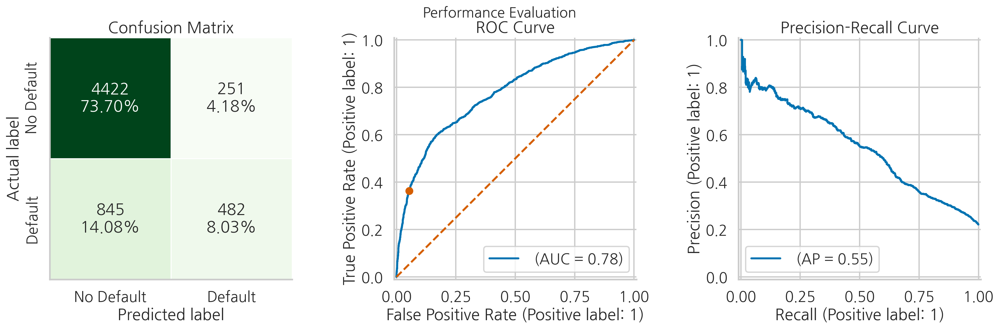

In [16]:
# LightGBM 분류기를 생성합니다. random_state를 42로 설정하여 재현성을 확보합니다.
lgbm = LGBMClassifier(random_state=42)

# 전처리기와 LightGBM 분류기를 포함하는 파이프라인을 생성합니다.
lgbm_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor),  # 데이터 전처리 단계
           ("classifier", lgbm)]            # LightGBM 분류 단계
)

# 학습 데이터로 모델을 학습시킵니다
lgbm_pipeline.fit(X_train, y_train)

# 테스트 데이터로 모델의 성능을 평가합니다
# show_plot=True로 설정하여 ROC 곡선을 시각화합니다
# show_pr_curve=True로 설정하여 정밀도-재현율 곡선도 함께 표시합니다
lgbm_perf = performance_evaluation_report(lgbm_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True,
                                          show_pr_curve=True)

# 재현율(민감도) 점수를 출력합니다
print(f"Recall: {lgbm_perf['recall']:.4f}")

# 그래프의 테두리를 제거하여 시각화를 깔끔하게 만듭니다
sns.despine()
# plt.savefig("images/figure_14_4", dpi=200)  # 그래프 저장 코드 (현재는 주석 처리됨)

Figure 14.4: Performance evaluation of the LightGBM model

### There's more

이 레시피에서는 선택한 앙상블 분류기를 사용해 고객의 대출 채무 불이행 가능성을 예측하는 능력을 개선하는 방법을 보여줍니다. 더 흥미로운 점은, 이러한 모델들이 조정할 수 있는 수십 개의 하이퍼파라미터를 가지고 있어, 성능을 크게 향상(또는 저하)시킬 수 있다는 것입니다.

간결하게 하기 위해, 여기서는 이러한 모델들의 하이퍼파라미터 조정에 대해 논의하지 않습니다. 이와 관련한 짧은 소개는 부속된 Jupyter 노트북을 참고하시기 바랍니다. 우리는 이 노트북에서 무작위 그리드 탐색 접근 방식을 사용해 이러한 모델들을 조정하는 방법을 설명합니다. 여기서는 결과를 담은 표만을 제시하며, 기본 설정의 모델과 조정된 모델의 성능을 비교할 수 있습니다.

아래에서는 고려된 모델들의 가장 중요한 하이퍼파라미터들을 살펴보고 랜덤 서치를 사용하여 이를 튜닝하는 방법을 보여줍니다. 복잡한 모델일수록 기본 의사결정 트리보다 훈련 시간이 크게 증가합니다. 따라서 하이퍼파라미터 튜닝에 투자할 시간과 기대되는 결과 사이의 균형을 찾아야 합니다. 또한 일부 파라미터(학습률이나 추정기 수 등)의 값을 변경하는 것 자체가 모델의 훈련 시간에 영향을 미칠 수 있다는 점을 유의해야 합니다.

합리적인 시간 내에 결과를 얻기 위해, 각 모델마다 100개의 서로 다른 하이퍼파라미터 세트로 랜덤 서치를 수행했습니다(교차 검증으로 인해 실제로 학습된 모델의 수는 더 많습니다).

하이퍼파라미터의 전체 목록과 의미는 해당 문서를 참조하시기 바랍니다.

이전 장과 마찬가지로 평가 지표로는 재현율을 사용했습니다.

In [12]:
# 하이퍼파라미터 튜닝을 위한 필요한 라이브러리들을 임포트합니다
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold  # 랜덤 서치와 교차 검증을 위한 도구
from sklearn import metrics  # 모델 성능 평가를 위한 지표들
import numpy as np  # 수치 연산을 위한 라이브러리

# 랜덤 서치에서 시도할 하이퍼파라미터 조합의 수를 설정합니다
N_SEARCHES = 100  # 100개의 서로 다른 하이퍼파라미터 조합을 시도

# 5-폴드 교차 검증을 위한 분할기를 생성합니다
k_fold = StratifiedKFold(5,  # 데이터를 5개의 폴드로 나눔
                        shuffle=True,  # 데이터를 섞어서 분할
                        random_state=42)  # 재현성을 위한 시드값 설정

**Random Forest**

Random Forest 분류기를 튜닝할 때 다음의 하이퍼파라미터들을 살펴봅니다(더 많은 튜닝 가능한 파라미터가 있습니다):
* `n_estimators` - 포레스트 내의 결정 트리 수. 정확도 향상과 계산 비용 사이의 균형을 찾는 것이 목표입니다.
* `max_features` - 노드 분할 시 고려할 최대 특성 수. 기본값은 특성 수의 제곱근입니다. None일 경우 모든 특성이 고려됩니다.
* `max_depth` - 각 결정 트리의 최대 레벨 수
* `min_samples_split` - 각 노드를 분할하는 데 필요한 최소 관측치 수. 너무 높게 설정하면 트리가 충분히 분할되지 않아 과소적합이 발생할 수 있습니다.
* `min_samples_leaf` - 리프에 허용되는 최소 데이터 포인트 수. 너무 작은 값은 과적합을 일으킬 수 있고, 큰 값은 트리 성장을 방해하여 과소적합을 일으킬 수 있습니다.
* `bootstrap` - 포레스트의 각 트리에 부트스트래핑을 사용할지 여부
 
아래와 같이 그리드를 정의합니다:

In [18]:
rf_param_grid = {
    "classifier__n_estimators": np.linspace(100, 500, 5, dtype=int),
    "classifier__max_features": ["log2", "sqrt", None],
    "classifier__max_depth": np.arange(3, 11, 1, dtype=int),
    "classifier__min_samples_split": [2, 5, 10],
    "classifier__min_samples_leaf": np.arange(1, 51, 2, dtype=int),
    "classifier__bootstrap": [True, False]
}

And use the randomized search to tune the classifier:

In [19]:
rf_rs =  RandomizedSearchCV(rf_pipeline, rf_param_grid, scoring="recall", 
                            cv=k_fold, n_jobs=-1, verbose=1, 
                            n_iter=N_SEARCHES, random_state=42)

rf_rs.fit(X_train, y_train)

print(f"Best parameters: {rf_rs.best_params_}") 
print(f"Recall (Training set): {rf_rs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, rf_rs.predict(X_test)):.4f}")

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best parameters: {'classifier__n_estimators': 300, 'classifier__min_samples_split': 2, 'classifier__min_samples_leaf': 7, 'classifier__max_features': None, 'classifier__max_depth': 8, 'classifier__bootstrap': False}
Recall (Training set): 0.3722
Recall (Test set): 0.3738


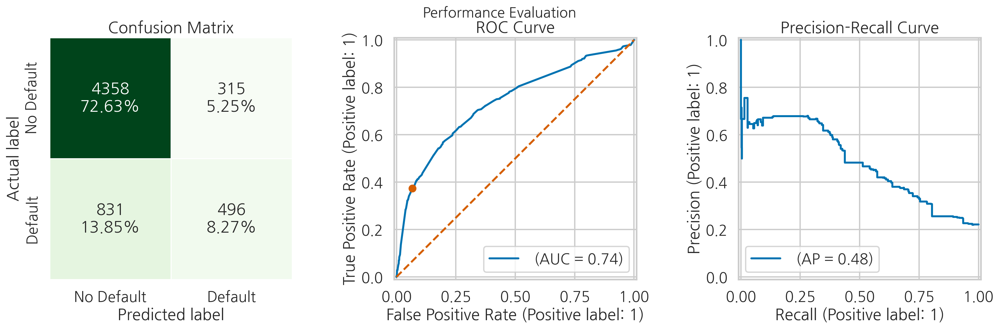

In [20]:
rf_rs_perf = performance_evaluation_report(rf_rs, X_test, 
                                           y_test, labels=LABELS, 
                                           show_plot=True,
                                           show_pr_curve=True)

**Gradient Boosted Trees**

Gradient Boosted Trees도 결정 트리를 기반으로 한 앙상블 방법이므로 많은 파라미터가 Random Forest와 동일합니다. 새로운 파라미터는 learning rate인데, 이는 경사 하강법 알고리즘에서 손실 함수의 최소값을 향해 하강하는 속도를 제어하는 데 사용됩니다. 트리를 수동으로 튜닝할 때는 이 하이퍼파라미터를 estimator의 수와 함께 고려해야 합니다. learning rate를 줄이면(학습이 더 느려짐) estimator의 수를 늘려야 하므로 계산 시간이 크게 증가할 수 있기 때문입니다.

그리드를 다음과 같이 정의합니다:

In [21]:
gbt_param_grid = {
    "classifier__n_estimators": np.linspace(100, 500, 5, dtype=int),
    "classifier__learning_rate": np.arange(0.05, 0.31, 0.05),
    "classifier__max_depth": np.arange(3, 11, 1, dtype=int),
    "classifier__min_samples_split": np.linspace(0.1, 0.5, 12),
    "classifier__min_samples_leaf": np.arange(1, 51, 2, dtype=int),
    "classifier__max_features":["log2", "sqrt", None]
}

And run the randomized search:

In [22]:
gbt_rs =  RandomizedSearchCV(gbt_pipeline, gbt_param_grid, scoring="recall", 
                             cv=k_fold, n_jobs=-1, verbose=1, 
                             n_iter=N_SEARCHES, random_state=42)

gbt_rs.fit(X_train, y_train)

print(f"Best parameters: {gbt_rs.best_params_}") 
print(f"Recall (Training set): {gbt_rs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, gbt_rs.predict(X_test)):.4f}")

Fitting 5 folds for each of 100 candidates, totalling 500 fits


In [ ]:
gbt_rs_perf = performance_evaluation_report(gbt_rs, X_test, 
                                            y_test, labels=LABELS, 
                                            show_plot=True,
                                            show_pr_curve=True)

**XGBoost**

XGBoost의 scikit-learn API는 하이퍼파라미터의 이름을 scikit-learn의 다른 분류기들과 유사하게 맞춰줍니다. 예를 들어 XGBoost의 기본 eta 하이퍼파라미터는 scikit-learn API에서 learning_rate로 불립니다.

이 예제에서 고려할 새로운 하이퍼파라미터들은 다음과 같습니다:
* `min_child_weight` - 자식 노드에 필요한 모든 관측치의 가중치 합의 최소값을 나타냅니다. 이 하이퍼파라미터는 과적합을 제어하는 데 사용됩니다. 교차 검증을 통해 튜닝해야 합니다.
* `colsample_bytree` - 각 트리에서 무작위로 샘플링할 열의 비율을 나타냅니다.

그리드를 다음과 같이 정의합니다:

In [ ]:
xgb_param_grid = {
    "classifier__n_estimators": np.linspace(100, 500, 5, dtype=int),
    "classifier__learning_rate": np.arange(0.05, 0.31, 0.05),
    "classifier__max_depth": np.arange(3, 11, 1, dtype=int),
    "classifier__min_child_weight": np.arange(1, 8, 1, dtype=int),
    "classifier__colsample_bytree": np.linspace(0.3, 1, 7)
}

colsample_bytree와 같이 제한된 범위를 가진 매개변수(1.0을 초과할 수 없음)를 정의할 때는 np.arange 대신 np.linspace를 사용하는 것이 좋습니다. np.arange는 step이 부동소수점으로 정의될 때 일관성이 없을 수 있기 때문입니다. 예를 들어 마지막 값이 1.0000000002가 될 수 있으며, 이는 분류기를 학습할 때 오류를 발생시킬 수 있습니다.

In [ ]:
xgb_rs =  RandomizedSearchCV(xgb_pipeline, xgb_param_grid, scoring="recall", 
                             cv=k_fold, n_jobs=-1, verbose=1, 
                             n_iter=N_SEARCHES, random_state=42)

xgb_rs.fit(X_train, y_train)

print(f"Best parameters: {xgb_rs.best_params_}") 
print(f"Recall (Training set): {xgb_rs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, xgb_rs.predict(X_test)):.4f}")

In [ ]:
xgb_rs_perf = performance_evaluation_report(xgb_rs, X_test, 
                                            y_test, labels=LABELS, 
                                            show_plot=True,
                                            show_pr_curve=True)

**LightGBM**

XGBoost와 동일한 파라미터를 튜닝하지만, 더 많은 파라미터 튜닝이 가능하고 권장됩니다. 그리드는 다음과 같이 정의됩니다:

In [ ]:
lgbm_param_grid = {
    "classifier__n_estimators": np.linspace(100, 500, 5, dtype=int),
    "classifier__learning_rate": np.arange(0.05, 0.31, 0.05),
    "classifier__max_depth": np.arange(3, 11, 1, dtype=int),
    "classifier__colsample_bytree": np.linspace(0.3, 1, 7)
}

In [ ]:
lgbm_rs =  RandomizedSearchCV(lgbm_pipeline, lgbm_param_grid, scoring="recall", 
                              cv=k_fold, n_jobs=-1, verbose=1, 
                              n_iter=N_SEARCHES, random_state=42)

lgbm_rs.fit(X_train, y_train)

print(f"Best parameters: {lgbm_rs.best_params_}") 
print(f"Recall (Training set): {lgbm_rs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, lgbm_rs.predict(X_test)):.4f}")

In [ ]:
lgbm_rs_perf = performance_evaluation_report(lgbm_rs, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True,
                                             show_pr_curve=True)

다음은 이 연습에서 고려한 모든 분류기에 대한 요약입니다.

In [ ]:
results_dict = {
    "decision_tree_baseline": tree_perf,
    "random_forest": rf_perf,
    "random_forest_rs": rf_rs_perf,
    "gradient_boosted_trees": gbt_perf,
    "gradient_boosted_trees_rs": gbt_rs_perf,
    "xgboost": xgb_perf,
    "xgboost_rs": xgb_rs_perf,
    "light_gbm": lgbm_perf,
    "light_gbm_rs": lgbm_rs_perf
}

results_comparison = pd.DataFrame(results_dict).T
results_comparison

In [ ]:
results_comparison.to_csv("results_comparison.csv")

In [13]:
pd.read_csv("results_comparison.csv")

,Unnamed: 0,accuracy,precision,recall,specificity,f1_score,cohens_kappa,matthews_corr_coeff,roc_auc,pr_auc,average_precision
0,decision_tree_baseline,0.723333,0.381663,0.404672,0.813824,0.392831,0.213880,0.214034,0.609528,0.458925,0.286168
1,random_forest,0.811833,0.633423,0.354182,0.941793,0.454326,0.351443,0.373145,0.751776,0.524724,0.520733
2,random_forest_rs,0.809000,0.611591,0.373775,0.932591,0.463985,0.355915,0.371897,0.735163,0.486253,0.482167
3,gradient_boosted_trees,0.814333,0.659193,0.332329,0.951209,0.441884,0.344736,0.373875,0.775486,0.547474,0.547813
4,gradient_boosted_trees_rs,0.806000,0.604891,0.354182,0.934303,0.446768,0.338752,0.356605,0.754704,0.514659,0.515193
5,xgboost,0.810833,0.624675,0.362472,0.938155,0.458751,0.353793,0.373048,0.760780,0.522614,0.523039
6,xgboost_rs,0.798833,0.569284,0.371515,0.920180,0.449612,0.333127,0.344488,0.736598,0.492717,0.493306
7,light_gbm,0.817333,0.657572,0.363225,0.946287,0.467961,0.368580,0.392264,0.775395,0.547444,0.547763
8,light_gbm_rs,0.801667,0.583232,0.361718,0.926600,0.446512,0.333692,0.347829,0.753756,0.505117,0.505704


그림 14.5: 다양한 분류기의 성능 비교 표

랜덤화된 탐색을 사용해 보정된 모델의 경우(이름에 `_rs` 접미사가 포함된 경우), 100개의 무작위 하이퍼파라미터 세트를 사용합니다. 다루는 문제는 불균형 데이터(소수 클래스가 약 20%)와 관련되어 있으므로, 성능 평가에서는 재현율을 봅니다.

기본 결정 트리가 테스트 세트에서 가장 높은 재현율 점수를 달성한 것으로 보입니다. 이는 더 낮은 정밀도로 인해 발생하며, 보다 고급 모델에서는 정밀도가 더 높습니다. 이 때문에 기본 LightGBM 모델이 테스트 세트에서 가장 높은 F1 점수를 달성합니다(F1 점수는 정밀도와 재현율의 조화 평균입니다).

이 결과는 복잡한 모델이 열등하다는 것을 의미하지 않습니다. 단지 더 많은 튜닝이나 다른 하이퍼파라미터 세트가 필요할 수 있습니다. 예를 들어, 앙상블 모델들은 트리의 최대 깊이를 해당 하이퍼파라미터에 의해 제한하고 있지만, 결정 트리는 이러한 제한 없이 37의 깊이까지 도달합니다. 모델이 고급일수록 "올바르게 맞추기" 위해 더 많은 노력이 필요합니다.

실험해 볼 수 있는 다양한 앙상블 분류기가 있습니다. 몇 가지 가능성은 다음과 같습니다:

- **AdaBoost** — 최초의 부스팅 알고리즘입니다.
- **극도로 랜덤화된 트리** — 이 알고리즘은 랜덤 포레스트에 비해 개선된 랜덤성을 제공합니다. 랜덤 포레스트와 유사하게, 분할할 때 랜덤한 특징 하위 집합을 고려합니다. 그러나 각 특징에 대해 무작위로 임계값을 설정하고, 그중 가장 나은 임계값을 분할 규칙으로 선택합니다. 이 접근 방식은 모델의 분산을 줄이면서 약간의 편향을 증가시키는 경향이 있습니다.
- **CatBoost** — Yandex가 개발한 또 다른 부스팅 알고리즘으로, 범주형 특징을 처리하고 적은 하이퍼파라미터 튜닝으로 높은 성능을 달성하는 데 중점을 둡니다.
- **NGBoost** — 매우 높은 수준에서, 이 모델은 자연 그래디언트를 사용해 그래디언트 부스팅에 불확실성 추정을 도입합니다.
- **히스토그램 기반 그래디언트 부스팅** — scikit-learn에서 사용할 수 있는 그래디언트 부스티드 트리의 변형으로, LightGBM에 영감을 받았습니다. 연속형 특징을 미리 결정된 고유값의 이산 구간으로 나누어 학습 속도를 높입니다.

---

어떤 알고리즘이 특정 기능을 처음 도입했더라도, 다른 일반적인 그래디언트 부스팅 구현에서도 이를 자주 수용합니다. 예를 들어, 연속형 특징을 이산화하는 히스토그램 기반 접근 방식은 LightGBM에서 도입되었지만, 이후 XGBoost에도 추가되었습니다. 리프 단위 트리 성장 접근 방식도 마찬가지입니다.

### See also

이 레시피에 언급된 알고리즘에 대한 추가 자료는 다음과 같습니다:

- Breiman, L. 2001. "Random Forests." *Machine Learning* 45(1): 5–32.
- Chen, T., & Guestrin, C. 2016, 8월. "Xgboost: A scalable tree boosting system." *Proceedings of the 22nd international conference on knowledge discovery and data mining*, 785–794. ACM.
- Duan, T., Anand, A., Ding, D. Y., Thai, K. K., Basu, S., Ng, A., & Schuler, A. 2020, 11월. "Ngboost: Natural gradient boosting for probabilistic prediction." *International Conference on Machine Learning*, 2690–2700. PMLR.
- Freund, Y., & Schapire, R. E. 1996, 7월. "Experiments with a new boosting algorithm." *International Conference on Machine Learning*, 96: 148–156.
- Freund, Y., & Schapire, R. E. 1997. "A decision-theoretic generalization of on-line learning and an application to boosting." *Journal of Computer and System Sciences*, 55(1), 119–139.
- Friedman, J. H. 2001. "Greedy function approximation: a gradient boosting machine." *Annals of Statistics*, 29(5): 1189–1232.
- Friedman, J. H. 2002. "Stochastic gradient boosting." *Computational Statistics & Data Analysis*, 38(4): 367–378.
- Ke, G., Meng, Q., Finley, T., Wang, T., Chen, W., Ma, W., ... & Liu, T. Y. 2017. "Lightgbm: A highly efficient gradient boosting decision tree." *Neural Information Processing Systems*.
- Prokhorenkova, L., Gusev, G., Vorobev, A., Dorogush, A. V., & Gulin, A. 2018. "CatBoost: unbiased boosting with categorical features." *Neural Information Processing Systems*.

## 14.2 범주형 특징 인코딩에 대한 대체 접근법 탐구

이전 장에서는 범주형 특징을 인코딩하는 표준 솔루션으로서 원-핫 인코딩을 소개했습니다. 요약하자면, 원-핫 인코딩은 범주형 변수를 이진 열로 변환하며, 값이 1이면 해당 범주에 속함을 나타내고 값이 0이면 그렇지 않음을 나타냅니다.

이 접근법의 가장 큰 단점은 데이터셋의 차원이 빠르게 증가한다는 것입니다. 예를 들어, 관측값이 미국의 어느 주에서 왔는지를 나타내는 특징이 있다면, 원-핫 인코딩은 50개(또는 기준값을 제거하면 49개)의 새 열을 생성하게 됩니다.

다음과 같은 다른 문제점도 있습니다:

- Boolean 특징이 희소성을 데이터셋에 도입하여 결정 트리가 다루기 어려운 데이터셋을 만듭니다.
- 결정 트리는 모든 원-핫 인코딩된 더미를 독립적인 특징으로 취급합니다. 따라서 트리가 하나의 더미 변수만 사용해 분할을 수행하면, 다른 더미 변수는 선택되지 않을 가능성이 높아 트리가 뿌리로부터 멀어집니다.
- 연속형 변수와 연결되어 있는 경우, 원-핫 인코딩된 더미 변수들은 전체 정보의 일부만 모델에 제공하게 됩니다.
- 그래디언트 부스팅 트리도 고차원 특징을 잘 처리하지 못합니다. 기본 학습기는 제한된 깊이를 가지기 때문입니다.

연속형 변수를 다룰 때, 분할 알고리즘은 샘플을 정렬하여 어느 곳이든 분할할 수 있습니다. 하지만 이진 변수는 하나의 위치에서만 분할할 수 있으며, 고유한 범주가 있는 범주형 특징은 \(2^k/2 - 1\) 방식으로 분할할 수 있습니다.

예를 들어, 10 이하와 10 이상으로 분할하는 경우, 이후 단계에서 다시 두 그룹(예: 6 이하와 6 이상)으로 나눌 수 있습니다. 그러나 이진 변수의 경우, "예" 또는 "아니오"로만 나눌 수 있습니다. 그림 14.6은 원-핫 인코딩을 사용한 결정 트리와 사용하지 않은 결정 트리의 잠재적 차이점을 보여줍니다.

<img src="image/fig_14_06.png" width=800>

그림 14.6: 원-핫 인코딩을 사용하지 않은 밀집 결정 트리(왼쪽)와 원-핫 인코딩을 사용한 희소 결정 트리(오른쪽)의 예시

이러한 문제점들은 범주형 특징을 인코딩하는 몇 가지 대체 접근법의 개발로 이어졌습니다. 이 레시피에서는 세 가지 방법을 소개합니다.

첫 번째 방법은 **타겟 인코딩**(평균 인코딩으로도 알려져 있음)입니다. 이 접근법에서 범주형 특징에 다음 변환이 적용됩니다.

- 범주형 타겟: 특정 범주에서 타겟이 발생할 확률과 전체 타겟의 확률을 혼합하여 특징을 대체합니다.
- 연속형 타겟: 특정 범주에서 타겟의 기대값과 전체 타겟의 기대값을 혼합하여 특징을 대체합니다.

일반적으로, 가장 간단한 시나리오는 각 범주가 해당 범주의 타겟 값 평균으로 대체되는 것입니다. 그림 14.7은 타겟 인코딩의 예를 보여줍니다.

<img src="image/fig_14_07.png" width=800>

Figure 14.7: Example of target encoding

타겟 인코딩은 범주형 특징과 타겟 간의 관계를 보다 직접적으로 나타내며, 새 열을 추가하지 않으므로 데이터 과학 대회에서 인기가 많습니다.

그러나 이 방법은 과적합의 위험이 있어 일부 단점이 있습니다:

- 전역 평균과의 블렌딩/스무딩을 가정하므로 희귀 범주가 있을 때 특히 주의해야 합니다.
- 과적합 위험과 연결되어 특징에 타겟 정보가 유출될 수 있습니다.

타겟 인코딩은 고차원 범주형 특징을 가진 경우와 그래디언트 부스팅 트리 모델을 사용할 때 효과적입니다.

두 번째 접근법은 **LOOE (Leave One Out Encoding)** 입니다. 타겟 인코딩과 유사하지만, 범주의 현재 행 값을 제외하고 평균을 계산하여 과적합을 방지합니다. 그림 14.8은 LOOE의 예를 보여줍니다.

<img src="image/fig_14_08.png" width=800>

Figure 14.8: Example of Leave One Out Encoding

LOOE는 각 범주에 대해 하나의 값이 아닌 값의 범위를 제공하여 모델이 더 일반화할 수 있도록 도와줍니다.

고려 중인 인코딩 방식 중 마지막은 **증거 가중치(WoE)** 인코딩입니다. 이 방법은 신용 점수 평가 분야에서 유래하여 특히 흥미롭습니다. WoE 인코딩은 대출을 상환한 고객과 상환하지 않은 고객을 구별하는 데 사용되었으며, 이는 신용 불이행 확률을 개선하는 데 도움이 되었습니다.

> **증거 가중치(WoE)** 는 로지스틱 회귀에서 발전된 개념입니다. 같은 기원을 가진 또 다른 유용한 지표는 **정보 가치(Information Value, IV)** 입니다. IV는 예측에 있어 특징이 제공하는 정보의 양을 측정하여, 모델 내에서 특징의 중요도에 따라 순위를 매길 수 있도록 돕습니다.

증거 가중치는 타겟에 대해 독립 변수의 예측력을 나타냅니다. 다시 말해, 증거가 가설을 얼마나 지지하거나 반박하는지를 측정합니다. 이는 다음과 같은 자연 로그 형태의 승산비로 정의됩니다:

$
WoE = \ln\left(\frac{\text{한 그룹 내의 좋은 고객 비율}}{\text{한 그룹 내의 나쁜 고객 비율}}\right)
$

<img src="image/fig_14_09.png" width=800>

그림 14.9는 이 계산 예시를 보여줍니다.

WoE 인코딩이 신용 점수 평가에서 유래되었다고 해서 이 방법이 이러한 경우에만 사용되는 것은 아닙니다. 우리는 좋은 고객을 비사건 또는 음성 클래스로, 나쁜 고객을 사건 또는 양성 클래스로 일반화할 수 있습니다. 이 접근법의 제한 중 하나는 이전의 두 가지 방식과는 달리 이진 범주형 타겟에만 사용할 수 있다는 점입니다.

> WoE는 역사적으로 범주형 특징을 인코딩하는 데에도 사용되었습니다. 예를 들어, 신용 점수 데이터셋에서 나이를 20-29, 30-39, 40-49 등과 같이 불연속 구간으로 나눈 후 이러한 범주에 대해 WoE를 계산할 수 있습니다. 선택한 구간의 수는 사용 사례와 특징의 분포에 따라 달라집니다.

이 레시피에서는 앞서 사용한 기본 데이터셋을 사용하여 세 가지 인코딩 방식을 실습하는 방법을 보여줍니다.

### Getting Ready

이 레시피에서는 이전 레시피에서 사용한 파이프라인을 그대로 사용합니다. 추정기로는 랜덤 포레스트 분류기를 사용합니다. 독자의 편의를 위해 이 장과 함께 제공되는 Jupyter 노트북에 모든 필수 단계를 다시 설명했습니다.

랜덤 포레스트 파이프라인에 원-핫 인코딩된 범주형 특징을 사용한 결과, 테스트 셋의 재현율이 **0.3542**로 나타났습니다. 우리는 이 점수를 개선하기 위해 범주형 특징을 인코딩하는 대체 접근법을 시도할 것입니다.

Prepare the Pipeline:

In [14]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from chapter_14_utils import performance_evaluation_report
from sklearn.ensemble import RandomForestClassifier

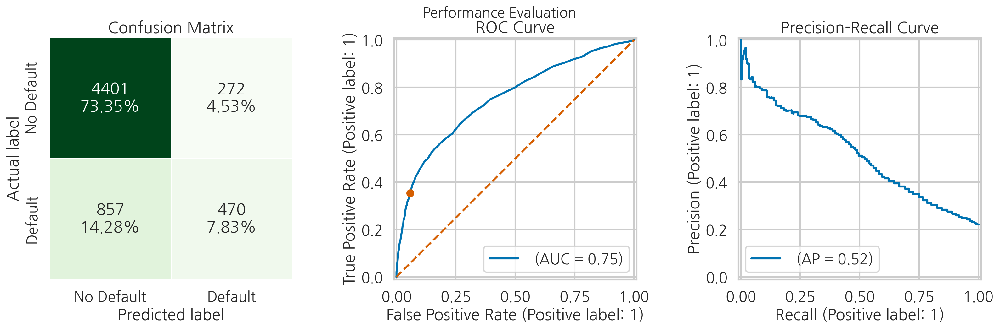

In [16]:
# 신용카드 연체 데이터 불러오기
df = pd.read_csv("./datasets/credit_card_default.csv", na_values="")

# 특성(X)과 타겟(y) 분리
X = df.copy()
y = X.pop("default_payment_next_month")  # 타겟 변수 추출

# 학습/테스트 데이터 분할 (8:2 비율)
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2,  # 테스트 세트 20%
                                                    stratify=y,     # 타겟 비율 유지
                                                    random_state=42)

# 수치형/범주형 특성 구분
num_features = X_train.select_dtypes(include="number").columns.to_list()  # 수치형 컬럼
cat_features = X_train.select_dtypes(include="object").columns.to_list()  # 범주형 컬럼

# 수치형 특성 전처리 파이프라인
num_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median"))  # 결측치를 중앙값으로 대체
])

# 각 범주형 변수의 고유값 목록 생성
cat_list = [list(X_train[col].dropna().unique()) for col in cat_features]

# 범주형 특성 전처리 파이프라인
cat_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),  # 결측치를 최빈값으로 대체
    ("cat_encoding", OneHotEncoder(categories=cat_list, sparse_output=False,  # 원-핫 인코딩 
                             handle_unknown="error", drop="first"))  # 첫 범주 제외
])

# 전체 전처리기 구성
preprocessor = ColumnTransformer(
    transformers=[
        ("numerical", num_pipeline, num_features),    # 수치형 변수 처리
        ("categorical", cat_pipeline, cat_features)   # 범주형 변수 처리
    ], 
    remainder="drop"  # 나머지 컬럼 제외
)

# 랜덤 포레스트 파이프라인 구성
rf_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor),
           ("classifier", RandomForestClassifier(random_state=42))]
)

# 모델 학습
rf_pipeline.fit(X_train, y_train)

# 성능 평가
LABELS = ["No Default", "Default"]  # 클래스 레이블 정의
rf_perf = performance_evaluation_report(rf_pipeline, X_test, 
                                        y_test, labels=LABELS, 
                                        show_plot=True,     # 성능 그래프 표시
                                        show_pr_curve=True) # PR 곡선 표시

In [17]:
rf_perf

{'accuracy': 0.8118333333333333,
 'precision': 0.633423180592992,
 'recall': 0.3541823662396383,
 'specificity': 0.941793280547828,
 'f1_score': 0.4543257612373127,
 'cohens_kappa': 0.35144338792034113,
 'matthews_corr_coeff': 0.3731445361101501,
 'roc_auc': 0.7517763463762952,
 'pr_auc': 0.5247244574365608,
 'average_precision': 0.5207332793563594}

In [18]:
print(f"Recall: {rf_perf['recall']:.4f}")

Recall: 0.3542


### How to do it...

1. Import the libraries:

In [19]:
import category_encoders as ce
from sklearn.base import clone

2. Fit the pipeline using target encoding:

라이브러리를 가져온 후, `clone` 함수를 사용하여 전체 파이프라인을 복제합니다. 그런 다음, `set_params` 메서드를 사용해 `OneHotEncoder`를 `TargetEncoder`로 교체합니다. 파이프라인의 하위 요소에 접근하려면, 파이프라인 하위 요소 이름을 이중 언더스코어로 연결된 형태로 사용해야 합니다. 인코더는 `preprocessor__categorical__cat_encoding` 아래 위치해 있습니다. 그런 다음, `fit` 메서드를 사용해 파이프라인을 적합하고 `performance_evaluation_report` 도우미 함수를 사용해 평가 점수를 출력합니다.

Recall: 0.3670


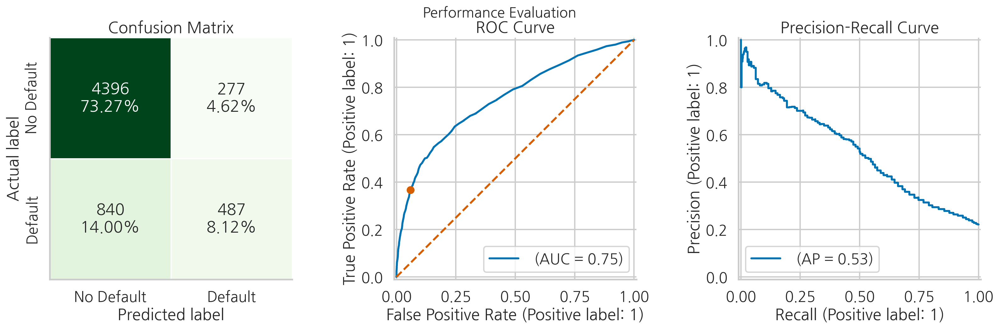

In [20]:
# 기존 파이프라인을 복제하여 새로운 파이프라인 생성
pipeline_target_enc = clone(rf_pipeline)

# 타겟 인코딩을 사용하도록 파이프라인 파라미터 설정
# 타겟 인코딩: 범주형 변수를 타겟 변수(디폴트 여부)의 평균값으로 변환
pipeline_target_enc.set_params(
    preprocessor__categorical__cat_encoding=ce.TargetEncoder()
)

# 학습 데이터로 파이프라인 학습
pipeline_target_enc.fit(X_train, y_train)

# 테스트 데이터로 성능 평가 및 시각화
target_enc_perf = performance_evaluation_report(
    pipeline_target_enc, X_test, 
    y_test, labels=LABELS, 
    show_plot=True,     # ROC 곡선 등 성능 그래프 표시 
    show_pr_curve=True  # Precision-Recall 곡선 표시
)

# 재현율(Recall) 출력 - 실제 디폴트 건수 중 예측 성공한 비율
print(f"Recall: {target_enc_perf['recall']:.4f}")

# 그래프에서 불필요한 테두리 제거
sns.despine()
# plt.savefig("images/figure_14_10", dpi=200)

서론에서 언급한 것처럼, 타겟 인코딩은 과적합에 취약합니다. 이 때문에 알고리즘이 사후 확률을 우선 확률(전역 평균)과 혼합할 수 있게 합니다. 우리는 두 가지 하이퍼파라미터, `min_samples_leaf`와 `smoothing`으로 블렌딩을 제어할 수 있습니다.

3. Fit the pipeline using Leave One Out encoding:

3단계와 4단계에서는 타겟 인코딩과 같은 단계를 따르되, 인코더를 `LeaveOneOutEncoder`와 `WOEEncoder`로 각각 교체합니다.

타겟 인코딩과 마찬가지로, 다른 인코더도 인코딩과 변환을 구축하기 위해 타겟을 사용하므로 과적합에 취약합니다. 다행히도 과적합을 방지하는 몇 가지 방안을 제공합니다.

LOOE의 경우, 인코딩에 정규 분포 노이즈를 추가하여 과적합을 줄일 수 있습니다. `sigma` 인자를 사용해 노이즈의 표준 편차를 제어할 수 있습니다. 무작위 노이즈는 훈련 데이터에만 추가되며 테스트 세트의 변환에는 영향을 주지 않습니다. 파이프라인에 무작위 노이즈를 추가하기만 해도 (`sigma = 0.05`), 리콜 점수가 0.1462에서 약 0.35로 향상됩니다(난수에 따라 다름).

Recall: 0.1462


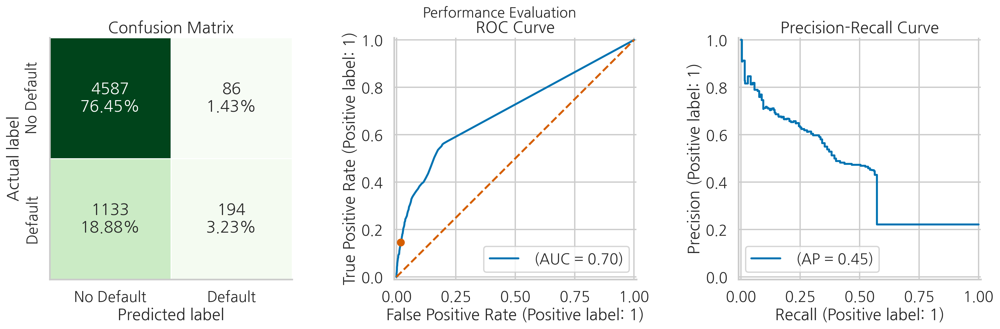

In [21]:
# 기존 파이프라인을 복제하여 Leave-One-Out 인코딩을 적용할 새로운 파이프라인 생성
pipeline_loo_enc = clone(rf_pipeline)

# Leave-One-Out 인코더를 사용하도록 파이프라인 설정
# Leave-One-Out 인코딩: 각 데이터 포인트를 인코딩할 때 해당 포인트를 제외한 나머지로 평균 계산
pipeline_loo_enc.set_params(
    preprocessor__categorical__cat_encoding=ce.LeaveOneOutEncoder()
)

# 학습 데이터로 파이프라인 학습
pipeline_loo_enc.fit(X_train, y_train)

# 테스트 데이터로 성능 평가 및 시각화
# ROC 곡선과 Precision-Recall 곡선을 함께 표시
loo_enc_perf = performance_evaluation_report(
    pipeline_loo_enc, X_test, 
    y_test, labels=LABELS, 
    show_plot=True,     # ROC 곡선 표시
    show_pr_curve=True  # Precision-Recall 곡선 표시
)

# 재현율(Recall) 출력 - 실제 디폴트 건수 중 예측 성공한 비율
print(f"Recall: {loo_enc_perf['recall']:.4f}")

# 그래프에서 불필요한 테두리 제거
sns.despine()
# plt.savefig("images/figure_14_11", dpi=200)

In [ ]:
# 무작위 노이즈를 추가하여 성능 개선이 가능한지 테스트
# sigma 파라미터로 노이즈의 표준편차를 0.05로 설정하고 재현성을 위해 random_state=42 지정

# 기존 파이프라인 복제
pipeline_loo_enc = clone(rf_pipeline)

# Leave-One-Out 인코더에 무작위 노이즈 추가 설정
pipeline_loo_enc.set_params(
    preprocessor__categorical__cat_encoding=ce.LeaveOneOutEncoder(sigma=0.05, random_state=42)
)

# 학습 데이터로 파이프라인 학습
pipeline_loo_enc.fit(X_train, y_train)

# 테스트 데이터로 성능 평가 및 시각화
# ROC 곡선과 Precision-Recall 곡선을 함께 표시
loo_enc_perf = performance_evaluation_report(
    pipeline_loo_enc, X_test, 
    y_test, labels=LABELS, 
    show_plot=True,     # ROC 곡선 표시
    show_pr_curve=True  # Precision-Recall 곡선 표시
)

# 재현율(Recall) 출력 - 실제 디폴트 건수 중 예측 성공한 비율
print(f"Recall: {loo_enc_perf['recall']:.4f}")

# 그래프에서 불필요한 테두리 제거
sns.despine()

4. Fit the pipeline using Weight of Evidence encoding:

마찬가지로, WoE 인코더에도 무작위 노이즈를 추가할 수 있습니다. `randomized`(부울 플래그)와 `sigma`(정규 분포의 표준 편차) 인자로 노이즈를 제어합니다. 추가로, `regularization` 인자가 있어 0으로 나눌 때 발생하는 오류를 방지합니다.

Recall: 0.3708


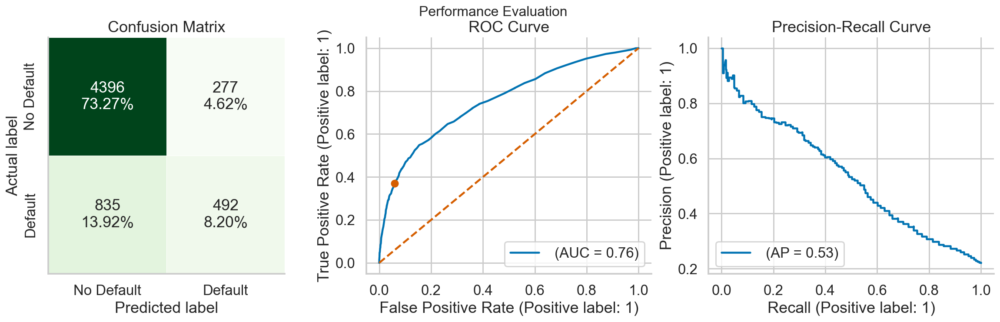

In [10]:
pipeline_woe_enc = clone(rf_pipeline)
pipeline_woe_enc.set_params(
    preprocessor__categorical__cat_encoding=ce.WOEEncoder()
)

pipeline_woe_enc.fit(X_train, y_train)
woe_enc_perf = performance_evaluation_report(
    pipeline_woe_enc, X_test, 
    y_test, labels=LABELS, 
    show_plot=True, 
    show_pr_curve=True
)
print(f"Recall: {woe_enc_perf['recall']:.4f}")

sns.despine()
# plt.savefig("images/figure_14_12", dpi=200)

### There's more

범주형 변수를 인코딩하는 것은 활발히 연구되고 있는 매우 넓은 분야로, 새로운 접근 방식이 지속해서 발표되고 있습니다. 주제를 변경하기 전에 관련 개념 몇 가지를 다루어 보겠습니다.

Experimenting with different values of `min_samples_leaf` and `smoothing` for target encoding:

In [ ]:
for smoothing in [0, 1, 2, 5, 10]:
    for min_smpl_leaf in [1, 5]:

        pipeline_target_enc = clone(rf_pipeline)
        pipeline_target_enc.set_params(
            preprocessor__categorical__cat_encoding=ce.TargetEncoder(min_samples_leaf=min_smpl_leaf,
                                                                     smoothing=smoothing)
        )

        pipeline_target_enc.fit(X_train, y_train)
        target_enc_perf = performance_evaluation_report(pipeline_target_enc, X_test, 
                                                        y_test, labels=LABELS, 
                                                        show_plot=False, 
                                                        show_pr_curve=False)
        print(f"Smoothing <{smoothing}> Min Samples Leaf <{min_smpl_leaf}> --- Recall: {target_enc_perf['recall']:.4f}")

### Bonus: small examples

Below you can find some self-contained examples which show how the encoding algorithms work.
For your convenience, they are the same as the ones shown as examples in the book.

In [ ]:
import category_encoders as ce
import pandas as pd

**Target encoding**

In [ ]:
# binary target
df = pd.DataFrame({
   "category":["a", "a", "b", "b", "b"], 
   "target":[1,0,1,1,0]})

X = df.drop("target", axis = 1)
y = df.drop("category", axis = 1)

encoder = ce.TargetEncoder(smoothing=0)
encoder.fit_transform(X, y["target"])

In [ ]:
# continuous target
df = pd.DataFrame({
   "category":["a", "a", "b", "b", "b"], 
   "target":[5,3,1,3,6]})

X = df.drop("target", axis = 1)
y = df.drop("category", axis = 1)

encoder = ce.TargetEncoder(smoothing=0)
encoder.fit_transform(X, y["target"])

**Leave One Out encoding**

In [ ]:
df = pd.DataFrame({
   "category":["a", "a", "b", "b", "b"], 
   "target":[1,0,1,1,0]})

X = df.drop("target", axis = 1)
y = df.drop("category", axis = 1)

encoder = ce.LeaveOneOutEncoder()
encoder.fit_transform(X, y["target"])

**Weight of Evidence encoding**

In [ ]:
df = pd.DataFrame({
   "category":["a", "a", "b", "b", "b"], 
   "target":[1,0,1,1,0]})

X = df.drop("target", axis = 1)
y = df.drop("category", axis = 1)

encoder = ce.WOEEncoder(regularization=0)
encoder.fit_transform(X, y["target"])

**Binary encoding**

In [ ]:
import numpy as np

df = pd.DataFrame({
   "category":[str(x) for x in np.random.normal(size=100)]
})

encoder = ce.BinaryEncoder()
encoder.fit_transform(df).shape

**k-폴드 타겟 인코딩을 통한 데이터 누수 방지**

이미 언급했듯이, 타겟 인코더의 과적합 문제를 줄이는 몇 가지 접근 방식을 소개했습니다. Kaggle 사용자들 사이에서 매우 인기 있는 해결책 중 하나는 **k-폴드 타겟 인코딩**을 사용하는 것입니다. 이 아이디어는 k-폴드 교차 검증과 유사하며, 모든 훈련 데이터를 사용할 수 있게 해줍니다. 데이터를 k개의 폴드로 나눈 후(계층화할 수도 있고 무작위로 나눌 수도 있음), 각 폴드의 관측값을 해당 폴드를 제외한 나머지 폴드를 사용해 타겟의 평균으로 대체합니다. 이렇게 하면 같은 폴드 내의 관측값에서 타겟이 누출되지 않도록 할 수 있습니다.

> 주의 깊은 독자라면 LOOE가 훈련 데이터셋 내 관측값의 수와 동일한 k를 사용하는 k-폴드 타겟 인코딩의 특수한 경우라는 점을 알아챘을 것입니다.

**더 많은 인코더들**
`category_encoders` 라이브러리는 범주형 특징을 위한 거의 20개의 다른 인코딩 변환기를 제공합니다. 이미 언급한 것 외에도 다음과 같은 것들을 탐색해 볼 수 있습니다.

- **순서형 인코딩**: 라벨 인코딩과 매우 유사하지만, 인코딩이 특징의 순서적 성질을 유지하도록 합니다. 예를 들어, bad < neutral < good의 계층 구조를 유지합니다.
- **카운트 인코더 (빈도 인코더)**: 특징의 각 범주는 해당 범주에 속하는 관측값의 수에 매핑됩니다.
- **합 인코더**: 특정 범주의 타겟 평균과 타겟의 전체 평균을 비교합니다.
- **헬멧 인코더**: 특정 범주의 평균을 이후 수준들의 평균과 비교합니다. 예를 들어 범주가 [A, B, C]인 경우, A를 B와 C의 평균과 비교하고, 그 후 B를 C와 단독으로 비교합니다. 범주형 특징의 수준이 예를 들어 낮음에서 높음으로 순서화된 경우 유용한 방식입니다.
- **역차이 인코더**: 헬멧 인코더와 유사하지만, 현재 범주의 평균을 이전 범주의 평균과 비교합니다.
- **M-추정 인코더**: 타겟 인코더의 단순화된 버전으로, 단일 조율 매개변수(정규화 강도에 해당)를 가집니다.
- **제임스-스테인 인코더**: 특정 범주의 평균을 중앙/전체 평균으로 수렴시키는 방식으로 평균 추정을 개선하는 인코딩의 변형입니다. 조율 매개변수 값이 클수록 전역 평균의 비중이 커지고, 작을수록 과적합 위험이 증가할 수 있습니다. 최적 값은 일반적으로 교차 검증을 통해 결정됩니다. 단점은 이 방식이 정규 분포에만 정의된다는 점인데, 이는 대부분의 이진 분류 문제에 적합하지 않습니다.
- **이진 인코더**: 범주를 이진 숫자로 변환하고 각 이진 자리수에 대해 별도의 열을 제공합니다. 예를 들어, 100개의 고유 범주가 있는 범주형 특징의 경우, 이진 인코딩은 OHE에서 필요한 100개의 열 대신 7개의 열만 필요합니다.
- **해싱 인코더**: 해싱 함수(데이터 암호화에 자주 사용)를 이용해 범주형 특징을 변환합니다. 결과는 OHE와 유사하지만 더 적은 특징을 사용합니다(인코더의 하이퍼파라미터로 제어 가능). 이 방법의 주요 단점은 정보 손실이 발생할 수 있다는 점입니다. 또한 해싱 값이 겹칠 수 있으며, 이로 인해 많은 범주가 같은 해싱 값으로 인코딩될 위험이 있습니다.
- **캣부스트 인코더**: LOOE의 개선된 버전으로, 타겟 누수 문제를 해결하려고 합니다.

### See also
- Micci-Barreca, D. 2001. “분류 및 예측 문제에서 고차원 범주형 속성에 대한 전처리 방식.” ACM SIGKDD 탐색 뉴스레터 3(1): 27–32.

## 14.3 불균형 데이터 처리를 위한 다양한 접근법 조사

분류 작업에서 매우 일반적인 문제 중 하나는 **클래스 불균형**입니다. 이는 한 클래스가 다른 클래스에 비해 현저히 적은 경우에 발생합니다. 일반적으로 두 클래스의 비율이 1:1이 아닐 때 불균형 데이터로 간주합니다. 경우에 따라 미묘한 불균형은 큰 문제가 되지 않지만, 100:1, 1000:1 또는 그 이상의 비율로 불균형이 심한 문제도 존재합니다.

불균형 데이터 문제는 머신러닝 모델의 성능 저하로 이어질 수 있습니다. 대부분의 알고리즘은 암묵적으로 클래스 분포가 균형 잡혔다고 가정하며, 이를 통해 전체 예측 오류를 최소화하려고 합니다. 따라서, 불균형 데이터에서 모델은 소수 클래스의 기여도를 무시하게 되며, 결과적으로 예측된 불균형 데이터에서 편향된 결과를 생성할 가능성이 큽니다.

클래스 불균형 문제를 해결하는 일반적인 방법 중 하나는 **데이터 리샘플링**입니다. 크게 소수 클래스의 오버샘플링 또는 다수 클래스의 언더샘플링을 수행하거나 두 가지 접근법을 혼합하는 방식입니다. 리샘플링 기법에는 여러 가지가 있으며, 몇 가지 주요 방법을 설명합니다.

>리샘플링 기법을 사용할 때는 훈련 데이터만 리샘플링합니다! 테스트 데이터는 그대로 유지됩니다.

<img src="image/fig_14_13.png" width="800">

그림 14.13: 다수 클래스의 언더샘플링과 소수 클래스의 오버샘플링

가장 단순한 언더샘플링 방법은 **랜덤 언더샘플링** 입니다. 이 방법에서는 다수 클래스를 무작위로 샘플링(중복 없이)하여, 클래스 비율을 1:1 또는 다른 원하는 비율로 맞춥니다. 이 방법의 가장 큰 단점은 데이터의 상당 부분이 손실되어 학습 데이터의 정보 손실이 발생한다는 것입니다. 이로 인해, 언더샘플링된 데이터로 학습된 모델의 성능은 낮아질 수 있습니다.

유사하게, 가장 단순한 오버샘플링 방법은 **랜덤 오버샘플링** 입니다. 이 방법에서는 소수 클래스를 여러 번 샘플링하여, 원하는 비율이 달성될 때까지 중복된 샘플을 추가합니다. 그러나 랜덤 오버샘플링은 과적합을 초래할 수 있습니다.

**SMOTE (Synthetic Minority Oversampling Technique)** 는 소수 클래스에서 새로운 합성 샘플을 생성하여 과적합 문제를 해결하는 보다 진보된 오버샘플링 알고리즘입니다. SMOTE는 소수 클래스의 각 샘플에서 k-최근접 이웃(k-NN)을 찾아 이들 사이의 연결을 통해 새로운 샘플을 생성합니다.

하지만, SMOTE는 고차원 데이터에서 효과적이지 않으며, 연속적인 특성에서만 잘 작동합니다. SMOTE의 확장 버전은 범주형 특성도 처리할 수 있습니다.

마지막 오버샘플링 기법은 **ADASYN (Adaptive Synthetic Sampling)** 입니다. 이는 SMOTE의 변형으로, 소수 클래스의 각 샘플에 대해 생성할 샘플 수를 데이터 분포에 따라 결정합니다. 예를 들어, 다수의 유사한 다수 클래스 관측값 사이에 있는 소수 클래스 관측값을 생성하기 쉬운 형태로 만듭니다. 

ADASYN의 두 가지 추가 사항은 다음과 같습니다:

- SMOTE와 달리, 합성 포인트가 세 점 이상의 평면에서 생성될 수 있습니다.
- 합성된 샘플에 약간의 무작위 노이즈를 추가하여 현실성을 높입니다.

ADASYN은 특정한 경우 과적합을 일으킬 수 있습니다.

이 레시피에서는 신용카드 사기 데이터셋 예시를 다루며, 소수 클래스가 전체 샘플의 0.17%로 나타나 매우 심한 불균형 문제를 해결하기 위한 방안을 설명합니다.

### Getting Ready

코딩 부분으로 진행하기 전에, 이 연습을 위해 선택한 데이터셋에 대한 간단한 설명을 제공합니다. 데이터셋은 Kaggle에서 다운로드할 수 있습니다(자세한 내용은 **See also** 섹션 참조).

이 데이터셋은 2013년 9월 유럽 카드 사용자들이 이틀 동안 진행한 신용카드 거래에 관한 정보를 포함하고 있습니다. 기밀 유지로 인해, 거의 모든 특징(30개 중 28개)은 **주성분 분석(PCA)**을 통해 익명화되었습니다. 명확히 해석할 수 있는 두 가지 특징은 **Time**(데이터셋의 첫 거래 이후 각 거래까지 경과한 초)과 **Amount**(거래 금액)입니다.

마지막으로, 이 데이터셋은 매우 불균형하며, 전체 거래 중 0.173%만이 긍정 클래스로 관찰되었습니다. 정확히는, 총 284,807건의 거래 중 492건이 사기 거래로 식별되었습니다.

### How to do it...

1. Import the libraries:

In [23]:
import pandas as pd
from collections import Counter

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import RobustScaler

from imblearn.over_sampling import RandomOverSampler, SMOTE, ADASYN
from imblearn.under_sampling import RandomUnderSampler
from imblearn.ensemble import BalancedRandomForestClassifier

from chapter_14_utils import performance_evaluation_report

2. Load and prepare data:

라이브러리를 가져온 후, 신용 카드 사기 데이터셋을 CSV 파일에서 로드합니다. 같은 단계에서, `Time` 특성을 제거하고 타겟을 분리한 뒤, 80-20 계층적 학습-테스트 분할을 생성합니다. 불균형 클래스 문제를 다룰 때 계층화를 기억하는 것이 중요합니다.

In [29]:
RANDOM_STATE = 42

df = pd.read_csv("./datasets/creditcard.csv")
X = df.copy().drop(columns=["Time"])
y = X.pop("Class")

X_train, X_test, y_train, y_test = train_test_split(
    X, y, 
    test_size=0.2, 
    stratify=y, 
    random_state=RANDOM_STATE
)

In [30]:
y.value_counts(normalize=True)

Class
0    0.998273
1    0.001727
Name: proportion, dtype: float64

3. Scale the features using `RobustScaler`

이 레시피에서는 불균형 데이터 작업에만 집중하고 있습니다. 따라서 EDA, 특징 엔지니어링 등을 다루지 않았습니다. 모든 특징이 수치형이므로 추가 전처리는 필요하지 않았습니다.

유일한 전처리 단계로 `RobustScaler`를 사용해 모든 특징을 스케일링합니다. 랜덤 포레스트에는 명시적인 특징 스케일링이 필요하지 않지만, 일부 리밸런싱 접근 방식은 k-NN을 사용하므로, 스케일이 중요합니다. 스케일러는 학습 데이터에만 맞춘 후 학습 및 테스트 세트를 변환합니다.

>`RobustScaler`는 데이터의 중앙값(median)과 사분위수(IQR)를 기준으로 스케일링하여, 이상치(outlier)의 영향을 줄이는 스케일링 방법입니다.

In [31]:
robust_scaler = RobustScaler()

X_train = robust_scaler.fit_transform(X_train)
X_test = robust_scaler.transform(X_test)

4. Train the baseline model:

4단계에서는 기본 랜덤 포레스트 모델을 적합하여 더 복잡한 접근 방식의 기준으로 사용합니다.

In [32]:
rf = RandomForestClassifier(
    random_state=RANDOM_STATE, n_jobs=-1
)
rf.fit(X_train, y_train)

RandomForestClassifier(n_jobs=-1, random_state=42)

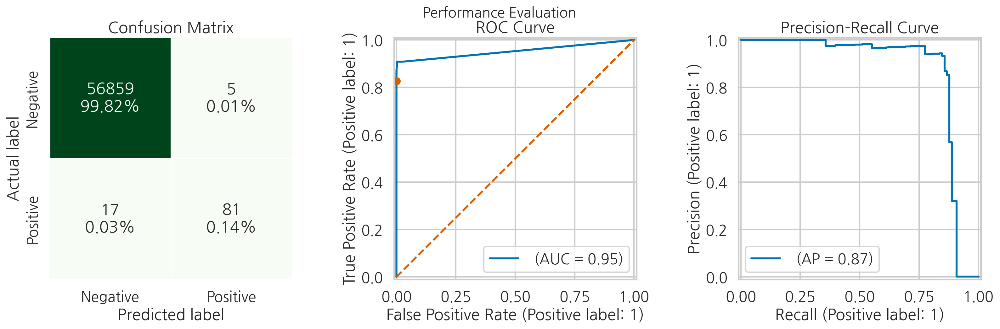

In [33]:
rf_perf = performance_evaluation_report(rf, X_test, y_test, 
                                        show_plot=True, 
                                        show_pr_curve=True)

In [34]:
rf_perf

{'accuracy': 0.9996137776061234,
 'precision': 0.9418604651162791,
 'recall': 0.826530612244898,
 'specificity': 0.9999120709060214,
 'f1_score': 0.8804347826086957,
 'cohens_kappa': 0.8802421830263933,
 'matthews_corr_coeff': 0.8821262209352536,
 'roc_auc': 0.9528106983508091,
 'pr_auc': 0.8761066379655765,
 'average_precision': 0.8715308673031336}

5. Undersample the training data and train a Random Forest Classifier:

5단계에서는 `imblearn` 라이브러리의 `RandomUnderSampler` 클래스를 사용하여 소수 샘플의 크기에 맞게 다수 클래스의 크기를 무작위로 다운샘플링합니다. 편리하게도, `imblearn`의 클래스들은 `scikit-learn`의 API 스타일을 따릅니다. 그래서 먼저 클래스를 정의한 후(여기서는 `random_state`만 설정), `fit_resample` 메서드를 적용해 다운샘플링된 데이터를 얻습니다. 모델을 학습시키기 위해 랜덤 포레스트 객체를 재사용하고, 나중에 비교할 결과를 저장합니다.

The new class proportions are: {0: 394, 1: 394}


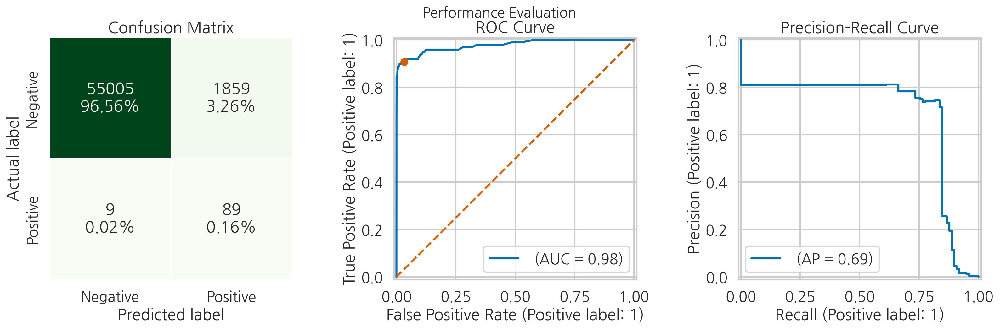

In [35]:
# RandomUnderSampler를 사용하여 다수 클래스를 소수 클래스 수준으로 다운샘플링
rus = RandomUnderSampler(random_state=RANDOM_STATE)

# fit_resample을 호출하여 다운샘플링된 데이터셋 생성
# X_rus: 다운샘플링된 특징 데이터
# y_rus: 다운샘플링된 레이블 데이터  
X_rus, y_rus = rus.fit_resample(X_train, y_train)

# 다운샘플링 후 각 클래스의 샘플 수 출력
print(f"The new class proportions are: {dict(Counter(y_rus))}")

# 다운샘플링된 데이터로 랜덤 포레스트 모델 학습
rf.fit(X_rus, y_rus)

# 테스트 세트에 대한 성능 평가 수행 및 시각화
# show_plot=True: ROC 커브 등 성능 그래프 표시
# show_pr_curve=True: 정밀도-재현율 커브 표시
rf_rus_perf = performance_evaluation_report(rf, X_test, y_test, 
                                            show_plot=True, 
                                            show_pr_curve=True)

In [36]:
rf_rus_perf

{'accuracy': 0.9672062076472034,
 'precision': 0.04568788501026694,
 'recall': 0.9081632653061225,
 'specificity': 0.9673079628587508,
 'f1_score': 0.08699902248289346,
 'cohens_kappa': 0.08399812937820073,
 'matthews_corr_coeff': 0.1996376876508488,
 'roc_auc': 0.9779785173073169,
 'pr_auc': 0.7493412931297654,
 'average_precision': 0.6893877685200549}

6. Oversample the training data and train a Random Forest Classifier:

6단계는 5단계와 유사하며, 유일한 차이는 다수 클래스 크기에 맞게 소수 클래스를 무작위로 오버샘플링하는 `RandomOverSampler`를 사용한다는 점입니다.

The new class proportions are: {0: 227451, 1: 227451}


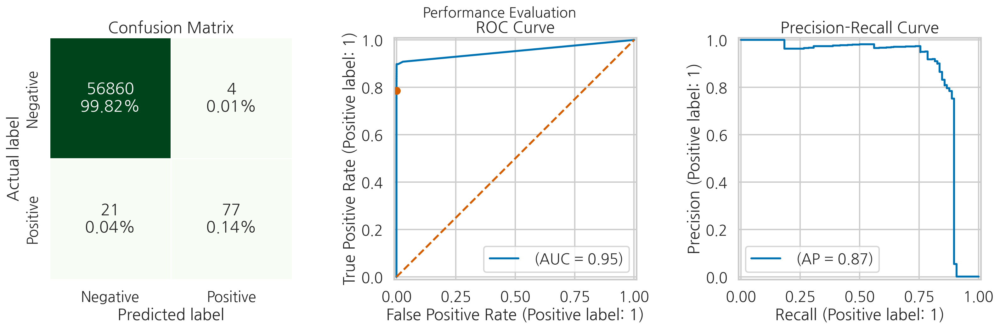

In [37]:
# RandomOverSampler를 사용하여 소수 클래스를 다수 클래스 수준으로 오버샘플링
ros = RandomOverSampler(random_state=RANDOM_STATE)

# fit_resample을 호출하여 오버샘플링된 데이터셋 생성
# X_ros: 오버샘플링된 특징 데이터 
# y_ros: 오버샘플링된 레이블 데이터
X_ros, y_ros = ros.fit_resample(X_train, y_train)

# 오버샘플링 후 각 클래스의 샘플 수 출력
print(f"The new class proportions are: {dict(Counter(y_ros))}")

# 오버샘플링된 데이터로 랜덤 포레스트 모델 학습
rf.fit(X_ros, y_ros)

# 테스트 세트에 대한 성능 평가 수행 및 시각화
# show_plot=True: ROC 커브 등 성능 그래프 표시
# show_pr_curve=True: 정밀도-재현율 커브 표시
rf_ros_perf = performance_evaluation_report(rf, X_test, y_test, 
                                            show_plot=True, 
                                            show_pr_curve=True)


In [38]:
rf_ros_perf

{'accuracy': 0.9995611109160493,
 'precision': 0.9506172839506173,
 'recall': 0.7857142857142857,
 'specificity': 0.9999296567248172,
 'f1_score': 0.8603351955307262,
 'cohens_kappa': 0.8601173911787858,
 'matthews_corr_coeff': 0.8640351019464072,
 'roc_auc': 0.9526220096930161,
 'pr_auc': 0.8694354919814588,
 'average_precision': 0.8650269303457705}

7. Oversample the training data using SMOTE:

7단계와 8단계에서는 SMOTE와 ADASYN 오버샘플링 방법을 적용합니다. `imblearn` 라이브러리를 사용하면 다양한 샘플링 방법을 쉽게 적용할 수 있으므로, 여기서는 과정에 대한 자세한 설명은 생략합니다.

> 모든 언급된 리샘플링 방법에서, `sampling_strategy` 인자에 float 값을 전달하여 클래스 간 원하는 비율을 지정할 수 있습니다. 이 숫자는 다수 클래스 관측값에 대한 소수 클래스 관측값의 비율을 나타냅니다.

The new class proportions are: {0: 227451, 1: 227451}


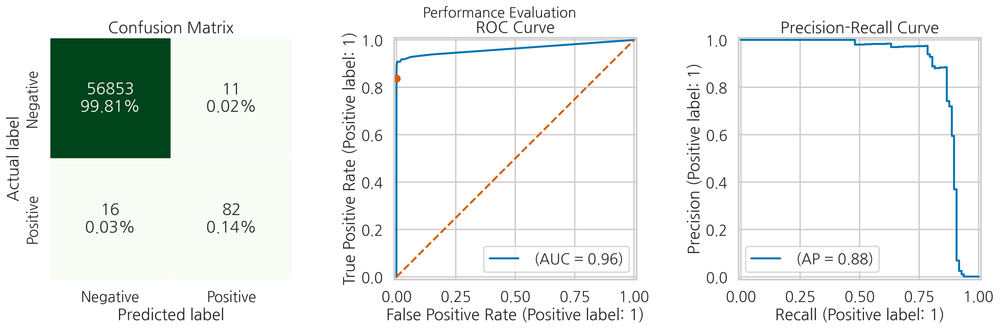

In [39]:
smote = SMOTE(random_state=RANDOM_STATE)
X_smote, y_smote = smote.fit_resample(X_train, y_train)
print(f"The new class proportions are: {dict(Counter(y_smote))}")

rf.fit(X_smote, y_smote)
rf_smote_perf = performance_evaluation_report(
    rf, X_test, y_test, 
    show_plot=True, 
    show_pr_curve=True
)


In [40]:
rf_smote_perf

{'accuracy': 0.9995259997893332,
 'precision': 0.8817204301075269,
 'recall': 0.8367346938775511,
 'specificity': 0.9998065559932471,
 'f1_score': 0.8586387434554974,
 'cohens_kappa': 0.8584015082980144,
 'matthews_corr_coeff': 0.8586967748445028,
 'roc_auc': 0.9630224962100766,
 'pr_auc': 0.8791097391338298,
 'average_precision': 0.877909842029142}

8. Oversample the training data using ADASYN:

The new class proportions are: {0: 227451, 1: 227449}


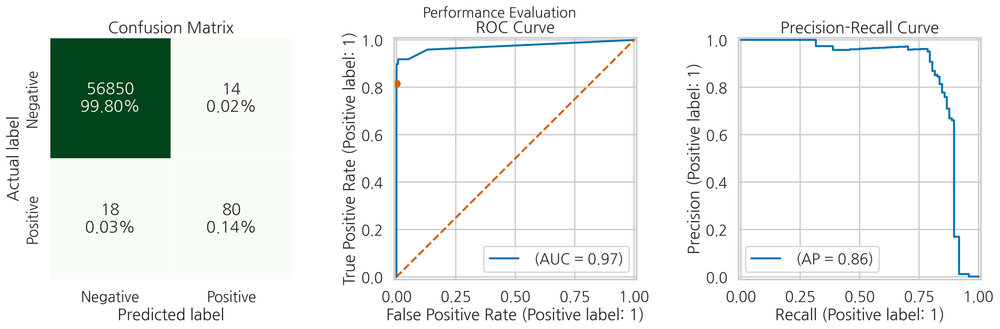

In [41]:
adasyn = ADASYN(random_state=RANDOM_STATE)
X_adasyn, y_adasyn = adasyn.fit_resample(X_train, y_train)
print(f"The new class proportions are: {dict(Counter(y_adasyn))}")

rf.fit(X_adasyn, y_adasyn)
rf_adasyn_perf = performance_evaluation_report(
    rf, X_test, y_test, 
    show_plot=True, 
    show_pr_curve=True
)

In [42]:
rf_adasyn_perf

{'accuracy': 0.9994382219725431,
 'precision': 0.851063829787234,
 'recall': 0.8163265306122449,
 'specificity': 0.9997537985368599,
 'f1_score': 0.8333333333333334,
 'cohens_kappa': 0.8330520924541228,
 'matthews_corr_coeff': 0.83323354623757,
 'roc_auc': 0.9730570900279076,
 'pr_auc': 0.8661090014090018,
 'average_precision': 0.8634501529350331}

9. Use sample weights in the Random Forest Classifier:

9단계에서는 학습 데이터를 리샘플링하는 대신, `RandomForestClassifier`의 `class_weight` 하이퍼파라미터를 사용해 클래스 불균형을 고려합니다. `balanced`로 설정하면, 알고리즘이 훈련 데이터의 클래스 빈도에 비례하여 반비례하는 가중치를 자동으로 할당합니다.

> `class_weight` 하이퍼파라미터를 사용하는 여러 접근 방식이 있습니다. `balanced_subsample`을 전달하면 `balanced`와 유사한 가중치 할당이 이루어지지만, 각 트리마다 부트스트랩 샘플을 기준으로 가중치가 계산됩니다. 또는 `sklearn.utils.class_weight`의 `compute_class_weight` 함수를 사용해 원하는 가중치를 포함하는 딕셔너리를 전달할 수도 있습니다.

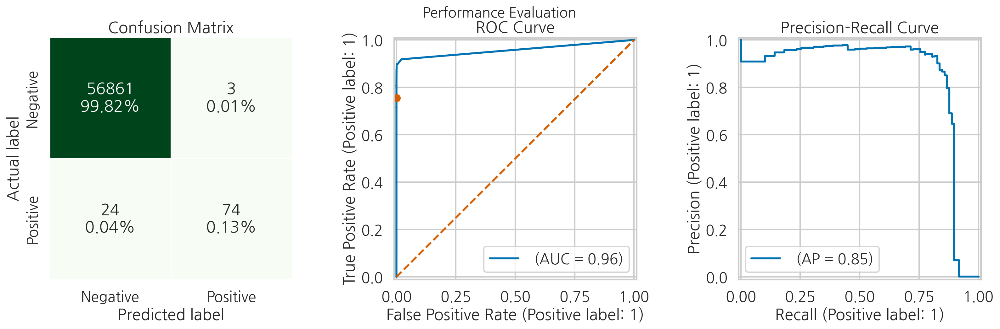

In [43]:
rf_cw = RandomForestClassifier(random_state=RANDOM_STATE, 
                               class_weight="balanced",
                               n_jobs=-1)
rf_cw.fit(X_train, y_train)

rf_cw_perf = performance_evaluation_report(
    rf_cw, X_test, y_test, 
    show_plot=True, 
    show_pr_curve=True
)

In [44]:
rf_cw_perf

{'accuracy': 0.9995259997893332,
 'precision': 0.961038961038961,
 'recall': 0.7551020408163265,
 'specificity': 0.9999472425436128,
 'f1_score': 0.8457142857142858,
 'cohens_kappa': 0.8454803442249764,
 'matthews_corr_coeff': 0.8516532279164988,
 'roc_auc': 0.9580099995119038,
 'pr_auc': 0.8571566165109122,
 'average_precision': 0.8482798270370951}

10. Train the `BalancedRandomForestClassifier`:

`imblearn` 라이브러리에는 인기 있는 분류기의 수정된 버전도 포함되어 있습니다. 10단계와 11단계에서는 균형 잡힌 랜덤 포레스트인 수정된 랜덤 포레스트 분류기를 사용합니다. 차이점은 균형 잡힌 랜덤 포레스트에서 부트스트랩 샘플을 통해 클래스를 무작위로 다운샘플링하여 균형을 맞춘다는 것입니다. 실제로는 `scikit-learn`의 기본 구현과 거의 동일하며(조정 가능한 하이퍼파라미터 포함), 마지막 단계에서는 모든 결과를 하나의 데이터프레임으로 결합하고 결과를 표시합니다.

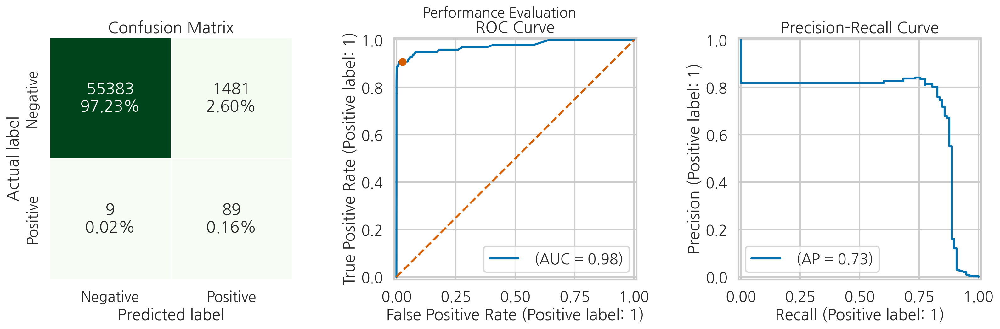

In [45]:
balanced_rf = BalancedRandomForestClassifier(
    random_state=RANDOM_STATE
)

balanced_rf.fit(X_train, y_train)
balanced_rf_perf = performance_evaluation_report(
    balanced_rf, X_test, y_test, 
    show_plot=True, 
    show_pr_curve=True
)

11. Train the `BalancedRandomForestClassifier` with balanced classes:

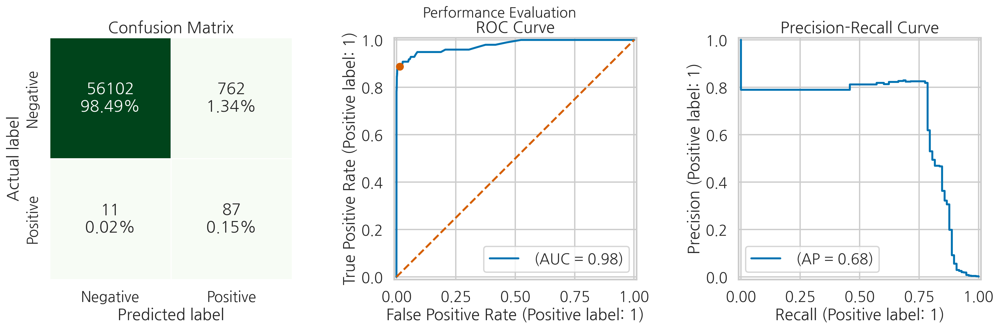

In [46]:
balanced_rf_cw = BalancedRandomForestClassifier(
    random_state=RANDOM_STATE, 
    class_weight="balanced",
    n_jobs=-1
)

balanced_rf_cw.fit(X_train, y_train)
balanced_rf_cw_perf = performance_evaluation_report(
    balanced_rf_cw, X_test, y_test, 
    show_plot=True, 
    show_pr_curve=True
)

12. Combine the results in a DataFrame:

In [47]:
performance_results = {
    "random_forest": rf_perf,
    "undersampled rf": rf_rus_perf,
    "oversampled_rf": rf_ros_perf,
    "smote": rf_smote_perf,
    "adasyn": rf_adasyn_perf,
    "random_forest_cw": rf_cw_perf,
    "balanced_random_forest": balanced_rf_perf,
    "balanced_random_forest_cw": balanced_rf_cw_perf,
}                       
pd.DataFrame(performance_results).round(4).T

,accuracy,precision,recall,specificity,f1_score,cohens_kappa,matthews_corr_coeff,roc_auc,pr_auc,average_precision
random_forest,0.9996,0.9419,0.8265,0.9999,0.8804,0.8802,0.8821,0.9528,0.8761,0.8715
undersampled rf,0.9672,0.0457,0.9082,0.9673,0.0870,0.0840,0.1996,0.9780,0.7493,0.6894
oversampled_rf,0.9996,0.9506,0.7857,0.9999,0.8603,0.8601,0.8640,0.9526,0.8694,0.8650
smote,0.9995,0.8817,0.8367,0.9998,0.8586,0.8584,0.8587,0.9630,0.8791,0.8779
adasyn,0.9994,0.8511,0.8163,0.9998,0.8333,0.8331,0.8332,0.9731,0.8661,0.8635
random_forest_cw,0.9995,0.9610,0.7551,0.9999,0.8457,0.8455,0.8517,0.9580,0.8572,0.8483
balanced_random_forest,0.9738,0.0567,0.9082,0.9740,0.1067,0.1038,0.2233,0.9761,0.7800,0.7253
balanced_random_forest_cw,0.9864,0.1025,0.8878,0.9866,0.1837,0.1812,0.2990,0.9780,0.7240,0.6759


### There’s more...

이 레시피에서는 사용 가능한 리샘플링 방법 중 일부만을 소개했습니다. 아래는 몇 가지 추가적인 방법들입니다.

**언더샘플링**
- **NearMiss** - 근접 이웃 알고리즘을 기반으로 하는 일종의 휴리스틱 규칙에 따른 언더샘플링 방법 모음입니다. 다수 클래스 관측값을 선택할 때 소수 클래스와의 거리 기준으로 선택하여 클래스 간 거리를 유지합니다. 예를 들어, NearMiss-1 방법은 다수 클래스에서 가장 가까운 세 개의 소수 클래스 관측값에 대한 평균 거리가 가장 작은 관측값들을 선택합니다.
- **Edited Nearest Neighbors** - 가까운 이웃 중 두 개 이상의 관측값이 다른 클래스로 분류되는 다수 클래스 관측값을 제거하는 방법입니다. 이는 클래스 경계에 가까운 다수 클래스 관측값을 제거해 분리도를 높이려는 목적이 있습니다.
- **Tomek Links** - 모든 관측값을 쌍으로 묶어 가장 가까운 이웃을 찾고, 서로 다른 클래스에 속하는 쌍을 Tomek 링크로 정의하여 다수 클래스에 속하는 관측값을 제거함으로써 클래스 간 분리도를 증가시킵니다.

**오버샘플링**
- **SMOTE-NC (Synthetic Minority Oversampling Technique for Nominal and Continuous)** - 숫자형과 범주형 특징을 포함하는 데이터셋에 적합한 SMOTE의 변형입니다. 기존 SMOTE는 원-핫 인코딩된 특징에 비합리적 값을 생성할 수 있는데, 이 방법은 이를 방지합니다.
- **Borderline SMOTE** - 두 클래스 간 결정 경계에 가까운 소수 클래스 관측값을 중심으로 새로운 샘플을 생성하여 잘못 분류될 가능성이 높은 경우에 대응합니다.
- **SVM SMOTE** - SVM 알고리즘을 사용해 새로운 합성 관측값을 생성할 관측값을 지정하는 SMOTE 변형입니다.
- **K-means SMOTE** - 먼저 소수 클래스 관측값 비율이 높은 클러스터를 찾기 위해 K-means 클러스터링을 적용한 후, 각 클러스터에 새로운 합성 관측값을 생성합니다.

대안적으로, 오버샘플링과 언더샘플링을 결합할 수 있습니다. 기본 개념은 중복 또는 인공 관측값을 생성하기 위해 오버샘플링을 먼저 수행한 다음, 불필요하거나 노이즈가 많은 관측값을 줄이기 위해 언더샘플링을 사용하는 것입니다.

예를 들어, SMOTE로 데이터를 오버샘플링한 후 Tomek Links 또는 Edited Nearest Neighbors를 사용해 다시 언더샘플링할 수 있습니다. `imbalanced-learn` 라이브러리에서는 이러한 결합된 리샘플러 두 가지—SMOTE와 Tomek Links, SMOTE와 Edited Nearest Neighbors를 제공합니다.

이 레시피에서는 불균형 클래스 문제를 다룰 때 참고할 몇 가지 일반적인 주의 사항을 간단히 언급하고 있습니다.

- 테스트 세트에 언더샘플링/오버샘플링을 적용하지 않습니다.
- 불균형 데이터 문제를 평가할 때는 정확도 대신 정밀도, 재현율, F1 점수, Cohen의 카파, PR-AUC 등의 지표를 사용합니다.
- 교차 검증을 위한 폴드를 생성할 때 계층화를 사용합니다.
- 교차 검증 중 언더샘플링/오버샘플링을 도입하고, 그 이전에는 하지 않습니다. 그렇지 않으면 모델의 성능을 과대평가하게 됩니다!
- `imbalanced-learn` 라이브러리를 사용해 리샘플링이 포함된 파이프라인을 생성할 때는 `scikit-learn`의 파이프라인에서 요구하는 `fit_transform` 대신 `fit_resample` 메서드를 사용해야 합니다.
- 문제의 프레임을 다르게 고려해 볼 수 있습니다. 예를 들어, 분류 작업 대신 이상치 감지 문제로 다루고, 이를 위해 Isolation Forest와 같은 기술을 사용할 수 있습니다.
- 기본 50%가 아닌 다른 확률 임곗값을 선택하여 잠재적으로 성능을 튜닝할 수도 있습니다.

>결정 임계값은 분류기의 출력인 확률이나 점수가 어느 수준을 넘어설 때 해당 관측치를 양성 클래스로 판단할지를 결정합니다. 기본값은 0.5입니다.

다음은 해당 텍스트의 한국어 번역입니다.

---

### See also

이 레시피에서 사용한 데이터셋은 Kaggle에서 이용할 수 있습니다:  
- [https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud](https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud)

추가 자료는 다음에서 확인할 수 있습니다:

- Chawla, N. V., Bowyer, K. W., Hall, L. O., & Kegelmeyer, W. P. 2002. "SMOTE: 소수 클래스 합성 오버샘플링 기법." *인공지능 연구 저널* 16: 321–357.
- Chawla, N. V. 2009. "불균형 데이터셋을 위한 데이터 마이닝: 개요." *데이터 마이닝 및 지식 발견 핸드북*: 875–886.
- Chen, C., Liaw, A., & Breiman, L. 2004. "랜덤 포레스트를 사용하여 불균형 데이터 학습." *캘리포니아 대학교 버클리* 110: 1–12.
- Elor, Y., & Averbuch-Elor, H. 2022. "SMOTE 할 것인가 말 것인가?" *arXiv 사전 인쇄* arXiv:2201.08528.
- Han, H., Wang, W. Y., & Mao, B. H. 2005, 8월. "불균형 데이터셋 학습을 위한 새로운 오버샘플링 방법 Borderline-SMOTE." *지능형 컴퓨팅 국제 학회*, 878–887. Springer, Berlin, Heidelberg.
- He, H., Bai, Y., Garcia, E. A., & Li, S. 2008, 6월. "ADASYN: 불균형 학습을 위한 적응형 합성 샘플링 접근 방식." *IEEE 신경망 국제 공동 학술대회*, 1322–1328. IEEE.
- Le Borgne, Y-A., Siblini, W., Lebichot, B., & Bontempi, G. 2022. *신용 카드 사기 탐지를 위한 재현 가능한 머신러닝 - 실용 핸드북.*
- Liu, F. T., Ting, K. M., & Zhou, Z. H. 2008, 12월. "Isolation forest." *IEEE 데이터 마이닝 국제 학회*, 413–422. IEEE.
- Mani, I., & Zhang, I. 2003, 8월. "불균형 데이터 분포를 다루기 위한 kNN 접근법: 정보 추출을 포함한 사례 연구." *불균형 데이터셋 학습 워크샵 논문집*, 126: 1–7. ICML.
- Nguyen, H. M., Cooper, E. W., & Kamei, K. 2009, 11월. "불균형 데이터 분류를 위한 Borderline 오버샘플링." *컴퓨팅 지능 응용 프로그램 국제 워크샵 논문집*, 2009(1): 24–29. IEEE SMC 히로시마 지부.
- Pozzolo, A.D. 외. 2015. "불균형 분류를 위한 언더샘플링 확률 조정." *2015 IEEE 컴퓨팅 지능 심포지엄 시리즈.*
- Tomek, I. 1976. "CNN의 두 가지 수정." *IEEE 시스템, 인간 및 사이버네틱스 거래*, 6: 769–772.
- Wilson, D. L. 1972. "편집된 데이터 사용 시 근접 이웃 규칙의 비대칭 속성." *IEEE 시스템, 인간 및 사이버네틱스 거래* 3: 408–421.


## 14.4 스태킹 앙상블에서 집단 지성 활용하기

**스태킹**(stacked generalization)은 서로 이질적인 머신러닝 모델 앙상블을 생성하는 기법을 말합니다. 스태킹 앙상블의 구조는 두 개 이상의 기본 모델(레벨 0 모델)과 기본 모델들의 예측을 결합하는 메타 모델(레벨 1 모델)로 구성됩니다. 아래 그림은 두 개의 기본 모델을 사용한 예를 보여줍니다.

<img src="image/fig_14_15.png" width="800">

Figure 14.15: High-level schema of a stacking ensemble with two base learners

스태킹의 목표는 다양한 성능 좋은 모델을 결합하여, 앙상블 내의 어떤 단일 모델보다 더 나은 예측을 얻는 것입니다. 스태킹 앙상블은 각 모델의 강점을 결합하여 성능을 향상시키려 하므로, 기본 모델은 서로 다르고 복잡한 경우가 많습니다. 예를 들어, 선형 모델, 결정 트리, 다양한 종류의 앙상블, k-최근접 이웃, 서포트 벡터 머신, 신경망 등을 사용할 수 있습니다.

스태킹은 배깅, 부스팅 등의 기존 앙상블 기법보다 이해하기 어려울 수 있습니다. 특히, 스태킹에는 데이터 분할, 과적합 방지, 데이터 누출 방지와 같은 다양한 변형이 존재합니다. 이 레시피에서는 **scikit-learn** 라이브러리에서 사용된 접근 방식을 따릅니다.

스태킹 앙상블을 생성하는 절차는 다음 세 단계로 설명할 수 있습니다. 이미 대표적인 훈련 및 테스트 데이터셋이 있다고 가정합니다.

**단계 1: 레벨 0 모델 훈련**

이 단계의 핵심은 각 레벨 0 모델이 전체 훈련 데이터셋에서 학습한 후, 이 모델들이 예측을 생성하는 것입니다.

여기서 몇 가지 고려사항이 있습니다. 먼저, 예측하고자 하는 예측 유형을 선택해야 합니다. 회귀 문제의 경우, 예측 값은 직접적으로 사용되지만, 분류 문제에서는 예측 클래스나 확률/점수를 사용할 수 있습니다.

둘째, 레벨 1 모델의 특징으로 레벨 0 모델의 예측만을 사용할 수도 있고, 레벨 0 모델의 예측을 원래의 특징 집합과 결합할 수도 있습니다. 실제로는 특징을 결합하는 것이 더 좋은 결과를 보일 때가 많습니다. 이는 주로 사용 사례와 데이터셋에 따라 달라집니다.

**단계 2: 레벨 1 모델 훈련**

레벨 1 모델(메타 모델)은 일반적으로 선형 모델이 사용되며, 레벨 0 모델의 예측을 매끄럽게 해석할 수 있습니다. 이는 이러한 작업에 선형 모델이 자주 선택되는 이유입니다.

>블렌딩이라는 용어는 종종 레벨 1 모델로 단순 선형 모델을 사용하는 것을 의미합니다. 이는 레벨 1 모델의 예측이 레벨 0 모델들이 만든 예측의 가중 평균(또는 블렌딩)이 되기 때문입니다.

이 단계에서 레벨 1 모델은 이전 단계의 특징(예측값만이거나 초기 특징 집합과 결합된 형태)을 사용하여 훈련되며, 일부 교차 검증을 수행합니다. 교차 검증은 메타 모델의 하이퍼파라미터와 앙상블로 사용할 기본 모델 집합을 선택하는 데 사용됩니다.

<img src="image/fig_14_16.png" width="800">

Figure 14.16: Low-level schema of a stacking ensemble with two base learners

scikit-learn의 스태킹 접근 방식에서, 우리는 기본 모델이 과적합하는 경향이 있더라도 상관없다고 가정합니다. 과적합은 알고리즘 자체나 하이퍼파라미터 조합에 의해 발생할 수 있지만, 메타 모델을 튜닝하는 동안에는 기본 모델이 영향을 받지 않습니다.

최적의 하이퍼파라미터와 기본 학습기가 선택된 후, 최종 훈련 데이터셋을 사용해 메타 모델을 훈련합니다.

**단계 3: 미지의 데이터에 대한 예측 수행**

이 단계는 가장 쉬운 단계입니다. 모든 기본 모델을 새 관측값에 적용하여 예측을 얻고, 이를 메타 모델에 전달하여 스태킹 앙상블의 최종 예측을 생성합니다.

이 레시피에서는 신용카드 사기 데이터셋에 대해 스태킹 앙상블을 생성하는 예시를 제공합니다.

### How to do it...

1. Import the libraries:

1단계에서는 필요한 라이브러리를 가져옵니다. 

In [1]:
import pandas as pd
from sklearn.model_selection import (train_test_split,
                                     StratifiedKFold)
from sklearn.metrics import recall_score
from sklearn.preprocessing import RobustScaler

from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import StackingClassifier

2. Load and preprocess data:

그런 다음, 신용카드 사기 데이터셋을 불러와서, 타겟을 특징에서 분리하고, Time 특성을 제거한 후, 데이터를 훈련 및 테스트 세트로 나누고(층화된 분할을 사용), 마지막으로 RobustScaler로 데이터를 스케일링합니다. 이 변환은 트리 기반 모델에서는 필요하지 않지만, 우리는 다양한 가정을 가진 여러 분류기를 기본 모델로 사용합니다. 간단히 하기 위해, 입력 데이터의 다양한 속성을 조사하지 않았습니다. 이러한 전처리 단계에 대한 자세한 내용은 이전 레시피를 참고해 주세요.

>RobustScaler는 이상치(outlier)의 영향을 최소화하면서 특징들을 스케일링하는 방법입니다. 중앙값(median)과 사분위수 범위(IQR: Interquartile Range)를 사용하여 스케일링을 수행합니다.
>```
>X_scaled = (X - median) / IQR
>
>여기서:
>- X는 원본 특징값
>- median은 특징의 중앙값 
>- IQR = Q3 - Q1 (75번째 백분위수 - 25번째 백분위수)
>```


In [3]:
# 난수 생성을 위한 시드값 설정
RANDOM_STATE = 42

# 신용카드 데이터셋 불러오기
df = pd.read_csv("./datasets/creditcard.csv")

# Time 컬럼을 제외한 특성 데이터 복사 
X = df.copy().drop(columns=["Time"])
# 타겟 변수(Class) 분리
y = X.pop("Class")

# 훈련/테스트 데이터 분할 (층화 추출 사용)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, 
    test_size=0.2, # 테스트 세트 20%
    stratify=y, # 타겟 변수의 분포 유지
    random_state=RANDOM_STATE
)

# RobustScaler를 사용한 특성 스케일링
robust_scaler = RobustScaler()
X_train = robust_scaler.fit_transform(X_train)
X_test = robust_scaler.transform(X_test)

3. Define a list of base models:

3단계에서는 스택 앙상블을 위한 몇 가지 기본 학습자를 정의합니다. 우리는 의사 결정 트리, 나이브 베이즈 분류기, 서포트 벡터 분류기, 로지스틱 회귀와 같은 간단한 분류기를 사용하기로 합니다. 간결성을 위해 선택한 분류기의 속성에 대해서는 설명하지 않습니다.

> 기본 학습자 목록을 준비할 때, 파이프라인 전체를 제공할 수도 있습니다. 일부 머신러닝 모델은 특징을 스케일링하거나 범주형 변수를 인코딩하는 등의 전처리가 필요하기 때문에 이 방법이 유용할 수 있습니다.

In [4]:
# 기본 모델 목록 정의
# - 의사결정트리: 트리 기반의 분류 모델
# - 로지스틱 회귀: 선형 분류 모델
# - SVC: 서포트 벡터 머신 분류기
# - 나이브 베이즈: 확률 기반 분류기
base_models = [
    ("dec_tree", DecisionTreeClassifier(random_state=RANDOM_STATE)),
    ("log_reg", LogisticRegression(random_state=RANDOM_STATE)), 
    ("svc", SVC(random_state=RANDOM_STATE)),   
    # ("knn", KNeighborsClassifier()), # KNN은 현재 사용하지 않음
    ("naive_bayes", GaussianNB())
]

4. Train the selected models and calculate recall using the test set:

4단계에서는 분류기 목록을 반복하여 각 모델을 훈련 데이터에 맞추고, 테스트 세트를 사용하여 재현율 점수를 계산합니다. 또한, 추정기에 n_jobs 매개변수가 있다면, 계산을 위해 사용 가능한 모든 코어를 사용할 수 있도록 -1로 설정합니다. 이렇게 하면 머신에 여러 코어/스레드가 있는 경우 모델의 훈련 속도를 높일 수 있습니다. 이 단계의 목표는 개별 기본 모델의 성능을 조사하여 스택 앙상블과 비교하는 것입니다.

In [5]:
# 각 기본 모델에 대해 반복
for model_tuple in base_models:
    # 모델 객체 가져오기 
    clf = model_tuple[1]
    
    # n_jobs 파라미터가 있으면 모든 CPU 코어 사용하도록 설정
    if "n_jobs" in clf.get_params().keys():
        clf.set_params(n_jobs=-1)
        
    # 모델 학습
    clf.fit(X_train, y_train)
    
    # 테스트 세트로 재현율 계산
    recall = recall_score(y_test, clf.predict(X_test))
    
    # 모델명과 재현율 출력
    print(f"{model_tuple[0]}'s recall score: {recall:.4f}")

dec_tree's recall score: 0.7551
log_reg's recall score: 0.6429
svc's recall score: 0.7041
naive_bayes's recall score: 0.8469


5. Define, fit and evaluate the stacked ensemble:

5단계에서는 먼저 메타 모델(로지스틱 회귀)과 5겹 층화된 교차 검증 방식을 정의합니다. 그런 다음, 기본 분류기 목록과 교차 검증 방식 및 메타 모델을 제공하여 StackingClassifier를 인스턴스화합니다. scikit-learn의 스태킹 구현에서 기본 학습자는 전체 훈련 세트를 사용하여 맞춰집니다. 이후 과적합을 방지하고 모델의 일반화 성능을 개선하기 위해, 메타 추정기는 선택된 교차 검증 방식을 사용하여 아웃 샘플에서 모델을 훈련합니다. 정확히 말하면, 이 작업에는 cross_val_predict를 사용합니다.

> 이 접근 방식의 단점 중 하나는 메타 학습자에만 교차 검증을 적용하면 기본 학습자의 과적합이 발생할 수 있다는 점입니다. 다른 라이브러리에서는 스택 앙상블에 대해 다른 교차 검증 방식을 사용합니다.


In [6]:
# 5겹 교차검증을 위한 StratifiedKFold 객체 생성
# n_splits=5: 5개의 폴드로 분할
# shuffle=True: 데이터를 섞음
# random_state: 재현성을 위한 시드값 설정
cv_scheme = StratifiedKFold(n_splits=5, 
                            shuffle=True, 
                            random_state=RANDOM_STATE)

# 메타 모델로 로지스틱 회귀 사용
meta_model = LogisticRegression(random_state=RANDOM_STATE)

# 스태킹 분류기 생성
# base_models: 기본 모델들의 리스트
# final_estimator: 메타 모델
# cv: 교차검증 방식
# n_jobs=-1: 모든 CPU 코어 사용
stack_clf = StackingClassifier(
    base_models, 
    final_estimator=meta_model,
    cv=cv_scheme,
    n_jobs=-1
)

# 학습 데이터로 모델 학습
stack_clf.fit(X_train, y_train)

# 테스트 데이터에 대한 재현율 계산 및 출력
recall = recall_score(y_test, stack_clf.predict(X_test))
print(f"The stacked ensemble's recall score: {recall:.4f}")

The stacked ensemble's recall score: 0.7347


6. Improve the stacking ensemble with additional features and a more complex meta model:

마지막 단계에서는 스택 앙상블의 성능을 두 가지 특징으로 개선하려고 시도합니다. 
- 첫째, 레벨 1 모델을 로지스틱 회귀에서 랜덤 포레스트 분류기로 변경합니다. 
- 둘째, 레벨 1 모델이 레벨 0 기본 모델에서 사용한 특징을 사용할 수 있도록 passthrough 매개변수를 True로 설정하여 StackingClassifier를 인스턴스화합니다.


`passthrough=True`의 의미

- passthrough 파라미터의 역할

1. **기본 동작 (passthrough=False일 때)**:
```python
# 기본 동작의 데이터 흐름
원본 데이터 -> 기본 모델들의 예측값 -> 메타 모델
```

2. **passthrough=True일 때**:
```python
# passthrough=True일 때의 데이터 흐름
원본 데이터 ──---┐
              │
              ├─> 메타 모델
              │
기본 모델 예측값 -┘
```

- 장점

1. **더 많은 정보 활용**:
   - 메타 모델이 기본 모델들의 예측값뿐만 아니라 원본 특성도 함께 학습할 수 있음
   - 특히 원본 데이터에 중요한 신호가 있을 때 유용

2. **유연한 학습**:
   ```python
   # 메타 모델은 다음과 같은 패턴을 학습할 수 있음
   if (원본_특성_1 > 5 and 기본모델1_예측 > 0.7):
       최종_예측 = 1
   else:
       최종_예측 = 0
   ```

3. **성능 향상 가능성**:
   - 기본 모델들이 놓친 패턴을 메타 모델이 원본 데이터에서 직접 학습할 수 있음

- 단점

1. **차원 증가**:
   - 메타 모델의 입력 차원이 크게 증가
   - 학습 시간 증가 및 과적합 위험 존재

2. **메모리 사용량 증가**:
   ```python
   # 메모리 사용량
   passthrough=False: 기본모델_예측값_크기
   passthrough=True: 기본모델_예측값_크기 + 원본데이터_크기
   ```

In [7]:
# 메타 모델로 랜덤 포레스트 분류기 사용
meta_model = RandomForestClassifier(random_state=RANDOM_STATE)

# 스태킹 분류기 생성
# base_models: 기본 모델들의 리스트
# final_estimator: 메타 모델(랜덤 포레스트)
# cv: 교차검증 방식
# passthrough=True: 원본 특성을 메타 모델에 전달
# n_jobs=-1: 모든 CPU 코어 사용
stack_clf = StackingClassifier(
    base_models, 
    final_estimator=meta_model,
    cv=cv_scheme,
    passthrough=True,
    n_jobs=-1
)

# 학습 데이터로 모델 학습
stack_clf.fit(X_train, y_train)

# 테스트 데이터에 대한 재현율 계산 및 출력
recall = recall_score(y_test, stack_clf.predict(X_test))
print(f"The stacked ensemble's recall score: {recall:.4f}")

The stacked ensemble's recall score: 0.8367


### There's more

스태킹에 대해 더 잘 이해하기 위해, 1단계의 출력을 살펴볼 수 있습니다. 이는 레벨 1 모델을 훈련하는 데 사용되는 데이터입니다. 해당 데이터를 얻기 위해, 적합된 StackedClassifier의 transform 메서드를 사용할 수 있습니다. 또는 분류기가 적합되지 않았을 때 친숙한 fit_transform 메서드를 사용할 수도 있습니다. 우리 사례에서는 예측과 원래 데이터를 특징으로 사용하는 스택 앙상블을 살펴봅니다:

In [8]:
# 기본 모델들의 이름을 저장할 리스트 생성 (각 모델명 뒤에 '_pred' 추가)
level_0_names = [f"{model[0]}_pred" for model in base_models]

# 스태킹 분류기의 transform 메서드를 사용하여 레벨 1 입력 데이터 생성
# - 기본 모델들의 예측값과 원본 특성을 결합
# - DataFrame으로 변환하고 적절한 열 이름 부여
level_0_df = pd.DataFrame(
    stack_clf.transform(X_train), 
    columns=level_0_names + list(X.columns)
)

# 처음 5개 행 출력하여 데이터 확인
level_0_df.head()

,dec_tree_pred,log_reg_pred,svc_pred,naive_bayes_pred,V1,V2,V3,V4,V5,V6,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,0.0,0.000082,-1.042724,3.814708e-18,0.862468,-0.582668,-0.800214,-0.402839,1.195050,3.686711,...,-0.208591,0.254397,0.271818,1.030294,0.819092,-0.549496,-0.594515,0.470469,-0.331702,-0.204315
1,0.0,0.000230,-1.011043,4.686999e-17,0.902013,-0.081009,-1.688308,0.169440,2.300397,3.063923,...,-0.478210,0.163787,0.207035,0.150314,0.839386,0.745071,-0.739565,0.006529,-0.612163,-0.264579
2,0.0,0.000125,-1.064856,1.901214e-08,-0.452072,0.383882,0.277401,-0.610965,-0.591610,1.912709,...,3.901408,-6.678665,0.096163,-1.374858,-1.226469,1.215686,1.701658,0.225951,1.328659,2.130828
3,0.0,0.000116,-1.064256,2.215227e-17,1.014098,-1.115745,-0.483481,-1.036093,-1.027641,-0.065331,...,-1.243014,-0.266247,0.065787,0.708492,-0.729414,-0.441090,-0.194677,0.102412,-0.566405,-0.221294
4,0.0,0.000134,-1.061369,3.443033e-17,-0.209097,-0.767259,-0.033341,-2.160256,0.591186,0.108623,...,-0.617654,-0.516058,-0.168076,0.013861,-1.767632,-0.462389,-0.163925,-0.210247,-0.575473,0.892136


Figure 14.17: Preview of the input for the level 1 model in the stacking ensemble

이 코드를 실행하면 위와 같은 테이블이 생성됩니다:

기본 학습자들이 만든 예측에 해당하는 처음 네 개의 열을 볼 수 있습니다. 그 옆에는 특징의 나머지 부분, 즉 기본 학습자들이 예측을 생성하는 데 사용하는 특징이 표시됩니다.

StackingClassifier를 사용할 때, 기본 모델의 다양한 출력을 레벨 1 모델의 입력으로 사용할 수 있다는 점도 주목할 만합니다. 예를 들어, 예측된 확률/점수 또는 예측된 라벨을 사용할 수 있습니다. stack_method 인수의 기본 설정을 사용하면, 분류기는 다음과 같은 출력 유형을 사용하려고 시도합니다(특정 순서): predict_proba, decision_function, predict.

> stack_method를 "predict"로 설정했더라면, 모델의 클래스 예측에 해당하는 0과 1로 이루어진 네 개의 열을 볼 수 있었을 것입니다(기본 결정 임계값 0.5 사용).

이 레시피에서는 간단한 스택 앙상블의 예를 제시했습니다. 이를 더 개선할 수 있는 여러 가지 방법이 있습니다. 가능한 확장에는 다음이 포함됩니다:

- 스택 앙상블에 더 많은 레이어 추가
- k-NN, 부스티드 트리, 신경망 등 다양한 모델 사용
- 기본 분류기 및/또는 메타 모델의 하이퍼파라미터 튜닝

> scikit-learn의 ensemble 모듈은 여러 분류기의 예측을 집계할 수 있는 VotingClassifier도 포함합니다. VotingClassifier는 사용 가능한 두 가지 투표 방식 중 하나를 사용합니다. 첫 번째는 hard이며 단순히 다수결 투표입니다. soft 투표 방식은 예측된 확률의 합을 사용하여 argmax로 클래스 라벨을 예측합니다.

스태킹 기능을 제공하는 다른 라이브러리들도 있습니다:

- `vecstack`
- `mlxtend`
- `h2o`

이 라이브러리들은 스태킹 방식, 데이터 분할 방법, 과적합 및 데이터 누출 처리 방식에서 차이가 있습니다. 더 자세한 내용은 해당 문서를 참조하세요.

In [ ]:
level_0_df[level_0_names].describe().T

,count,mean,std,min,25%,50%,75%,max
dec_tree_pred,227845.0,0.001729,0.041548,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000
log_reg_pred,227845.0,0.001792,0.033803,1.612038e-12,1.077574e-04,2.255634e-04,4.811750e-04,1.000000
svc_pred,227845.0,-1.047733,0.085146,-1.585334e+00,-1.069219e+00,-1.042463e+00,-1.025270e+00,2.169665
naive_bayes_pred,227845.0,0.023234,0.148962,1.366969e-23,5.404499e-18,4.048492e-17,1.040314e-15,1.000000


### See also 
Additional resources are available here:
- Raschka, S. 2018. “MLxtend: Providing machine learning and data science utilities and extensions to Python’s scientific computing stack.” The Journal of Open Source Software 3(24): 638. 
- Wolpert, D. H. 1992. “Stacked generalization”. Neural networks 5(2): 241–259.

## 14.5 베이지안 하이퍼파라미터 최적화

이전 장의 **하이퍼파라미터 튜닝**과 **교차 검증**에서, 우리는 다양한 그리드 탐색 방식을 통해 최적의 하이퍼파라미터 집합을 찾는 방법을 설명했습니다. 이번 레시피에서는 베이지안 방법론을 기반으로 최적의 하이퍼파라미터 집합을 찾는 대체 접근 방식을 소개합니다.

베이지안 접근 방식을 사용하는 주요 이유는 그리드 탐색과 무작위 탐색이 조합을 무작위로 평가하여 비효율적인 선택을 한다는 점입니다. 모든 조합을 탐색하거나 무작위로 선택하는 방식은 성능이 낮은 결과를 얻기 위해 많은 시간을 소모할 수 있습니다. 반면 베이지안 접근 방식은 하이퍼파라미터 조합의 다음 세트를 선택할 때 기존 평가 결과에 기반한 정보를 사용하여 최적의 조합을 더 빨리 찾습니다. 쉽게 말해, 베이지안 방법론은 하이퍼파라미터 선택에 소요되는 시간을 줄이고 평가에 집중하는 시간이 길어지도록 설계된 접근 방식입니다.

베이지안 접근 방식의 형식화는 **순차적 모델 기반 최적화(SMBO)** 입니다. SMBO는 근사 모델과 획득 함수를 함께 사용하여 가장 유망한 하이퍼파라미터를 반복적으로 선택하는 방식입니다.

베이지안 HPO(하이퍼파라미터 최적화)에서, 실제 목적 함수는 훈련된 머신러닝 모델의 교차 검증 오류이며, 계산 비용이 높아 결과를 얻는 데 시간이 오래 걸립니다. 그래서 SMBO는 목적 함수의 확률 모델인 **대리 모델(surrogate model)** 을 생성합니다. 대리 모델은 하이퍼파라미터 값 집합을 목적 함수 점수의 확률로 매핑합니다. 우리가 사용하는 접근 방식(예: **Tree-Structured Parzen Estimator, TPE**)은 과거 평가 기록을 기반으로 최적의 하이퍼파라미터를 선택합니다.

베이지안 최적화의 단순화된 단계는 다음과 같습니다:

1. 실제 목적 함수의 대리 모델을 생성합니다.
2. 대리 모델에서 가장 잘 수행하는 하이퍼파라미터 집합을 찾습니다.
3. 이 집합을 사용하여 실제 목적 함수를 평가합니다.
4. 대리 모델을 업데이트합니다.
5. 종료 조건을 만족할 때까지 2-4단계를 반복합니다.

이 과정에서 시간이 지남에 따라 대리 모델은 실제 목적 함수에 가까워지며, 각 반복에서 대리 모델은 점점 더 “알맞은” 결과를 제공하게 됩니다.

베이지안 HPO의 가장 큰 장점은 최적의 파라미터를 찾는 데 소요되는 시간을 줄여준다는 것입니다. 이는 매개변수가 많고 계산 비용이 높은 경우 특히 유용합니다. 그러나 몇 가지 단점도 있습니다:

- SMBO 절차는 병렬로 실행할 수 없으며, 과거 결과에 따라 순차적으로 진행됩니다.
- 탐색 범위를 설정하는 데 어려움이 있을 수 있습니다.
- 하이퍼파라미터가 독립적으로 선택되므로, 예를 들어 학습률과 추정기 수가 서로 상호작용하는 경우 문제가 발생할 수 있습니다.

>이 간략한 소개에서는 방법론의 개요를 제공했으며, 대리 모델, 획득 함수 등 추가 학습을 위해 참고할 논문 목록을 제공합니다.

이 레시피에서는 베이지안 하이퍼파라미터 최적화를 사용하여 LightGBM 모델을 튜닝할 것입니다.

><img src="https://www.researchgate.net/publication/333179372/figure/fig1/AS:11431281119381913@1676063911196/llustration-of-Bayesian-optimization-on-a-1-d-function-Our-goal-is-to-minimize-the.png" width=500>

>1차원 함수에서의 베이지안 최적화 도해. 우리의 목표는 가우시안 프로세스 대리 모델(검은 선으로 예측값 표시, 파란색 영역은 불확실성을 나타냄)을 사용하여 아래쪽 주황색 곡선으로 표현된 획득 함수를 최대화함으로써 점선을 최소화하는 것입니다. (상단) 관측값 주변에서는 획득값이 낮고, 예측된 함수값이 낮고 예측 불확실성이 상대적으로 높은 지점에서 가장 높은 획득값을 보입니다. (중단) 새로운 관측값의 왼쪽에는 여전히 많은 분산이 있지만, 오른쪽의 예측 평균이 훨씬 낮아 다음 관측이 그곳에서 수행됩니다. (하단) 실제 최댓값 위치 주변에 거의 불확실성이 남아있지 않지만, 지금까지의 최적점보다 개선될 것으로 예상되어 다음 평가가 그곳에서 이루어집니다

### How to do it...

1. Load the libraries:

In [12]:
# 필요한 라이브러리 임포트
import pickle  # 객체 직렬화를 위한 라이브러리
import pandas as pd  # 데이터 처리를 위한 라이브러리
import numpy as np  # 수치 연산을 위한 라이브러리

# 모델 학습 및 검증을 위한 도구
from sklearn.model_selection import train_test_split  # 데이터 분할
from sklearn.model_selection import (cross_val_score,  # 교차 검증 
                                     StratifiedKFold)  # 계층적 K-폴드
from lightgbm import LGBMClassifier  # LightGBM 분류기

# 하이퍼파라미터 최적화를 위한 도구
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials, space_eval  # 베이지안 최적화
from hyperopt.pyll import scope  # 하이퍼파라미터 공간 정의
from hyperopt.pyll.stochastic import sample  # 랜덤 샘플링

# 성능 평가를 위한 유틸리티
from chapter_14_utils import performance_evaluation_report  # 성능 평가 보고서

2. Define parameters for later use:

필요한 라이브러리를 불러온 후, 이번 레시피에서 사용하는 매개변수 집합을 정의합니다: 교차 검증에 사용할 폴드 수, 최적화에서의 최대 반복 횟수, 최적화 절차의 무작위 상태, 그리고 최적화에 사용되는 지표입니다.

In [13]:
# 교차 검증에 사용할 폴드 수
N_FOLDS = 5

# 최적화 과정에서의 최대 반복 횟수 
MAX_EVALS = 200

# 재현성을 위한 랜덤 시드
RANDOM_STATE = 42

# 최적화에 사용할 평가 지표
EVAL_METRIC = "recall"

# 디버그 모드 플래그
DEBUG = False

3. Load and prepare the data:

3단계에서는 데이터를 불러와 훈련 및 테스트 세트로 나눕니다. 이전 레시피에서 설명한 몇 가지 전처리 단계를 참조하여 추가 정보는 해당 레시피를 참고하시기 바랍니다. 

In [14]:
df = pd.read_csv("./datasets/credit_card_fraud.csv")

X = df.copy().drop(columns=["Time"])
y = X.pop("Class")

X_train, X_test, y_train, y_test = train_test_split(
    X, y, 
    test_size=0.2, 
    stratify=y, 
    random_state=RANDOM_STATE
)

4. Train the benchmark LightGBM model with the default hyperparameters:

기본 하이퍼파라미터를 사용하여 LightGBM 모델을 훈련합니다.

> LightGBM을 사용할 때 몇 가지 무작위 시드를 정의할 수 있습니다. 배깅을 위한 별도의 시드와 특징 선택을 위한 시드가 있습니다. 결과를 완전히 재현 가능하게 만들기 위해, 추가 설정이 올바르게 적용되었는지 확인하기 위해 deterministic 플래그도 지정할 수 있습니다.

[LightGBM] [Info] Number of positive: 394, number of negative: 227451
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005124 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395
[LightGBM] [Info] Number of data points in the train set: 227845, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001729 -> initscore=-6.358339
[LightGBM] [Info] Start training from score -6.358339
Recall: 0.1020


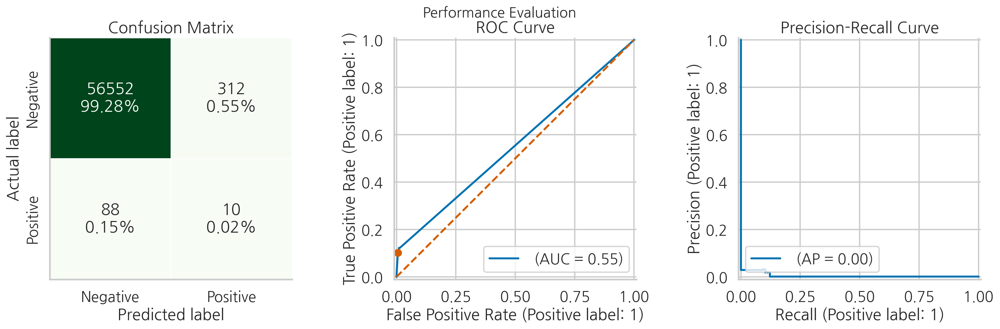

In [15]:
# 기본 LightGBM 분류기 모델 생성 
# random_state를 설정하여 재현 가능한 결과 보장
clf = LGBMClassifier(random_state=RANDOM_STATE)

# 훈련 데이터로 모델 학습
clf.fit(X_train, y_train)

# 테스트 데이터에 대한 성능 평가 보고서 생성
# show_plot=True: ROC 곡선 등 시각화 
# show_pr_curve=True: Precision-Recall 곡선 표시
benchmark_perf = performance_evaluation_report(
    clf, X_test, y_test, 
    show_plot=True, 
    show_pr_curve=True
)

# 재현율(Recall) 점수 출력 - 사기 탐지에서 중요한 지표
print(f'Recall: {benchmark_perf["recall"]:.4f}')

# seaborn 그래프의 테두리 제거하여 깔끔한 시각화
sns.despine()
# plt.savefig("images/figure_14_18", dpi=200)  # 그래프 저장시 사용

그림 14.18: 기준 LightGBM 모델의 성능 평가
 
또한, 테스트 세트에서 기준 모델의 재현율(recall) 점수가 0.4286임을 확인했습니다.

5. Define the objective function:

5단계에서는 진정한 목적 함수를 정의합니다(베이지안 최적화가 대리 변수를 생성할 함수를 의미함). 이 함수는 하이퍼파라미터 집합을 입력으로 받아 5겹 층화된 교차 검증을 사용하여 최소화할 손실 값을 계산합니다. 사기 탐지의 경우, 가능한 한 많은 사기를 탐지하고자 하므로, 긍정 오류가 발생하더라도 재현율을 지표로 선택합니다. 최적화 기가 손실 값을 최소화하기 때문에 이 함수를 -1로 곱하여 최대화 문제로 변환합니다. 이 함수는 단일 값(손실) 또는 적어도 두 개의 키-값 쌍을 갖는 사전을 반환해야 합니다:

- `loss` — 진정한 목적 함수의 값입니다.
- `status` — 손실 값이 올바르게 계산되었는지 나타내는 지표입니다. `STATUS_OK` 또는 `STATUS_FAIL`이 될 수 있습니다.

또한, 목적 함수를 평가할 때 사용한 하이퍼파라미터 집합을 반환합니다. 이에 대해서는 추가 정보에서 다시 다룰 것입니다.

> cross_val_score 함수를 사용하여 검증 점수를 계산합니다. 그러나, 때로는 StratifiedKFold와 같은 클래스를 통해 수동으로 반복을 제어해야 할 경우가 있습니다. 예를 들어, LightGBM의 네이티브 API에서 조기 중단 등의 기능을 활용하려 할 때 사용할 수 있습니다.

In [16]:
def objective(params, n_folds=N_FOLDS, 
              random_state=RANDOM_STATE, 
              metric=EVAL_METRIC):
    """
    베이지안 최적화를 위한 목적 함수
    
    Args:
        params: 평가할 하이퍼파라미터 집합
        n_folds: 교차 검증에 사용할 폴드 수 
        random_state: 재현성을 위한 랜덤 시드
        metric: 평가 지표(예: 재현율)
    """
    # 디버깅 모드일 때 현재 시도중인 파라미터 출력
    if DEBUG:
        print(params)
    
    # 주어진 파라미터로 LightGBM 모델 생성
    model = LGBMClassifier(**params, random_state=random_state)
    
    # 층화 k-폴드 교차 검증 객체 생성
    # shuffle=True로 데이터 섞기
    k_fold = StratifiedKFold(n_folds, shuffle=True, 
                             random_state=random_state)

    # 교차 검증 수행하여 성능 점수 계산
    scores = cross_val_score(model, X_train, y_train, 
                             cv=k_fold, scoring=metric)
    
    # 최대화 문제를 최소화 문제로 변환 (-1 곱함)
    loss = -1 * scores.mean()
    
    # hyperopt에 필요한 형식으로 결과 반환
    # loss: 최소화할 목적 함수 값
    # params: 사용된 하이퍼파라미터
    # status: 평가 성공 여부
    return {"loss": loss, "params": params, "status": STATUS_OK}

6. Define the search space:

6단계에서는 하이퍼파라미터 그리드를 정의합니다. 검색 공간은 사전으로 정의되며, GridSearchCV에 대해 정의된 공간과 비교했을 때, hyperopt의 내장 함수들을 사용합니다. 다음과 같은 함수들이 있습니다:

- `hp.choice(label, list)` — 주어진 옵션 중 하나를 반환합니다.
- `hp.uniform(label, lower_value, upper_value)` — 두 값 사이의 균등 분포를 반환합니다.
- `hp.quniform(label, low, high, q)` — 두 값 사이의 균등 분포를 정량화하여 반환합니다(이산적인 분포). 이는 설정된 값 간에 균등하게 분포되도록 보장합니다.
- `hp.loguniform(label, low, high)` — 로그-균등 분포에서 값을 반환합니다. 로그 스케일에서 균등 분포를 갖습니다. 예를 들어, 학습 속도를 튜닝할 때 0.001, 0.01, 0.1, 1 사이의 값이 균등 분포를 갖도록 설정합니다.
- `hp.randint(label, upper_value)` — [0, upper_value) 범위의 무작위 정수를 반환합니다.

이 설정에서는 각 하이퍼파라미터의 이름(label이라고 표시됨)을 두 번 정의해야 합니다. 또한, 일부 경우에는 변수를 정수로 바꾸기 위해 scope.int를 사용해야 합니다.

In [17]:
# 하이퍼파라미터 탐색 공간 정의
search_space = {
    # 트리의 개수 (50, 100, 250, 500 중 선택)
    "n_estimators": hp.choice("n_estimators", [50, 100, 250, 500]),
    
    # 부스팅 방식 (gbdt, dart, goss 중 선택)
    "boosting_type": hp.choice(
        "boosting_type", ["gbdt", "dart", "goss"]
    ),
    
    # 클래스 불균형 처리 여부 (True/False)
    "is_unbalance": hp.choice("is_unbalance", [True, False]),
    
    # 트리의 최대 깊이 (3~20 사이의 정수)
    "max_depth": scope.int(hp.uniform("max_depth", 3, 20)),
    
    # 리프 노드의 최대 개수 (5~100 사이, 간격 1)
    "num_leaves": scope.int(hp.quniform("num_leaves", 5, 100, 1)),
    
    # 리프 노드의 최소 데이터 수 (20~500 사이, 간격 5)
    "min_child_samples": scope.int(
        hp.quniform("min_child_samples", 20, 500, 5)
    ),
    
    # 각 트리마다 사용할 특성의 비율 (0.3~1.0 사이)
    "colsample_bytree": hp.uniform("colsample_bytree", 0.3, 1.0),
    
    # 학습률 (0.01~0.5 사이, 로그 스케일)
    "learning_rate": hp.loguniform(
        "learning_rate", np.log(0.01), np.log(0.5)
    ),
    
    # L1 정규화 파라미터 (0.0~1.0 사이)
    "reg_alpha": hp.uniform("reg_alpha", 0.0, 1.0),
    
    # L2 정규화 파라미터 (0.0~1.0 사이)
    "reg_lambda": hp.uniform("reg_lambda", 0.0, 1.0),
}

In [18]:
sample(search_space)

{'boosting_type': 'goss',
 'colsample_bytree': 0.8792681143669197,
 'is_unbalance': True,
 'learning_rate': 0.10721129032079649,
 'max_depth': 11,
 'min_child_samples': 470,
 'n_estimators': 250,
 'num_leaves': 76,
 'reg_alpha': 0.5932477764965433,
 'reg_lambda': 0.6073668392342378}

7. Find the best hyperparameters using Bayesian HPO:

7단계에서는 최적의 하이퍼파라미터 집합을 찾기 위해 베이지안 최적화를 실행합니다. 먼저, Trials 객체를 정의하며, 이 객체는 검색의 기록을 저장하는 데 사용됩니다. 이미 완료된 검색을 재개하거나, 기존 기록을 사용하여 반복 횟수를 늘리고자 할 때 사용할 수 있습니다.

두 번째로, 목적 함수를 정의하고, 검색 공간, 대리 모델, 최대 반복 횟수, trials 객체를 설정하여 기록을 저장합니다. TPE 알고리즘에 대한 자세한 내용은 hyperopt의 문서를 참조하시기 바랍니다. 또한, rstate 값을 설정하며, 이는 hyperopt의 random_state와 같습니다. To do so, `pickle.dump` 및 `pickle.load` 함수를 사용하여 이 객체를 피클 파일에 쉽게 저장할 수 있습니다.

> 베이지안 최적화 실행 후, trials 객체에는 유용한 정보가 포함된 객체 집합이 있습니다. 최상의 하이퍼파라미터는 trials.best_trial을 통해 찾을 수 있으며, trials.results를 통해 탐색된 모든 하이퍼파라미터 집합을 볼 수 있습니다. 이에 대한 내용은 추가 정보에서 다룰 것입니다.

In [20]:
# Trials 객체를 생성하여 하이퍼파라미터 탐색 과정을 저장
trials = Trials()

# fmin 함수를 사용하여 베이지안 최적화 수행
# - fn=objective: 최적화할 목적 함수 지정
# - space=search_space: 탐색할 하이퍼파라미터 공간 정의
# - algo=tpe.suggest: Tree-structured Parzen Estimators 알고리즘 사용
# - max_evals=MAX_EVALS: 최대 평가 횟수 설정
# - trials=trials: 탐색 과정 저장할 객체
# - rstate: 재현성을 위한 난수 생성기 설정
# - show_progressbar=False: 진행 상태바 표시하지 않음
best_set = fmin(fn=objective,
                space=search_space,
                algo=tpe.suggest,
                max_evals=MAX_EVALS,
                trials=trials,
                rstate=np.random.default_rng(RANDOM_STATE),
                show_progressbar=False)

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 316, number of negative: 181960
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003513 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001734 -> initscore=-6.355800
[LightGBM] [Info] Start training from score -6.355800
[LightGBM] [Warning] No further splits with positiv

In [ ]:
# trials = Trials()
# best_set = fmin(fn=objective,
#                 space=search_space,
#                 algo=tpe.suggest,
#                 max_evals=MAX_EVALS,
#                 trials=trials,
#                 rstate=np.random.default_rng(RANDOM_STATE))

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 316, number of negative: 181960           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004628 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] Using GOSS                                                    
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001734 -> initscore=-6.35

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Info] Number of positive: 315, number of negative: 181961           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001728 -> initscore=-6.358975 
[LightGBM] [Info] Start training from score -6.358975                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [War

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Info] Number of positive: 315, number of negative: 181961           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004935 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001728 -> initscore=-6.358975 
[LightGBM] [Info] Start training from score -6.358975                           
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [War

In [21]:
# store the results in a pickle
pickle.dump(trials, open("light_gbm_200_runs.p", "wb"))

8. Inspect the best set of hyperparameters:

8단계에서는 최적의 하이퍼파라미터 집합을 점검합니다. 사전을 단순히 출력하는 대신, space_eval 함수를 사용해야 합니다. 이는 단순히 사전을 출력할 경우 범주형 특성의 지표 대신 인덱스를 보게 되기 때문입니다. 예를 들어, best_set 사전을 출력하면 0 대신 'gbtree'가 표시될 수 있습니다.

In [22]:
space_eval(search_space , best_set)

{'boosting_type': 'goss',
 'colsample_bytree': 0.3383123762230449,
 'is_unbalance': True,
 'learning_rate': 0.02258656764729999,
 'max_depth': 6,
 'min_child_samples': 435,
 'n_estimators': 50,
 'num_leaves': 5,
 'reg_alpha': 0.9966352940049583,
 'reg_lambda': 0.9640754955397034}

In [23]:
best_set

{'boosting_type': 2,
 'colsample_bytree': 0.3383123762230449,
 'is_unbalance': 0,
 'learning_rate': 0.02258656764729999,
 'max_depth': 6.493385975814141,
 'min_child_samples': 435.0,
 'n_estimators': 0,
 'num_leaves': 5.0,
 'reg_alpha': 0.9966352940049583,
 'reg_lambda': 0.9640754955397034}

9. Fit a new model using the best hyperparameters:

마지막 두 단계에서는, 최적의 하이퍼파라미터를 사용하여 LightGBM 분류기를 정의하고 테스트 세트에서 성능을 평가합니다.

In [24]:
# 최적의 하이퍼파라미터를 사용하여 LightGBM 분류기를 초기화합니다
# space_eval()을 통해 하이퍼파라미터 공간에서 최적값을 가져옵니다
tuned_lgbm = LGBMClassifier(
    **space_eval(search_space, best_set),  # 최적화된 하이퍼파라미터 적용
    random_state=RANDOM_STATE  # 재현성을 위한 랜덤 시드 설정
)

# 훈련 데이터로 모델을 학습시킵니다
tuned_lgbm.fit(X_train, y_train)

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 394, number of negative: 227451
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000735 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7395
[LightGBM] [Info] Number of data points in the train set: 227845, number of used features: 29
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001729 -> initscore=-6.358339
[LightGBM] [Info] Start training from sco

LGBMClassifier(boosting_type='goss', colsample_bytree=0.3383123762230449,
               is_unbalance=True, learning_rate=0.02258656764729999,
               max_depth=6, min_child_samples=435, n_estimators=50,
               num_leaves=5, random_state=42, reg_alpha=0.9966352940049583,
               reg_lambda=0.9640754955397034)

10. Evaluate the fitted model on the test set:

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
Recall: 0.9184


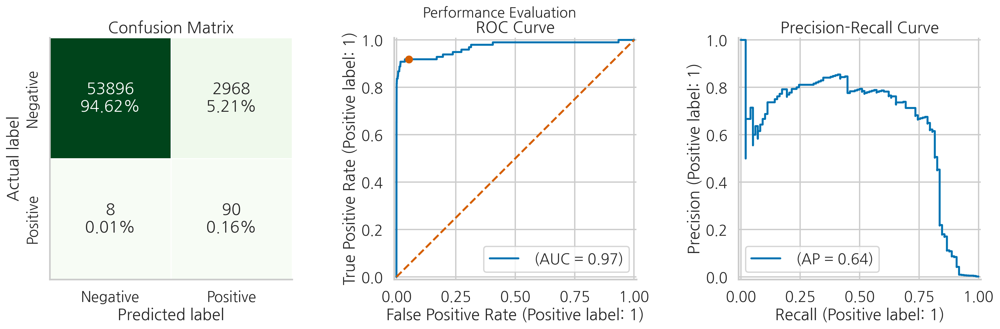

In [38]:
# 튜닝된 모델의 성능을 평가합니다
# performance_evaluation_report 함수를 사용하여 다양한 성능 지표를 계산하고 시각화합니다
tuned_perf = performance_evaluation_report(
    tuned_lgbm,  # 튜닝된 LightGBM 모델
    X_test,      # 테스트 데이터
    y_test,      # 테스트 레이블 
    show_plot=True,     # ROC 곡선 등의 시각화 표시
    show_pr_curve=True  # Precision-Recall 곡선 표시
)

# 재현율(Recall) 점수를 출력합니다
# 재현율은 실제 양성 케이스 중 모델이 정확하게 예측한 비율을 나타냅니다
print(f'Recall: {tuned_perf["recall"]:.4f}')

# seaborn 그래프의 테두리를 제거하여 시각화를 깔끔하게 만듭니다
sns.despine()
# 그래프를 파일로 저장하는 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_14_19", dpi=200)

그림 14.19: 튜닝된 LightGBM 모델의 성능 평가
 
튜닝된 모델이 테스트 세트에서 더 나은 성능을 보여주었음을 알 수 있습니다. 구체적으로, 재현율(recall) 점수가 0.8980으로, 기준값 0.4286과 비교했을 때 크게 향상되었습니다.

### There's more

베이지안 하이퍼파라미터 최적화에 대해 흥미롭고 유용한 사항이 많습니다. 다음 하위 섹션에서 간단하게 설명하고자 합니다. 코드 전체를 모두 포함하기엔 내용이 많아 여기에서는 간단히 다룹니다. 전체 코드 워크스루를 보려면, 책의 GitHub 저장소에 있는 Jupyter 노트북을 참조하십시오.

#### Conditional hyperparameter space

1. Define a conditional hyperparameter space:

조건부 하이퍼파라미터 공간은 특정 조건에 따라 하이퍼파라미터의 설정을 다르게 적용하는 방식입니다. 이를 통해 다양한 머신 러닝 모델을 실험할 수 있는데, 각 모델은 고유한 하이퍼파라미터를 가질 수 있습니다. 

예를 들어, LightGBM에서 `boosting_type`을 선택할 때, `goss`라는 값이 있다면 `subsample`을 사용할 수 없습니다. `subsample`은 데이터를 일부만 추출하여 학습하는 옵션인데, `goss`에서는 이 기능이 비활성화되어야 하기 때문입니다. 그래서 `goss`일 때는 `subsample` 값을 무조건 1로 설정하고, `subsample_freq`도 0으로 설정하여 샘플링을 사용하지 않도록 해야 합니다.

이렇게 조건에 따라 설정이 달라지도록 `hp.choice`를 사용하여 조건부 검색 공간을 설정할 수 있습니다.

다음 코드 스니펫을 사용하여 `hp.choice`를 통해 조건부 검색 공간을 정의합니다:

In [39]:
# 조건부 하이퍼파라미터 검색 공간을 정의합니다
conditional_search_space = {
    # boosting_type을 선택하는 부분입니다
    "boosting_type": hp.choice("boosting_type", [
        # GBDT(Gradient Boosting Decision Tree) 부스팅 타입
        {"boosting_type": "gbdt", 
         # subsample: 각 트리 학습에 사용할 데이터 샘플링 비율 (0.5~1.0)
         "subsample": hp.uniform("gdbt_subsample", 0.5, 1),
         # subsample_freq: 몇 번째 반복마다 샘플링을 수행할지 지정 (1~20)
         "subsample_freq": scope.int(
            hp.uniform("gdbt_subsample_freq", 1, 20)
         )}, 
        # DART(Dropouts meet Multiple Additive Regression Trees) 부스팅 타입
        {"boosting_type": "dart",
         # DART용 subsample 파라미터 (0.5~1.0) 
         "subsample": hp.uniform("dart_subsample", 0.5, 1),
         # DART용 subsample 주기 설정 (1~20)
         "subsample_freq": scope.int(
            hp.uniform("dart_subsample_freq", 1, 20)
         )},
        # GOSS(Gradient-based One-Side Sampling) 부스팅 타입
        # GOSS는 샘플링을 사용하지 않으므로 subsample=1.0, freq=0으로 고정
        {"boosting_type": "goss",
         "subsample": 1.0,
         "subsample_freq": 0},
    ]),
    # 학습에 사용할 트리의 개수를 선택 (50, 100, 250, 500 중 하나)
    "n_estimators": hp.choice("n_estimators", [50, 100, 250, 500]),
}

In [40]:
# conditional_search_space = {
#     "boosting_type": hp.choice("boosting_type", [
#         {"boosting_type": "gbdt", 
#          "subsample": hp.uniform("gdbt_subsample", 0.5, 1),
#          "subsample_freq": scope.int(hp.uniform("gdbt_subsample_freq", 1, 20))}, 
#         {"boosting_type": "dart",
#          "subsample": hp.uniform("dart_subsample", 0.5, 1),
#          "subsample_freq": scope.int(hp.uniform("dart_subsample_freq", 1, 20))},
#         # {"boosting_type": "rf",
#         #  "subsample": hp.uniform("rf_subsample", 0.5, 1),
#         #  "subsample_freq": scope.int(hp.uniform("rf_subsample_freq", 1, 20))},
#         {"boosting_type": "goss",
#          "subsample": 1.0,
#          "subsample_freq": 0},
#     ]),
#     "n_estimators": hp.choice("n_estimators", [50, 100, 250, 500]),
#     "is_unbalance": hp.choice("is_unbalance", [True, False]),
#     "max_depth": scope.int(hp.uniform("max_depth", 3, 20)),
#     "num_leaves": scope.int(hp.quniform("num_leaves", 5, 100, 1)),
#     "min_child_samples": scope.int(hp.quniform("min_child_samples", 20, 500, 5)),
#     "colsample_bytree": hp.uniform("colsample_bytree", 0.3, 1.0),
#     "learning_rate": hp.loguniform("learning_rate", np.log(0.01), np.log(0.5)),
#     "reg_alpha": hp.uniform("reg_alpha", 0.0, 1.0),
#     "reg_lambda": hp.uniform("reg_lambda", 0.0, 1.0),
# }

이 공간에서 추출한 예시는 다음과 같습니다:

In [41]:
# draw from the search space
params = sample(conditional_search_space)
params

{'boosting_type': {'boosting_type': 'goss',
  'subsample': 1.0,
  'subsample_freq': 0},
 'n_estimators': 50}

In [42]:
# retrieve the conditional parameters, set to default if missing
subsample = params["boosting_type"].get("subsample", 1.0)
subsample_freq = params["boosting_type"].get("subsample_freq", 0)

# fill in the params dict with the conditional values
params["boosting_type"] = params["boosting_type"]["boosting_type"]
params["subsample"] = subsample
params["subsample_freq"] = subsample_freq

params

{'boosting_type': 'goss',
 'n_estimators': 50,
 'subsample': 1.0,
 'subsample_freq': 0}

2. Modify the objective function to account for the conditional hyperparameter space:

In [43]:
def modified_objective(params, n_folds=N_FOLDS, random_state=RANDOM_STATE, metric=EVAL_METRIC):
           
    # retrieve the conditional parameters, set to default if missing
    subsample = params["boosting_type"].get("subsample", 1.0)
    subsample_freq = params["boosting_type"].get("subsample_freq", 0)
    
    # fill in the params dict with the conditional values
    params["boosting_type"] = params["boosting_type"]["boosting_type"]
    params["subsample"] = subsample
    params["subsample_freq"] = subsample_freq

    # useful for debugging
    if DEBUG:
        print(params)
    
    model = LGBMClassifier(**params, random_state=random_state)
    k_fold = StratifiedKFold(n_folds, shuffle=True, 
                             random_state=random_state)

    scores = cross_val_score(model, X_train, y_train, 
                             cv=k_fold, scoring=metric)
    loss = -1 * scores.mean()
    
    return {"loss": loss, "params": params, "status": STATUS_OK}

3. Run the Bayesian HPO with the conditional hyperparam space:

In [44]:
trials = Trials()
best_set_2 = fmin(fn= modified_objective,
                  space= conditional_search_space,
                  algo= tpe.suggest,
                  max_evals = MAX_EVALS,
                  trials= trials,
                  rstate=np.random.default_rng(RANDOM_STATE))

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 316, number of negative: 181960           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004439 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] Using GOSS                                                    
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001734 -> initscore=-6.35

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Info] Number of positive: 315, number of negative: 181961           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001728 -> initscore=-6.358975 
[LightGBM] [Info] Start training from score -6.358975                           
[LightGBM] [Info] Number of positive: 315, number of negative: 181961           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004406 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[L

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No furt

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Info] Number of positive: 315, number of negative: 181961           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004675 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001728 -> initscore=-6.358975 
[LightGBM] [Info] Start training from score -6.358975                           
[LightGBM] [Info] Number of positive: 315, number of negative: 181961           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004696 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[L

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Info] Number of positive: 316, number of negative: 181960           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004255 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001734 -> initscore=-6.355800 
[LightGBM] [Info] Start training from score -6.355800                           
[LightGBM] [Info] Number of positive: 315, number of negative: 181961           
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003406 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395                                               
[LightGBM] [Info] Number of data points in the train set: 182276, number of used features: 29
[L

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the s

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf      
[LightGBM] [Warning] Stopped

In [ ]:
# store the results in a pickle
pickle.dump(trials, open("light_gbm_200_runs_conditional_space.p", "wb"))

4. Inspect the best hyperparameters:

In [46]:
space_eval(conditional_search_space , best_set_2)

{'boosting_type': {'boosting_type': 'dart',
  'subsample': 0.9562305179392618,
  'subsample_freq': 4},
 'n_estimators': 50}

5. Clean up the dictionary before training a model:

In [47]:
best_params_2 = space_eval(conditional_search_space , best_set_2)

# retrieve the conditional parameters, set to default if missing
subsample = best_params_2["boosting_type"].get("subsample", 1.0)
subsample_freq = best_params_2["boosting_type"].get("subsample_freq", 0)

# fill in the best_params_2 dict with the conditional values
best_params_2["boosting_type"] = best_params_2["boosting_type"]["boosting_type"]
best_params_2["subsample"] = subsample
best_params_2["subsample_freq"] = subsample_freq

best_params_2

{'boosting_type': 'dart',
 'n_estimators': 50,
 'subsample': 0.9562305179392618,
 'subsample_freq': 4}

6. Train the tuned LightGBM classifier:

In [ ]:
tuned_lgbm_2 = LGBMClassifier(
    **best_params_2,
    random_state=RANDOM_STATE
)
tuned_lgbm_2.fit(X_train, y_train)

tuned_perf_2 = performance_evaluation_report(tuned_lgbm_2, X_test, y_test, 
                                           show_plot=True, 
                                           show_pr_curve=True)

print(f'Recall: {tuned_perf_2["recall"]:.4f}')

sns.despine()
# plt.savefig("images/figure_14_20", dpi=200)

[LightGBM] [Info] Number of positive: 394, number of negative: 227451
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003992 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395
[LightGBM] [Info] Number of data points in the train set: 227845, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.001729 -> initscore=-6.358339
[LightGBM] [Info] Start training from score -6.358339
Recall: 0.5510


#### 탐색된 하이퍼파라미터에 대한 심층 분석

hyperopt는 샘플링할 수 있는 다양한 분포를 제공한다고 언급한 바 있습니다. 실제로 분포가 어떻게 생겼는지를 보면 이해가 훨씬 쉬워질 것입니다. 먼저 학습률의 분포를 살펴봅니다. 학습률을 다음과 같이 설정했습니다:

0. Load the trials file (if needed):

In [ ]:
trials = pickle.load(open("light_gbm_200_runs.p", "rb"))

1. Import the additional libraries:

In [ ]:
from pandas.io.json import json_normalize

2. Define a helper function for drawing samples from a hyperparameter search space:

In [ ]:
def draw_samples(search_space, n_samples=10000):
    samples_list = []

    for _ in range(n_samples):
        samples_list.append(sample(search_space))

    return samples_list

3. Plot the distribution of the learning rate:

In [ ]:
lr_samples = draw_samples(search_space["learning_rate"])
    
sns.kdeplot(lr_samples, linewidth = 2, shade = True)
plt.title("Distribution of learning rate")
plt.xlabel("Learning rate")
plt.ylabel("Density") 

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_21", dpi=200)

4. Create the KDE plot of `min_child_samples`: 

In [ ]:
mcs_samples = draw_samples(search_space["min_child_samples"])
    
sns.kdeplot(mcs_samples, linewidth = 2, shade = True)
plt.title("Distribution of min_child_samples")
plt.xlabel("min_child_samples")
plt.ylabel("Density") 

plt.tight_layout()
sns.despine()

5. Plot the distribution of `min_child_samples`: 

We could also use the `sns.countplot`, however, we only wanted to plot a restricted range of values to keep the plot readable.

In [ ]:
(
    pd.Series(mcs_samples)
    .value_counts()
    .sort_index()
    .head(20)
    .plot(kind="bar", 
          title="Distribution of min_child_samples")
);

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_22", dpi=200)

6. Store all the information from `trials.results` into a DataFrame:

In [ ]:
results_df = pd.DataFrame(trials.results)
params_df = json_normalize(results_df["params"])
results_df = pd.concat([results_df.drop("params", axis=1), params_df], 
                       axis=1)
results_df["iteration"] = np.arange(len(results_df)) + 1
results_df.sort_values("loss")

7. Plot the prior distribution of `colsample_bytree` and the one used during the HPO:

In [ ]:
cbt_samples = draw_samples(search_space["colsample_bytree"])

fig, ax = plt.subplots(1, 2, figsize = (16, 8))

sns.kdeplot(cbt_samples, 
            label="Sampling Distribution", 
            ax=ax[0])
sns.kdeplot(results_df["colsample_bytree"], 
            label="Bayesian Optimization", 
            ax=ax[0])
ax[0].set(title="Distribution of colsample_bytree", 
          xlabel="Value",
          ylabel="Density")
ax[0].legend()

sns.regplot("iteration", "colsample_bytree", 
            data=results_df, ax=ax[1])
ax[1].set(title="colsample_bytree over Iterations", 
          xlabel="Iteration", 
          ylabel="Value")

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_24", dpi=200)

8. Plot the distribution of `n_estimators`:

In [ ]:
(
    results_df["n_estimators"]
    .value_counts()
    .plot(kind="bar",
          title="Distribution of # of Estimators")
)

plt.tight_layout()
sns.despine()

9. Plot the evolution of the observed losses over iterations:

In [ ]:
best_ind = results_df["loss"].argmin()

fig, ax = plt.subplots()
ax.plot(results_df["iteration"], results_df["loss"], "o")
ax.plot(results_df["iteration"].iloc[best_ind], 
        results_df["loss"].iloc[best_ind], 
        "k*", markersize=16)
ax.set(title="Evolution of loss over iterations", 
       xlabel="Iteration",
       ylabel="Loss")
plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_25", dpi=200)

### See also

추가 자료는 아래에서 확인할 수 있습니다:

- Bergstra, J. S., Bardenet, R., Bengio, Y., & Kégl, B. 2011. 하이퍼파라미터 최적화를 위한 알고리즘. *Advances in Neural Information Processing Systems*: 2546–2554.
- Bergstra, J., Yamins, D., & Cox, D. D. 2013, 6월. Hyperopt: 머신 러닝 알고리즘의 하이퍼파라미터 최적화를 위한 Python 라이브러리. *Proceedings of the 12th Python in science conference*: 13–20.
- Bergstra, J., Yamins, D., Cox, D. D. 2013. 모델 검색의 과학 만들기: 비전 아키텍처를 위한 수백 차원의 하이퍼파라미터 최적화. *30th International Conference on Machine Learning (ICML 2013)* 논문집.
- Claesen, M., & De Moor, B. 2015. “머신 러닝에서의 하이퍼파라미터 검색.” *arXiv preprint arXiv:1502.02127.*
- Falkner, S., Klein, A., & Hutter, F. 2018, 7월. BOHB: 확장 가능한 견고한 하이퍼파라미터 최적화. *International Conference on Machine Learning*: 1437–1446. PMLR.
- Hutter, F., Kotthoff, L., & Vanschoren, J. 2019. *Automated machine learning: methods, systems, challenges*: 219. Springer Nature.
- Klein, A., Falkner, S., Bartels, S., Hennig, P., & Hutter, F. 2017, 4월. 대규모 데이터셋에서 머신 러닝 하이퍼파라미터의 빠른 베이지안 최적화. *Artificial intelligence and statistics*: 528–536. PMLR.
- Komer B., Bergstra J., & Eliasmith C. 2014. “Hyperopt-Sklearn: Scikit-learn을 위한 자동 하이퍼파라미터 구성” *Proc. SciPy*.
- Li, L., Jamieson, K., Rostamizadeh, A., Gonina, E., Hardt, M., Recht, B., & Talwalkar, A. 2018. 대규모 병렬 하이퍼파라미터 튜닝: [https://doi.org/10.48550/arXiv.1810.05934](https://doi.org/10.48550/arXiv.1810.05934).
- Shahriari, B., Swersky, K., Wang, Z., Adams, R. P., & De Freitas, N. 2015. 베이지안 최적화의 사람 개입 제거: 리뷰. *Proceedings of the IEEE*, 104(1): 148–175.
- Snoek, J., Larochelle, H., & Adams, R. P. 2012. 머신 러닝 알고리즘의 실용적 베이지안 최적화. *Advances in Neural Information Processing Systems*: 25.

## 14.6 특징 중요도 조사

우리는 이미 파이프라인을 설정하고 모델 성능을 개선하기 위해 모델을 튜닝하는 데 상당한 시간을 투자했습니다. 그러나 **모델의 해석 가능성**도 중요합니다. 이는 정확한 예측을 제공할 뿐 아니라 그 이유를 설명할 수 있어야 함을 의미합니다. 예를 들어, 고객 이탈에 대한 예측에서 어떤 특징이 고객 이탈의 주된 요인인지 아는 것은 전반적인 서비스 개선과 고객 유지율 향상에 도움이 될 수 있습니다.

금융 분야에서 은행은 종종 머신러닝을 사용하여 고객의 신용이나 대출 상환 능력을 예측합니다. 많은 경우, 은행은 이러한 예측의 이유를 설명할 의무가 있습니다. 매우 복잡한 모델에서는 이러한 설명이 어렵거나 불가능할 수 있습니다.

특징 중요도를 이해하면 다음과 같은 다양한 이점을 얻을 수 있습니다:

- 모델 논리를 이해함으로써, 중요한 변수에 집중하여 모델의 정확도를 이론적으로 검증할 수 있습니다.
- 특정 퍼센트 이상의 중요도에 기여하는 m개의 가장 중요한 특징만 남길 수 있어, 훈련 시간을 줄이면서도 예측 성능을 유지할 수 있습니다.
- 해석 가능성을 위해 일부 성능 지표를 희생하더라도, 모델의 직관적 이해를 높일 수 있습니다.

>모델이 (특정 성능 지표 측면에서) 더 정확할수록 특징 중요도도 더 신뢰할 수 있다는 점을 인식하는 것이 중요합니다. 이것이 우리가 모델 튜닝 후에 특징 중요도를 조사하는 이유입니다. 과적합된 모델은 신뢰할 수 있는 특징 중요도를 반환하지 않으므로 과적합도 고려해야 한다는 점에 유의하세요.

이 레시피에서는 랜덤 포레스트 분류기를 예로 들어 특징 중요도를 계산하는 방법을 설명합니다. 그러나 이 방법들은 모델에 구애받지 않습니다. 여기서는 특징 중요도를 계산하는 세 가지 방법을 간략히 소개합니다.

**1. 불순도 감소의 평균 (Mean Decrease in Impurity, MDI)**

MDI는 랜덤 포레스트가 사용하는 기본 특징 중요도 측정 방식입니다(지니 중요도라고도 함). 결정 트리는 불순도 측정 지표(Gini 지수/엔트로피/MSE)를 사용해 분할을 최적화합니다. 트리를 훈련할 때, 각 특징이 불순도를 얼마나 줄이는지 계산하여 전체 숲의 평균 불순도 감소를 계산합니다.

>불순도 기반 메트릭을 사용할 때는 특징 중요도의 절대값(1로 정규화됨)보다는 변수의 순위(상대값)에 초점을 맞춰야 합니다.

**장점**:
- 빠른 계산
- 구현 용이

**단점**:
- 연속형(수치형) 특징이나 고차원 범주형 특징을 과대평가하는 경향이 있습니다.
- 불순도 기반 중요도는 훈련 세트에 의존하며, 모델이 새로운 데이터에 일반화할 수 있는 능력을 반영하지 않습니다.

**2. 드롭-컬럼 중요도**

이 방법은 매우 간단한 아이디어에 기반합니다. 전체 특징을 포함한 모델과 특정 특징을 제거한 모델을 비교하여 중요도를 평가합니다.

**장점**:
- 특징 중요도를 평가하는 가장 정확하고 신뢰할 수 있는 방법으로 간주됨

**단점**:
- 데이터셋의 각 변형에 대해 모델을 다시 훈련해야 하므로 높은 계산 비용이 발생할 수 있음

**3. 순열 특징 중요도**

순열 특징 중요도는 각 예측 변수를 무작위로 섞어 모델 성능에 미치는 영향을 관찰하여 특징 중요도를 직접 측정합니다. 이 방법은 특정 특징이 중요하다면 성능 저하가 크다는 점에서 특징 중요도를 평가합니다.

**알고리즘 단계**:
1. 기본 모델을 훈련하고 기준 점수를 기록합니다.
2. 특징 값을 무작위로 섞고, 섞인 데이터셋을 사용하여 예측 성능을 측정합니다.
3. 기준 점수와 순열화된 데이터셋 점수의 차이를 특징 중요도로 간주합니다.

이 레시피에서는 신용카드 사기 데이터셋을 사용하여 특징 중요도를 조사할 것입니다.

>성능 평가를 위해 훈련 데이터나 검증/테스트 세트를 사용할 수 있습니다. 검증 또는 테스트 세트를 사용하면 모델의 일반화 능력에 대한 통찰력을 얻을 수 있다는 추가적인 이점이 있습니다. 예를 들어, 훈련 세트에서는 중요하지만 검증 세트에서는 중요하지 않은 특징들은 실제로 모델의 과적합을 유발할 수 있습니다. 이 주제에 대한 자세한 논의는 해석 가능한 머신러닝 책(참고 자료 섹션 참조)을 참조하세요.

이 접근법의 장점은 다음과 같습니다:

- **모델에 구애받지 않음**: 특정 모델에 의존하지 않음
- **합리적인 효율성**: 매 단계에서 모델을 다시 훈련할 필요 없음
- **변수 분포 보존**: 변수를 섞어도 원래의 분포를 유지함

이 접근법의 단점은 다음과 같습니다:

- **계산 비용이 높음**: 기본 특징 중요도 계산보다 계산 비용이 많이 듦
- **신뢰할 수 없는 중요도 발생 가능성**: 특징들이 높은 상관 관계를 가질 때 신뢰할 수 없는 결과를 생성할 가능성이 있음(자세한 설명은 Strobl 외 참조)

이 레시피에서는 **앙상블 분류기 탐구** 레시피에서 사용한 신용카드 연체 데이터셋을 활용하여 특징 중요도를 조사할 것입니다.

### Getting Ready

이 레시피에서는 **앙상블 분류기 탐구** 레시피에서 학습한 랜덤 포레스트 파이프라인(이하 `rf_pipeline`)을 사용합니다. 모든 초기 단계는 반복을 피하기 위해 Jupyter 노트북에서 확인할 수 있습니다.

1. Import the libraries:

In [6]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from chapter_14_utils import performance_evaluation_report

2. Load data, preprocess it, define the model (and its hyperparameters) and fit it:

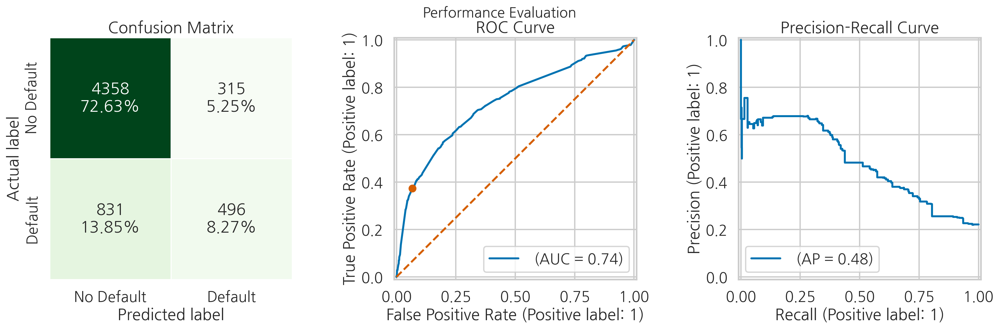

In [8]:
# 신용카드 연체 데이터셋 로드
df = pd.read_csv("./datasets/credit_card_default.csv", na_values="")

# 특징(X)과 타겟(y) 분리
X = df.copy()
y = X.pop("default_payment_next_month")

# 훈련/테스트 세트 분할 (80/20)
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    stratify=y, 
                                                    random_state=42)

# 수치형/범주형 특징 구분
num_features = X_train.select_dtypes(include="number").columns.to_list()
cat_features = X_train.select_dtypes(include="object").columns.to_list()

# 수치형 특징 전처리 파이프라인 (중앙값으로 결측치 대체)
num_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median"))
])

# 범주형 특징의 고유값 리스트 생성
cat_list = [list(X_train[col].dropna().unique()) for col in cat_features]

# 범주형 특징 전처리 파이프라인 (최빈값으로 결측치 대체 + 원핫인코딩)
cat_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("onehot", OneHotEncoder(
        categories=cat_list, 
        sparse_output=False,  # 'sparse' 대신 'sparse_output' 사용
        handle_unknown="error", 
        drop="first"
    ))
])

# 수치형/범주형 전처리기 결합
preprocessor = ColumnTransformer(
    transformers=[
        ("numerical", num_pipeline, num_features),
        ("categorical", cat_pipeline, cat_features)
    ], 
    remainder="drop"
)

# 전체 파이프라인 구성 (전처리 + 랜덤 포레스트)
rf_pipeline = Pipeline(
    steps=[("preprocessor", preprocessor),
           ("classifier", RandomForestClassifier(random_state=42))]
)

# Recipe 14.1에서 얻은 최적 하이퍼파라미터 설정
best_params = {
    "n_estimators": 300, 
    "min_samples_split": 2, 
    "min_samples_leaf": 7, 
    "max_features": None, 
    "max_depth": 8, 
    "bootstrap": False
}
rf_pipeline["classifier"].set_params(**best_params)

# 모델 학습
rf_pipeline.fit(X_train, y_train)

# 성능 평가 및 시각화
LABELS = ["No Default", "Default"]
rf_perf = performance_evaluation_report(rf_pipeline, X_test, 
                                        y_test, labels=LABELS, 
                                        show_plot=True, 
                                        show_pr_curve=True)

3. Sanity check for the recall score (compared to results in Recipe 14.1):

In [9]:
print(f"Recall: {rf_perf['recall']:.4f}")

Recall: 0.3738


### How to do it...

1. Import the libraries:

1단계에서 필요한 라이브러리를 가져옵니다. 그다음, 파이프라인에서 분류기와 `ColumnTransformer` 전처리기를 가져옵니다. 이 레시피에서는 `Exploring ensemble classifiers`에서 조정된 하이퍼파라미터를 사용한 튜닝된 랜덤 포레스트 분류기를 사용합니다.

In [10]:
import numpy as np
import pandas as pd
from sklearn.inspection import permutation_importance
from sklearn.metrics import recall_score
from sklearn.base import clone

2. Extract the classifier and preprocessor from the fitted pipeline:

2단계에서는 전처리기의 변환을 적용하여 훈련 세트와 테스트 세트를 준비합니다.

In [11]:
# 파이프라인에서 분류기와 전처리기 컴포넌트를 추출
rf_classifier = rf_pipeline.named_steps["classifier"]
preprocessor = rf_pipeline.named_steps["preprocessor"]

3. Recover feature names from the preprocessing transformer and transform the training/test sets:

3단계에서는 `get_feature_names_out` 메서드를 사용하여 전처리기에서 컬럼 이름을 추출합니다. 그다음 훈련 세트와 테스트 세트를 준비하기 위해 전처리기의 변환을 적용합니다.

In [12]:
# 전처리기에서 특성 이름 추출
feat_names = list(preprocessor.get_feature_names_out())

# numerical__ 및 categorical__ 접두사 제거
feat_names = [name.replace("numerical__", "").replace("categorical__", "") for name in feat_names]

# 전처리된 훈련 데이터를 데이터프레임으로 변환
X_train_preprocessed = pd.DataFrame(
    preprocessor.transform(X_train), 
    columns=feat_names
)

# 전처리된 테스트 데이터를 데이터프레임으로 변환 
X_test_preprocessed = pd.DataFrame(
    preprocessor.transform(X_test), 
    columns=feat_names
)

4. Extract the MDI feature importance and calculate the cumulative importance:

4단계에서는 학습된 랜덤 포레스트 분류기의 `feature_importances_` 속성을 사용하여 MDI(Mean Decrease Impurity) 특징 중요도를 추출합니다. 이러한 값은 자동으로 합이 1이 되도록 정규화됩니다. 추가로, 누적 특징 중요도를 계산합니다.

In [13]:
# 랜덤 포레스트 분류기의 특성 중요도를 데이터프레임으로 변환
rf_feat_imp = pd.DataFrame(rf_classifier.feature_importances_,
                           index=feat_names,
                           columns=["mdi"])

# 특성 중요도의 누적합을 계산하여 새로운 열 추가
rf_feat_imp["mdi_cumul"] = np.cumsum(
    rf_feat_imp
    .sort_values("mdi", ascending=False)  # 중요도 내림차순 정렬
    .loc[:, "mdi"]  # mdi 열만 선택
).loc[feat_names]  # 원래 인덱스 순서로 재정렬

In [14]:
rf_feat_imp.head()

,mdi,mdi_cumul
limit_bal,0.045303,0.752165
age,0.018915,0.829687
bill_statement_sep,0.029459,0.781625
bill_statement_aug,0.013519,0.903986
bill_statement_jul,0.014185,0.876482


In [30]:
rf_feat_imp['mdi'].sum()

1.0

5. Define a function for plotting top X features in terms of their importance:

5단계에서는 가장 중요한 특징과 덜 중요한 특징을 시각화하기 위해 보조 함수를 정의하고, 평균 불순도 감소를 사용하여 상위 10개의 가장 중요한 특징을 계산합니다.

In [15]:
def plot_most_important_features(feat_imp, title, 
                                 n_features=10, 
                                 bottom=False):
    """
    특성 중요도를 시각화하는 함수입니다.
    상위 또는 하위 X개의 중요 특성을 막대 그래프로 표시합니다.
    
    매개변수
    ----------
    feat_imp : pd.Series
        계산된 특성 중요도가 담긴 판다스 Series
    title : str
        그래프 제목으로 사용할 문자열
    n_features : int
        표시할 상위/하위 특성의 개수 (기본값: 10)
    bottom : boolean
        True이면 하위 특성을, False이면 상위 특성을 표시 (기본값: False)
    
    반환값
    -------
    ax : matplotlib.axes._subplots.AxesSubplot
        생성된 그래프가 포함된 matplotlib axes 객체
    """
    
    # bottom 파라미터에 따라 정렬 방향과 표시 텍스트 결정
    if bottom:
        indicator = "Bottom"  # 하위 특성 표시 시
        feat_imp = feat_imp.sort_values(ascending=True)  # 오름차순 정렬
    else:
        indicator = "Top"  # 상위 특성 표시 시 
        feat_imp = feat_imp.sort_values(ascending=False)  # 내림차순 정렬
        
    # 수평 막대 그래프 생성
    ax = feat_imp.head(n_features).plot.barh()
    ax.invert_yaxis()  # y축 순서 반전
    
    # 그래프 제목과 축 레이블 설정
    ax.set(title=f"{title} ({indicator} {n_features})", 
           xlabel="Importance",  # x축: 중요도
           ylabel="Feature")     # y축: 특성명
    
    return ax

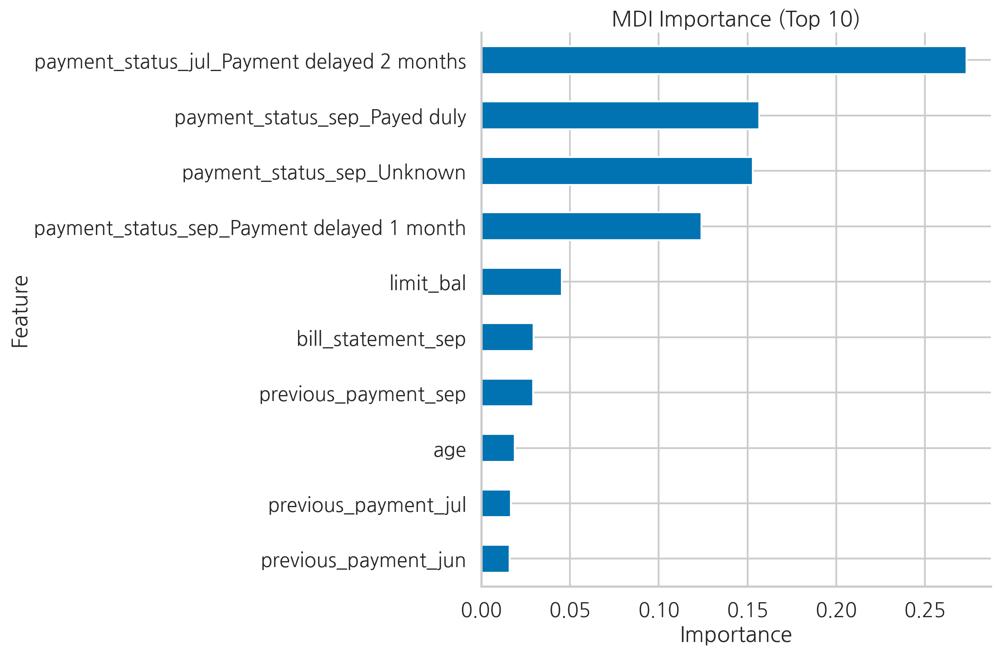

In [16]:
plot_most_important_features(rf_feat_imp["mdi"], 
                             title="MDI Importance")

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_26", dpi=200)

그림 14.26: MDI 메트릭을 사용한 상위 10개 중요 특성

가장 중요한 특성들은 7월과 9월의 결제 상태를 나타내는 범주형 특성들입니다. 이 4개의 특성 다음으로는 한도 잔액, 나이, 다양한 청구서 명세서, 이전 결제 내역과 같은 연속형 특성들을 볼 수 있습니다.

6. Plot the cumulative importance of the features:

6단계에서는 모든 특징의 누적 중요도를 시각화하여 나타냅니다. 이 시각화를 통해 모델에서 일정한 총 중요도 비율을 차지하는 특징의 수를 줄일지 결정할 수 있습니다. 이를 통해 모델의 훈련 시간을 잠재적으로 단축할 수 있습니다.

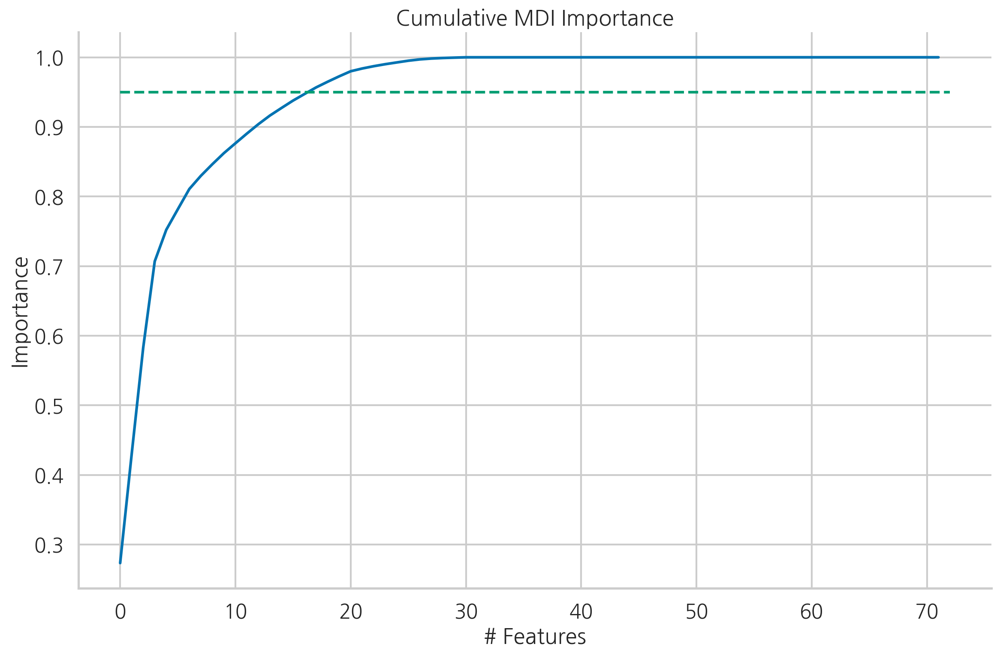

In [17]:
# x축 값으로 특성 개수만큼의 범위 생성
x_values = range(len(feat_names))

# 그래프 생성을 위한 figure와 axes 객체 생성
fig, ax = plt.subplots()

# 누적 MDI 중요도를 정렬하여 선 그래프로 표시
ax.plot(x_values, rf_feat_imp["mdi_cumul"].sort_values(), "b-")

# 95% 중요도 기준선을 수평선으로 표시
ax.hlines(y=0.95, xmin=0, xmax=len(x_values), 
          color="g", linestyles="dashed")

# 그래프 제목과 축 레이블 설정
ax.set(title="Cumulative MDI Importance", # 누적 MDI 중요도
       xlabel="# Features",               # x축: 특성 개수 
       ylabel="Importance")               # y축: 중요도

# 그래프 레이아웃 조정
plt.tight_layout()

# 테두리 제거
sns.despine()
# plt.savefig("images/figure_14_27", dpi=200)

그림 14.27: 누적 MDI 중요도
 
상위 10개 특성이 전체 중요도의 86.23%를 차지하며, 상위 17개 특성이 전체 중요도의 95%를 차지합니다.

In [18]:
# MDI 중요도를 기준으로 상위 10개 특성의 중요도 합계 계산
top_10_importance = rf_feat_imp.sort_values("mdi", ascending=False).head(10)["mdi"].sum()

# 누적 MDI 중요도가 95% 이하인 특성의 개수 계산 
importance_95_perc = rf_feat_imp[rf_feat_imp["mdi_cumul"] <= 0.95].shape[0]

# 결과 출력
print(f"Top 10 features account for {100 * top_10_importance:.2f}% of the total importance.")
print(f"Top {importance_95_perc} features account for 95% of importance.")

Top 10 features account for 86.23% of the total importance.
Top 17 features account for 95% of importance.


7. Calculate and plot permutation importance using the training set:

7단계에서는 `scikit-learn`의 `permutation_importance` 함수를 사용하여 permutation feature importance(교환 특징 중요도)를 계산합니다. 리콜을 평가 지표로 설정하고 `n_repeats` 매개변수를 25로 설정합니다. 이로 인해 알고리즘이 각 특징을 25회 무작위로 섞습니다. 절차의 출력물은 세 가지 요소를 포함하는 딕셔너리로, 각 특징의 원래 중요도, 특징당 평균값, 그리고 해당 표준 편차가 있습니다. 추가적으로, `permutation_importance`를 사용할 때 선택된 여러 지표 목록을 제공하여 여러 지표를 동시에 평가할 수 있습니다.

**우리는 permutation feature importance를 위해 `scikit-learn` 구현을 사용하기로 결정했습니다. 하지만 `rfpimp`나 `eli5` 라이브러리에서도 대체 옵션이 가능합니다. 전자는 드롭-컬럼 특징 중요도도 포함합니다.**

In [19]:
# 훈련 세트에 대한 순열 중요도 계산
# n_repeats=25로 설정하여 각 특성을 25번 무작위로 섞음
# scoring="recall"로 설정하여 리콜을 평가 지표로 사용
# n_jobs=-1로 설정하여 모든 CPU 코어 사용
perm_result_train = permutation_importance(
    rf_classifier, X_train_preprocessed, y_train,
    n_repeats=25, scoring="recall", 
    random_state=42, n_jobs=-1
)

# 계산된 평균 중요도를 rf_feat_imp 데이터프레임에 추가
rf_feat_imp["perm_imp_train"] = (
    perm_result_train["importances_mean"]
)

/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaco

In [20]:
perm_result_train.keys()

dict_keys(['importances_mean', 'importances_std', 'importances'])

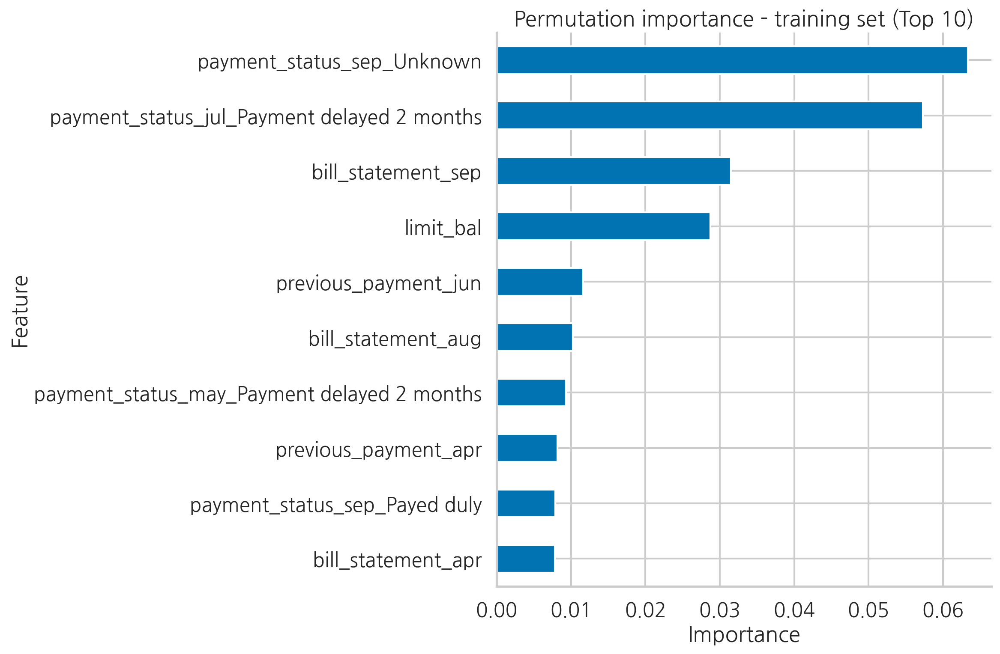

In [21]:
plot_most_important_features(
    rf_feat_imp["perm_imp_train"], 
    title="Permutation importance - training set"
)

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_28", dpi=200)

그림 14.28: 훈련 세트에서 계산된 순열 중요도에 따른 상위 10개 중요 특징

MDI 중요도와 비교했을 때 가장 중요한 특징들의 순서가 재배열된 것을 볼 수 있습니다. 현재 가장 중요한 특징은 payment_status_sep_Unknown인데, 이는 payment_status_sep 범주형 특징에서 정의되지 않은 레이블(원본 논문에서 명확한 의미가 할당되지 않음)입니다. 또한 이 접근 방식으로 결정된 상위 10개 중요 특징들 중에 age가 포함되지 않은 것을 볼 수 있습니다.

8. Calculate and plot permutation importance using the test set:

8단계에서는 이번에는 테스트 세트를 사용하여 permutation feature importance를 계산하고 평가합니다.

우리는 소개에서 데이터 세트에 상관된 특징이 있을 경우 permutation importance가 신뢰할 수 없는 점수를 반환할 수 있다고 언급했습니다. 즉, 중요도 점수가 상관된 특징들에 걸쳐 분산될 것입니다. 이러한 문제를 해결하기 위해 다음과 같은 접근 방식을 시도할 수 있습니다:

- 상관된 특징 그룹을 함께 섞습니다. `rfpimp`는 `importances` 함수에서 이 기능을 제공합니다.
- 특징의 Spearman 순위 상관을 기준으로 계층적 클러스터링을 사용하여 임계값을 설정한 뒤 각 식별된 클러스터에서 단일 특징만 유지할 수 있습니다.

In [22]:
# 테스트 세트에 대한 순열 중요도 계산
# n_repeats=25로 설정하여 각 특성을 25번 무작위로 섞음
# scoring="recall"로 설정하여 리콜을 평가 지표로 사용
# n_jobs=-1로 설정하여 모든 CPU 코어 사용
perm_result_test = permutation_importance(
    rf_classifier, X_test_preprocessed, y_test,
    n_repeats=25, scoring="recall",
    random_state=42, n_jobs=-1
)

# 계산된 평균 중요도를 rf_feat_imp 데이터프레임에 추가
rf_feat_imp["perm_imp_test"] = (
    perm_result_test["importances_mean"]
)

/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
/home/restful3/anaco

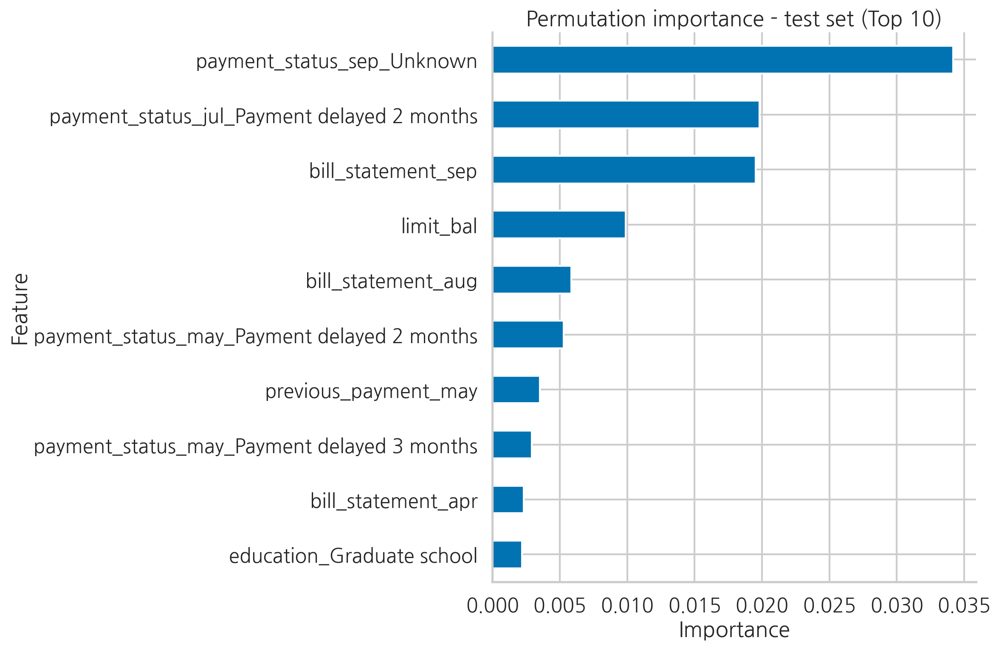

In [23]:
plot_most_important_features(
    rf_feat_imp["perm_imp_test"], 
    title="Permutation importance - test set"
)

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_29", dpi=200)

그림 14.29: 테스트 세트에서 계산된 순열 중요도에 따른 상위 10개 중요 특징

그림들을 살펴보면, 훈련 세트와 테스트 세트 모두에서 동일한 4개의 특징이 가장 중요한 것으로 선택되었음을 알 수 있습니다. 나머지 특징들은 약간의 순서 변동이 있었습니다.

>만약 훈련 세트와 테스트 세트에서 계산된 특징 중요도가 크게 다르다면, 모델이 과적합되었는지 조사해봐야 합니다. 이를 해결하기 위해서는 정규화를 적용하는 것이 좋습니다. 이 경우에는 min_samples_leaf 하이퍼파라미터 값을 증가시키는 것을 시도해볼 수 있습니다.

9. Define a function for calculating the drop-column feature importance:

9단계에서는 드롭-컬럼 특징 중요도를 계산하는 함수를 정의합니다. 먼저, 기준 모델을 사용하여 모든 특징을 훈련하고 평가했습니다. 평가 지표로 리콜을 선택했습니다. 그다음, `scikit-learn`의 `clone` 함수를 사용하여 기준 모델과 정확히 동일한 사양을 가진 모델의 복사본을 생성했습니다. 이후 하나의 특징을 제거한 데이터 세트에서 모델을 반복적으로 훈련시키고, 선택한 평가 지표를 계산하며 점수 차이를 저장했습니다.

In [24]:
def drop_col_feat_imp(model, X, y, metric, random_state=42):
    '''
    특성 중요도를 계산하기 위해 각 특성을 하나씩 제거해보는 함수입니다.
    
    Parameters
    ----------
    model : scikit-learn's model
        선택된 하이퍼파라미터를 가진 모델 객체입니다.
    X : pd.DataFrame
        모델 학습에 사용될 특성 데이터프레임입니다.
    y : pd.Series
        예측하고자 하는 타겟 변수입니다.
    metric : a sklearn metric
        accuracy_score, precision_score, recall_score 등의 평가 지표입니다.
    random_state : int
        재현성을 위한 랜덤 시드 값입니다.
        
    Returns
    -------
    importances : list
        X에 있는 특성들의 순서대로 계산된 중요도 값들의 리스트입니다.
    '''
    
    # 원본 모델의 복사본을 생성합니다
    model_clone = clone(model)
    model_clone.random_state = random_state
    
    # 모든 특성을 사용하여 모델을 학습하고 기준 점수를 계산합니다
    model_clone.fit(X, y)
    benchmark_score = metric(y, model_clone.predict(X))
    
    importances = []
    
    # 각 특성을 하나씩 제거하면서 성능 변화를 측정합니다
    for ind, col in enumerate(X.columns):
        print(f"Dropping {col} ({ind+1}/{len(X.columns)})")
        
        # 매 반복마다 새로운 모델 복사본을 생성합니다
        model_clone = clone(model)
        model_clone.random_state = random_state
        
        # 현재 특성을 제외한 데이터로 모델을 학습합니다
        model_clone.fit(X.drop(col, axis = 1), y)
        
        # 특성을 제거했을 때의 성능을 측정합니다
        drop_col_score = metric(
            y, model_clone.predict(X.drop(col, axis = 1))
        )
        
        # 기준 점수와의 차이를 중요도로 저장합니다
        importances.append(benchmark_score - drop_col_score)
    
    return importances

10. Calculate and plot the drop-column feature importance:

10단계에서는 드롭-컬럼 특징 중요도 함수를 적용하여 가장 중요한 특징과 덜 중요한 특징 모두를 결과로 나타냈습니다.

In [25]:
# 드롭-컬럼 특징 중요도를 계산합니다
# n_jobs=-1로 설정하여 모든 CPU 코어를 사용합니다
# 재현성을 위해 random_state=42로 설정합니다
# 평가 지표로는 재현율(recall_score)을 사용합니다
rf_feat_imp["drop_column_imp"] = drop_col_feat_imp(
    rf_classifier.set_params(**{"n_jobs": -1}), 
    X_train_preprocessed, 
    y_train, 
    metric = recall_score,
    random_state = 42
)

Dropping limit_bal (1/72)
Dropping age (2/72)
Dropping bill_statement_sep (3/72)
Dropping bill_statement_aug (4/72)
Dropping bill_statement_jul (5/72)
Dropping bill_statement_jun (6/72)
Dropping bill_statement_may (7/72)
Dropping bill_statement_apr (8/72)
Dropping previous_payment_sep (9/72)
Dropping previous_payment_aug (10/72)
Dropping previous_payment_jul (11/72)
Dropping previous_payment_jun (12/72)
Dropping previous_payment_may (13/72)
Dropping previous_payment_apr (14/72)
Dropping sex_Male (15/72)
Dropping education_Graduate school (16/72)
Dropping education_High school (17/72)
Dropping education_Others (18/72)
Dropping marriage_Married (19/72)
Dropping marriage_Others (20/72)
Dropping payment_status_sep_Payment delayed 1 month (21/72)
Dropping payment_status_sep_Unknown (22/72)
Dropping payment_status_sep_Payed duly (23/72)
Dropping payment_status_sep_Payment delayed 3 months (24/72)
Dropping payment_status_sep_Payment delayed 4 months (25/72)
Dropping payment_status_sep_Payment

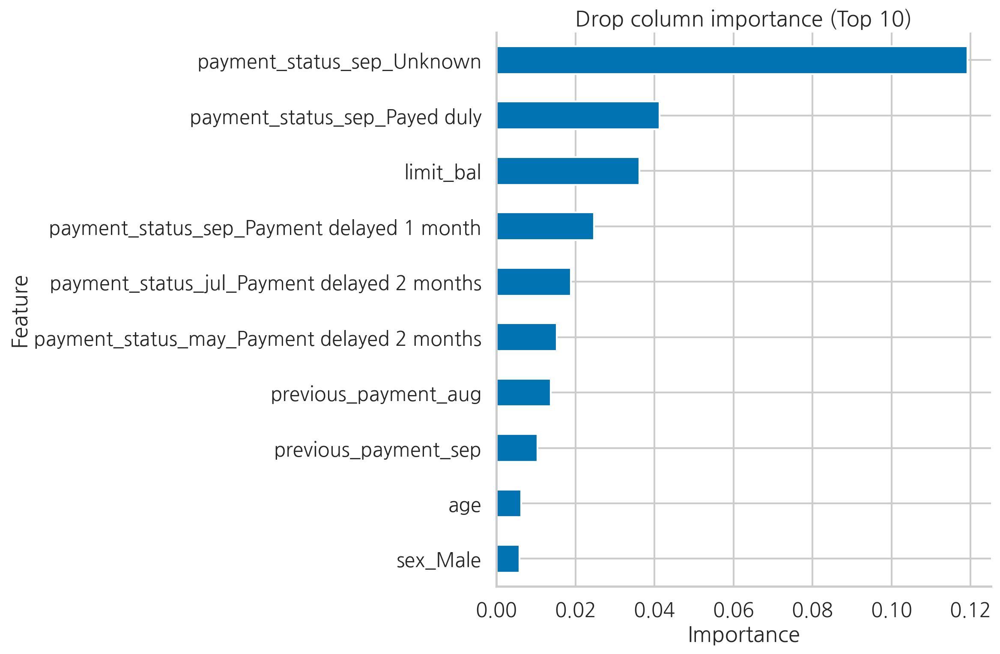

In [26]:
plot_most_important_features(
    rf_feat_imp["drop_column_imp"], 
    title="Drop column importance"
)

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_30", dpi=200)

그림 14.30: 드롭-컬럼 특징 중요도에 따른 상위 10개 중요 특징

드롭-컬럼 특징 중요도(학습 데이터에서 평가됨)를 사용했을 때, 가장 중요한 특징은 payment_status_sep_Unknown이었습니다. 이는 순열 특징 중요도를 사용했을 때도 가장 중요한 특징으로 식별된 것과 동일합니다.

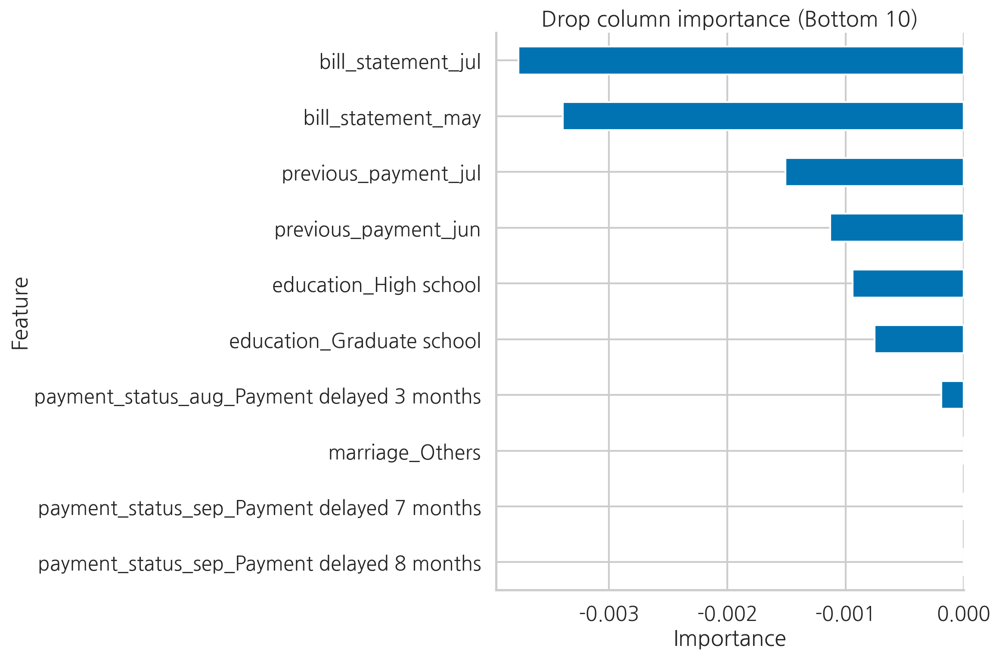

In [27]:
plot_most_important_features(
    rf_feat_imp["drop_column_imp"], 
    title="Drop column importance", 
    bottom=True
)

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_31", dpi=200)

그림 14.31: 드롭-컬럼 특징 중요도에 따른 하위 10개 중요 특징
 
드롭-컬럼 특징 중요도의 경우, 음수 중요도는 해당 특징을 모델에서 제거하면 실제로 성능이 향상된다는 것을 나타냅니다. 이는 고려하는 평가 지표가 높은 값을 더 좋은 것으로 취급하는 한 사실입니다. 우리는 이러한 결과를 활용하여 음수 중요도를 가진 특징들을 제거함으로써 모델의 성능을 개선하거나 학습 시간을 단축할 수 있습니다.


### There's more

우리는 `scikit-learn`의 랜덤 포레스트의 기본 특징 중요도가 MDI/Gini 중요도라는 것을 언급했습니다. 또한, 우리가 `Exploring ensemble classifiers` 레시피에서 언급한 인기 있는 부스팅 알고리즘도 학습된 모델의 `feature_importances_` 속성을 채택했다는 점을 언급할 가치가 있습니다. 그러나 알고리즘에 따라 다른 특징 중요도 측정 방식을 사용합니다.

XGBoost의 경우 다음과 같은 방법이 있습니다:
- `weight` — 모든 트리에서 특정 특징이 데이터를 분할하는 데 사용된 횟수를 측정합니다. Gini 중요도와 유사하지만, 표본 수를 고려하지 않습니다.
- `gain` — 특징이 트리에서 사용될 때의 평균 이득을 측정합니다. 직관적으로 Gini 중요도에서 불순도를 그래디언트 부스팅 모델의 목표로 대체한 것으로 생각할 수 있습니다.
- `cover` — 특징이 사용될 때의 평균 적용 범위를 측정합니다. 적용 범위는 해당 분할의 영향을 받은 표본 수로 정의됩니다.

`cover` 방법은 `weight` 접근 방식의 잠재적인 문제를 해결할 수 있습니다. 단순히 분할 횟수를 계산하는 것은 일부 분할이 소수의 관측치에만 영향을 미칠 수 있어 실제로는 중요하지 않을 수 있기 때문입니다.

LightGBM의 경우 다음과 같은 방법이 있습니다:
- `split` — 모델에서 특징이 사용된 횟수를 측정합니다.
- `gain` — 특징을 사용하는 분할의 총 이득을 측정합니다.

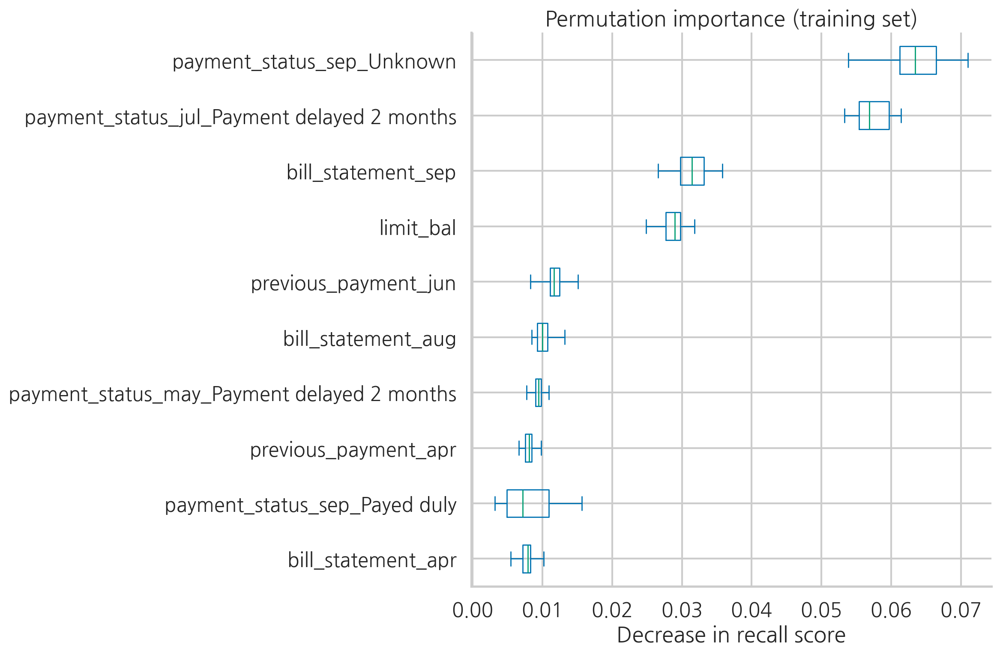

In [28]:
# 중요도 평균값을 기준으로 상위 10개 특징의 인덱스를 가져옴
sorted_imp_ind = perm_result_train["importances_mean"].argsort()[-10:]

# 상위 10개 특징에 대한 순열 중요도 값으로 데이터프레임 생성
importances = pd.DataFrame(
    perm_result_train["importances"][sorted_imp_ind].T,
    columns=X_train_preprocessed.columns[sorted_imp_ind],
)

# 박스플롯 생성 (수평 방향, whis=10으로 설정)
ax = importances.plot.box(vert=False, whis=10)
ax.set_title("Permutation importance (training set)")  # 제목 설정
ax.set_xlabel("Decrease in recall score")  # x축 레이블 설정

# 그래프 레이아웃 조정
plt.tight_layout()
sns.despine()  # 테두리 제거

### See also

추가 자료는 다음에서 확인할 수 있습니다:

- Altmann, A., Toloşi, L., Sander, O., & Lengauer, T. 2010. "Permutation importance: a corrected feature importance measure." *Bioinformatics*, 26(10): 1340–1347.
- Louppe, G. 2014. "Understanding random forests: From theory to practice." *arXiv preprint arXiv:1407.7502*.
- Molnar, C. 2020. *Interpretable Machine Learning*: [https://christophm.github.io/interpretable-ml-book/](https://christophm.github.io/interpretable-ml-book/)
- Hastie, T., Tibshirani, R., Friedman, J. H., & Friedman, J. H. 2009. *The elements of statistical learning: data mining, inference, and prediction*, 2판. 뉴욕: Springer.
- Hooker, G., Mentch, L., & Zhou, S. 2021. "Unrestricted permutation forces extrapolation: variable importance requires at least one more model, or there is no free variable importance." *Statistics and Computing*, 31(6): 1–12.
- Parr, T., Turgutlu, K., Csiszar, C., & Howard, J. 2018. Beware default random forest importances. 2018년 3월 26일. [https://explained.ai/rf-importance/](https://explained.ai/rf-importance/)
- Strobl, C., Boulesteix, A. L., Kneib, T., Augustin, T., & Zeileis, A. 2008. "Conditional variable importance for random forests." *BMC Bioinformatics*, 9(1): 307.
- Strobl, C., Boulesteix, A. L., Zeileis, A., & Hothorn, T. 2007. "Bias in random forest variable importance measures: Illustrations, sources and a solution." *BMC bioinformatics*, 8(1): 1–21.

## 14.7 특징 선택 기법 탐구

이전 레시피에서 우리는 훈련된 머신러닝 모델에 사용된 특징의 중요도를 평가하는 방법을 살펴보았습니다. 이를 통해 특징 선택을 수행할 수 있으며, 이는 관련성 있는 특징만 유지하고 불필요한 특징을 제거하는 것을 의미합니다.

특징 선택은 모든 머신러닝 프로젝트의 중요한 부분입니다. 첫째, 이는 예측 능력에 거의 기여하지 않거나 전혀 기여하지 않는 특징을 제거할 수 있게 해줍니다. 가장 중요한 이점은 이러한 중요하지 않은 특징들이 모델 성능을 악화시키거나 과적합을 유발할 수 있다는 점입니다. 또한, 특징이 적을수록 차원의 저주를 피할 수 있습니다.

둘째, 우리는 **오컴의 면도날**을 따라 모델을 단순하고 이해하기 쉽게 유지해야 합니다. 특징 수가 적당할 때 모델이 실제로 어떻게 작동하는지 설명하기가 더 쉬워지며, 이는 프로젝트의 이해관계자에게 중요할 수 있습니다.

이미 특징 선택의 **이유**는 확립되었습니다. 이제 **방법**을 탐구할 차례입니다. 특징 선택 방법은 크게 세 가지 범주로 나눌 수 있습니다:

- **필터 방법**: 통계적 측정을 사용하는 일변량 방법의 집합으로, 특정 임계값을 만족하는 특징을 필터링합니다. 이 그룹은 특정 머신러닝 알고리즘과 관련이 없기 때문에 일반적으로 계산 비용이 적게 들며 과적합이 적습니다. 그러나 개별 특징을 평가하기 때문에 중요한 관계를 놓칠 수 있습니다. 예시: 상관관계, 카이제곱 검정, 분산 분석(ANOVA), 정보 이득, 분산 임계값 등.

- **래퍼 방법**: 이 접근법은 특징 선택을 탐색 문제로 보고, 특정 머신러닝 모델을 반복적으로 평가하여 최적의 특징 집합을 찾습니다. 계산 비용이 높고 과적합 가능성이 큽니다. 예시: 순방향 선택, 후방 제거, 단계적 선택, 재귀적 특징 제거 등.

- **임베디드 방법**: 이 방법은 Lasso와 같은 규제화 방법을 사용하여 내장된 특징 선택 기법을 가진 알고리즘을 사용합니다. 필터와 래퍼 방법의 중간 정도의 계산 복잡성을 가집니다.

이 레시피에서는 신용카드 사기 데이터셋에 특징 선택 방법을 적용할 것입니다. 많은 특징이 익명화되어 정확한 의미를 알 수 없으며, 모델 성능에 크게 기여하지 않을 가능성이 높습니다.

### Getting ready

이 레시피에서는 **불균형 데이터 처리 방법 조사** 레시피에서 사용한 신용카드 사기 데이터셋을 사용할 것입니다. 모든 준비 단계는 Jupyter 노트북에 포함되어 있습니다.

>또 다른 흥미로운 도전 과제는 BNP 파리바 카디프 클레임 관리 데이터셋에 기능 선택 방법을 적용하는 것입니다 (Kaggle에서 데이터셋을 확인할 수 있으며, 참고 링크는 '참고' 섹션에 제공되어 있습니다). 이 레시피에서 사용된 데이터셋과 유사하게, 해당 데이터셋도 131개의 익명화된 특징을 포함하고 있습니다.

In [5]:
# 필요한 라이브러리 임포트
import pandas as pd
from sklearn.model_selection import train_test_split

# 랜덤 시드 설정
RANDOM_STATE = 42

# 신용카드 사기 데이터셋 로드
df = pd.read_csv("./datasets/credit_card_fraud.csv")

# 시간 컬럼을 제외한 특징 데이터 준비
X = df.copy().drop(columns=["Time"])
# 타겟 변수(Class) 분리
y = X.pop("Class")

# 훈련/테스트 데이터 분할
# test_size=0.2: 테스트 데이터 20%
# stratify=y: 클래스 비율 유지
# random_state: 재현성을 위한 시드값 설정
X_train, X_test, y_train, y_test = train_test_split(
    X, y, 
    test_size=0.2, 
    stratify=y, 
    random_state=RANDOM_STATE
)

### How to do it...

1. Import the libraries:

필요한 라이브러리를 가져온 후, 훈련 및 테스트 세트에서의 재현 점수를 기록하는 임의의 랜덤 포레스트 분류기를 훈련합니다.

In [6]:
# 랜덤 포레스트 분류기 임포트
from sklearn.ensemble import RandomForestClassifier
# 재현율 점수 계산을 위한 메트릭 임포트
from sklearn.metrics import recall_score
# 특징 선택 관련 도구들 임포트
from sklearn.feature_selection import (RFE, RFECV, 
                                       SelectKBest, 
                                       SelectFromModel, 
                                       mutual_info_classif)
# 계층적 K-폴드 교차 검증을 위한 도구 임포트
from sklearn.model_selection import StratifiedKFold

2. Train the benchmark model:

**Step 2**에서는 단변량 기능 선택 기술 범주의 첫 번째로 고려되는 기능 선택 접근 방식을 적용합니다. 통계적 기준으로, 우리는 상호 정보 점수를 사용하며, 이를 계산하기 위해 `scikit-learn`의 `mutual_info_classif` 함수를 사용합니다. 이 함수는 범주형 목표와 연속형 기능에 대해 작동할 수 있습니다. 다행히 이 데이터셋에는 연속적인 수치형 기능만 포함되어 있습니다.

>상호 정보(Mutual Information, MI) 점수는 두 변수 간의 상호 의존성을 측정합니다. 점수가 0에 가까울수록 두 변수가 독립적임을 나타냅니다. 점수가 높을수록 두 변수 간의 의존성이 커짐을 의미합니다. 일반적으로 MI 점수를 계산할 때 각 기능의 확률 분포에 대한 지식이 필요하지만, `scikit-learn` 구현은 비모수적 근사 방법을 사용하여 이 과정을 간소화합니다.


**mutual_info_classif에 대한 추가 설명**

`mutual_info_classif`는 특징(feature)과 목표변수(target) 사이의 상호 정보량(mutual information)을 계산하는 scikit-learn의 함수입니다.

주요 특징:

1. **작동 원리**:
```python
# 기본 사용법
from sklearn.feature_selection import mutual_info_classif

mi_scores = mutual_info_classif(X, y)
```

2. **핵심 개념**:
- 두 변수 간의 통계적 의존성을 측정
- 값이 0이면 두 변수가 독립적임을 의미
- 값이 클수록 변수 간 의존성이 강함을 의미

3. **장점**:
- 선형/비선형 관계 모두 포착 가능
- 범주형 목표변수와 연속형 특징 모두에 사용 가능
- 특징 선택에 효과적

4. **사용 예시**:
```python
# 상위 k개 특징 선택
from sklearn.feature_selection import SelectKBest

selector = SelectKBest(mutual_info_classif, k=10)
X_selected = selector.fit_transform(X, y)
```

5. **주의사항**:
- 계산 비용이 높을 수 있음
- 데이터가 충분히 많아야 신뢰할 수 있는 결과 도출
- 특징들 간의 상호작용은 고려하지 않음

이 방법은 특히 분류 문제에서 중요한 특징을 선택하는데 유용한 도구입니다.

In [7]:
# 랜덤 포레스트 분류기 초기화 
# random_state로 재현성 보장, n_jobs=-1로 모든 CPU 코어 사용
rf = RandomForestClassifier(random_state=RANDOM_STATE, 
                            n_jobs=-1)

# 훈련 데이터로 모델 학습
rf.fit(X_train, y_train)

# 훈련 세트와 테스트 세트에 대한 재현율(recall) 점수 계산
recall_train = recall_score(y_train, rf.predict(X_train))
recall_test = recall_score(y_test, rf.predict(X_test))

# 재현율 점수 출력
print(f"Recall score training: {recall_train:.4f}")
print(f"Recall score test: {recall_test:.4f}")

Recall score training: 1.0000
Recall score test: 0.8265


3. Select the best features using Mutual Information:

다음으로, MI 기준을 `SelectKBest` 클래스와 결합합니다. 이를 통해 임의의 기준으로 **k**개의 최고의 기능을 선택할 수 있습니다. 이 접근 방식을 사용하면, 선택할 기능의 수를 미리 알지 못하는 경우가 많습니다. 따라서, 우리는 가능한 모든 값을 반복하여 평가하며(2부터 29까지, 여기서 29는 데이터셋의 총 기능 수), `SelectKBest` 클래스는 친숙한 `fit/transform` 접근 방식을 사용합니다. 각 반복에서 우리는 클래스에 훈련 데이터(기능 및 목표가 필요함)를 맞추고 나서 MI 기준에 따라 가장 중요한 **k**개의 기능을 선택합니다. 그런 다음 선택된 기능만을 사용하여 다시 랜덤 포레스트 분류기를 맞추고, 관련된 재현 점수를 기록합니다.

`scikit-learn`은 `SelectKBest` 클래스와 함께 다양한 측정 지표를 쉽게 사용할 수 있도록 합니다. 예를 들어, 다음과 같은 점수 기능을 사용할 수 있습니다:

- `f_classif` — 두 변수 간의 선형 의존성 정도를 평가하는 ANOVA F-값. 여기서 F 통계량은 목표 클래스 간의 집단 간 변동성을 집단 내 변동성의 비율로 계산합니다. 이 방법의 잠재적인 단점은 선형 관계만 고려한다는 점입니다.
- `chi2` — 카이 제곱 통계. 이 지표는 음수가 아닌 특징(예: 부울 또는 빈도)에 적합합니다. 직관적으로, 이 점수는 특정 기능이 목표로부터 독립적인지 평가합니다. 독립적일 경우, 분류하는 데 있어 유용하지 않습니다.

**k**개의 최상의 기능을 선택하는 것 외에도, `scikit-learn`의 `feature_selection` 모듈은 상위 점수의 백분위수, 허위 발견율, 또는 가족별 오류율과 같은 기준에 따라 기능을 선택할 수 있습니다.

In [8]:
# tqdm 라이브러리 임포트 - 진행 상태 표시줄을 위해 사용
from tqdm import tqdm

# 성능 점수를 저장할 빈 리스트 초기화
scores = []

# 특징 개수 범위 생성 (2개부터 전체 특징 개수까지)
n_features_list = list(range(2, len(X_train.columns)+1))

# 각 특징 개수별로 반복
for n_feat in tqdm(n_features_list, desc="Feature selection"):
    # 상호 정보량 기반으로 상위 n_feat개의 특징 선택
    mi_selector = SelectKBest(mutual_info_classif, k=n_feat)
    
    # 훈련 데이터에 대해 특징 선택 및 변환 수행
    X_train_new = mi_selector.fit_transform(X_train, y_train)
    # 테스트 데이터에 대해서도 동일한 변환 적용
    X_test_new = mi_selector.transform(X_test)

    # 선택된 특징들로 랜덤 포레스트 모델 학습
    rf.fit(X_train_new, y_train)
    
    # 훈련 세트와 테스트 세트에 대한 재현율 계산
    recall_scores = [
        recall_score(y_train, rf.predict(X_train_new)),  # 훈련 세트 재현율
        recall_score(y_test, rf.predict(X_test_new))     # 테스트 세트 재현율
    ]
    scores.append(recall_scores)

# 결과를 데이터프레임으로 정리
mi_scores_df = pd.DataFrame(
    scores, 
    columns=["train_score", "test_score"],  # 훈련/테스트 점수 열 이름 지정
    index=n_features_list                   # 특징 개수를 인덱스로 사용
)

Starting feature selection process...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.


Processing 4 features...
Processing 5 features...
Processing 19 features...
Processing 17 features...
Processing 8 features...
Processing 3 features...
Processing 2 features...
Processing 6 features...
Processing 13 features...
Processing 9 features...
Processing 10 features...
Processing 11 features...
Processing 14 features...
Processing 15 features...
Processing 12 features...
Processing 18 features...
Processing 25 features...
Processing 20 features...
Processing 7 features...
Processing 27 features...
Processing 26 features...
Processing 22 features...
Processing 21 features...
Processing 23 features...
Processing 24 features...
Processing 16 features...
Processing 28 features...
Processing 29 features...


[Parallel(n_jobs=-1)]: Done  23 out of  28 | elapsed:  4.1min remaining:   53.9s



Feature selection completed in 249.69 seconds


[Parallel(n_jobs=-1)]: Done  28 out of  28 | elapsed:  4.2min finished


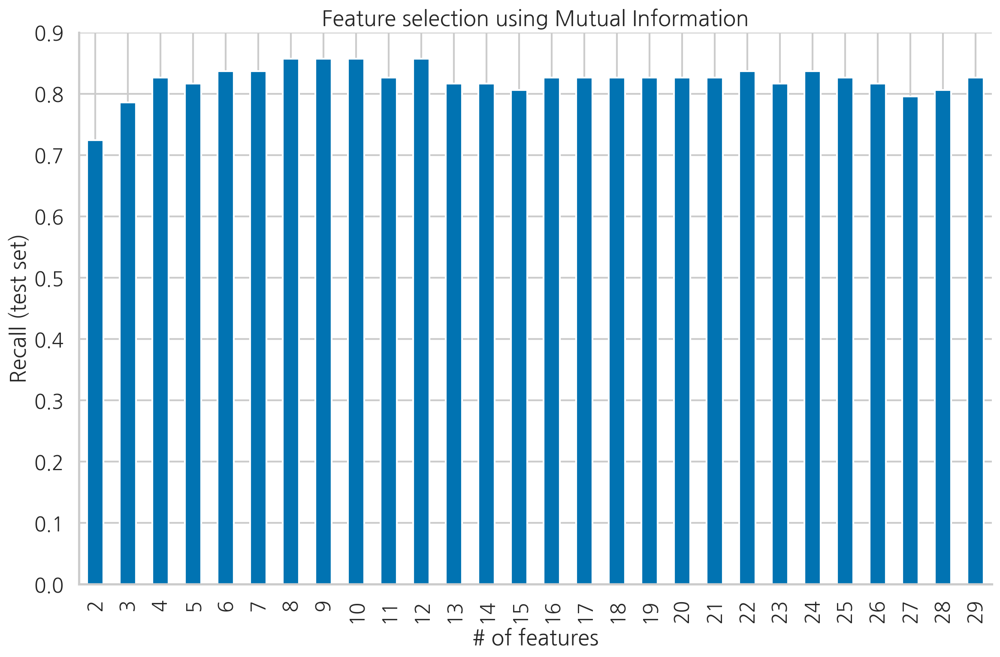

In [9]:
# 상호 정보량을 사용한 특징 선택 결과를 시각화
(
    mi_scores_df["test_score"]
    .plot(kind="bar", # 막대 그래프로 표현
          title="Feature selection using Mutual Information", # 그래프 제목
          xlabel="# of features", # x축 레이블: 특징 개수
          ylabel="Recall (test set)") # y축 레이블: 테스트 세트의 재현율
)

# 그래프 레이아웃 조정
plt.tight_layout()
# 테두리 제거
sns.despine()
# plt.savefig("images/figure_14_32", dpi=200) # 그래프 저장 (주석 처리됨)

Figure 14.32: Performance of the model depending on the number of selected features. Features are selected using the Mutual Information criterion 

By inspecting the figure, we can see that we achieved the best recall score on the test set using 8, 9, 10, and 12 features. As simplicity is desired, we decided to choose 8. Using the following snippet, we extract the names of the 8 most important features:

In [10]:
mi_scores_df["test_score"].sort_values(ascending=False).head(5)

8     0.857143
9     0.857143
10    0.857143
12    0.857143
24    0.836735
Name: test_score, dtype: float64

In [11]:
mi_selector = SelectKBest(mutual_info_classif, k=8)
mi_selector.fit(X_train, y_train)
print(f"Most importance features according to MI: {mi_selector.get_feature_names_out()}")

Most importance features according to MI: ['V3' 'V4' 'V10' 'V11' 'V12' 'V14' 'V16' 'V17']


4. Select the best features using MDI feature importance, retrain the model and evaluate its performance:

**Step 4**에서는 모델 구축 단계의 일부로 수행되는 **임베디드 기능 선택** 기술의 예를 탐구합니다. 이 그룹에서 우리는 모델의 내장 기능 중요도 지표(이 경우 MDI 기능 중요도)를 사용하여 `SelectFromModel` 클래스를 사용해 가장 관련성 높은 기능을 선택합니다. 클래스를 인스턴스화할 때, 우리는 임계값 인수를 제공하여 가장 관련성 높은 기능을 선택할 수 있습니다. 임계값을 초과하는 가중치/계수가 있는 기능은 모델에 유지됩니다. 모든 기능 중요도 평균/중앙값을 임계값으로 사용하려면 "mean" (기본값)과 "median" 키워드를 사용할 수 있습니다. `max_features` 인수를 사용하여 선택할 수 있는 기능의 최대 수를 결정할 수 있습니다.

>`SelectFromModel` 클래스는 `feature_importances_` 또는 `coef_` 속성이 있는 모든 추정기(예: 랜덤 포레스트, XGBoost, LightGBM 등)를 사용할 수 있습니다.

이 단계에서 우리는 선택된 기능을 복구하는 두 가지 접근 방식을 보여줍니다. 첫 번째는 `get_support` 메서드를 사용하는 것으로, 이 메서드는 주어진 기능이 선택되었는지 여부를 나타내는 부울 플래그의 목록을 반환합니다. 

In [12]:
# SelectFromModel을 사용하여 특성 선택기를 초기화합니다
# rf는 이미 학습된 랜덤 포레스트 모델입니다
rf_selector = SelectFromModel(rf)

# 특성 선택기를 학습 데이터에 맞춥니다
# 이 과정에서 각 특성의 중요도를 계산하고 임계값을 기준으로 특성을 선택합니다
rf_selector.fit(X_train, y_train)

# get_support() 메서드로 선택된 특성들의 인덱스를 가져와서
# X_train의 열 이름(특성명)을 선택합니다
mdi_features = X_train.columns[rf_selector.get_support()]

# 선택된 특성들만 사용하여 랜덤 포레스트 모델을 다시 학습시킵니다
rf.fit(X_train[mdi_features], y_train)

# 학습 데이터에 대한 재현율(recall) 점수를 계산합니다
recall_train = recall_score(
    y_train, rf.predict(X_train[mdi_features])
)

# 테스트 데이터에 대한 재현율(recall) 점수를 계산합니다
recall_test = recall_score(y_test, rf.predict(X_test[mdi_features]))

# 학습 및 테스트 데이터에 대한 재현율 점수를 출력합니다
print(f"Recall score training: {recall_train:.4f}")
print(f"Recall score test: {recall_test:.4f}")

Recall score training: 1.0000
Recall score test: 0.8367


두 번째는 선택된 기능의 이름을 직접 반환하는 `get_feature_names_out` 메서드를 사용하는 것입니다. 랜덤 포레스트 분류기를 선택한 경우에는 `SelectFromModel` 클래스의 `transform` 메서드를 사용해 훈련 데이터의 열을 자동으로 선택할 수도 있었습니다.

In [13]:
print(f"MDI importance threshold: {rf_selector.threshold_:.4f}")
print(f"Most importance features according to MDI: {rf_selector.get_feature_names_out()}")

MDI importance threshold: 0.0345
Most importance features according to MDI: ['V10' 'V11' 'V12' 'V14' 'V16' 'V17']


In [14]:
# 기본 랜덤 포레스트 모델을 학습시킵니다
# n_jobs=-1로 설정하여 모든 CPU 코어를 사용합니다
rf = RandomForestClassifier(random_state=RANDOM_STATE, n_jobs=-1)
rf.fit(X_train, y_train)

# 특성 중요도를 추출하고 중요도 순으로 정렬합니다
# feature_importances_ 속성은 각 특성의 중요도를 나타냅니다
mdi_imp = pd.Series(
    rf.feature_importances_,
    index=X_train.columns
).sort_values(ascending=False)

# 각 특성 수에 따른 성능 점수를 저장할 리스트를 초기화합니다
scores = []

# 특성의 수를 2개부터 전체 특성 수까지 1씩 증가시키며 반복합니다
n_features_list = range(2, len(mdi_imp)+1)
for n_feat in n_features_list:
    
    print(f"Keeping {n_feat} most important features")
    # 상위 n_feat개의 중요 특성만 선택합니다
    selected_features = mdi_imp.iloc[:n_feat].index.to_list()
    
    # 선택된 특성들로만 모델을 다시 학습시킵니다
    rf.fit(X_train[selected_features], y_train)
    
    # 학습 데이터와 테스트 데이터에 대한 재현율(recall)을 계산합니다
    recall_scores = [
        recall_score(y_train, rf.predict(X_train[selected_features])), # 학습 데이터 재현율
        recall_score(y_test, rf.predict(X_test[selected_features]))    # 테스트 데이터 재현율
    ]
    scores.append(recall_scores)

# 계산된 점수들을 데이터프레임으로 변환합니다
# 각 행은 사용된 특성의 수를 나타내고, 열은 학습/테스트 점수를 나타냅니다
mdi_scores_df = pd.DataFrame(
    scores, 
    columns=["train_score", "test_score"],
    index=n_features_list
)

Keeping 2 most important features
Keeping 3 most important features
Keeping 4 most important features
Keeping 5 most important features
Keeping 6 most important features
Keeping 7 most important features
Keeping 8 most important features
Keeping 9 most important features
Keeping 10 most important features
Keeping 11 most important features
Keeping 12 most important features
Keeping 13 most important features
Keeping 14 most important features
Keeping 15 most important features
Keeping 16 most important features
Keeping 17 most important features
Keeping 18 most important features
Keeping 19 most important features
Keeping 20 most important features
Keeping 21 most important features
Keeping 22 most important features
Keeping 23 most important features
Keeping 24 most important features
Keeping 25 most important features
Keeping 26 most important features
Keeping 27 most important features
Keeping 28 most important features
Keeping 29 most important features


In [15]:
mdi_scores_df.sort_values("test_score", ascending=False).head()

,train_score,test_score
10,1.0,0.857143
5,1.0,0.846939
11,1.0,0.836735
13,1.0,0.836735
4,1.0,0.836735


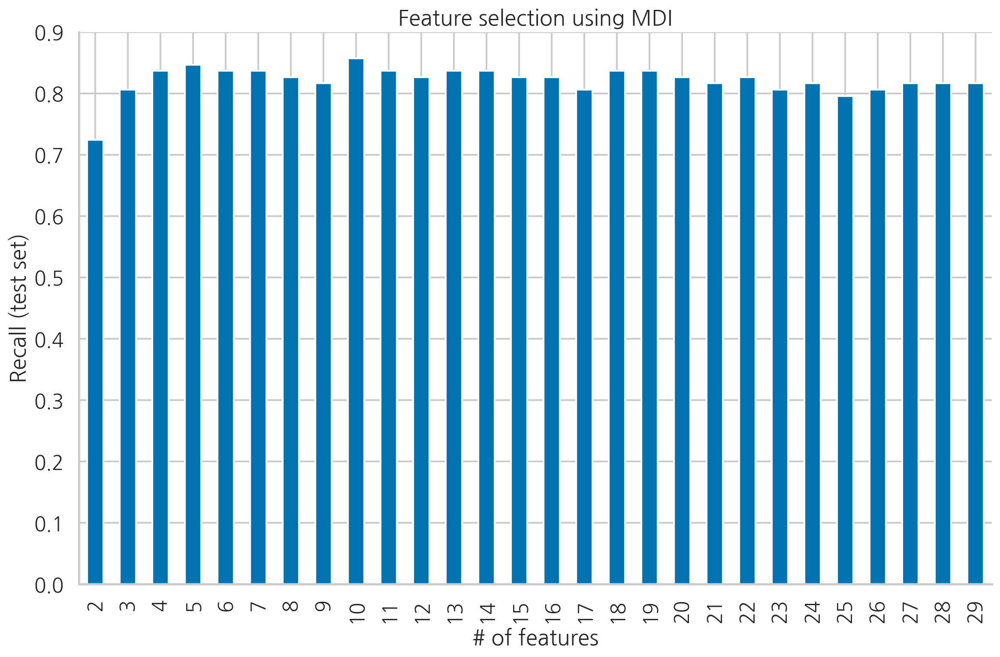

In [16]:
(
    mdi_scores_df["test_score"]
    .plot(kind="bar", 
          title="Feature selection using MDI",
          xlabel="# of features",
          ylabel="Recall (test set)")
)

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_33", dpi=200)

그림 14.33: 선택된 특성의 수에 따른 모델의 성능. 특성은 평균 불순도 감소(Mean Decrease in Impurity) 특성 중요도를 사용하여 선택됨

5. Select the best 10 features using Recursive Feature Elimination:

**Step 5**에서는 **래퍼 방법**의 예로서 재귀 기능 제거(RFE)를 사용합니다. RFE는 모든 기능을 사용하여 처음에 모델을 훈련시키고, 기능 중요도(또는 `coef_` 또는 `feature_importances_`)를 계산한 다음, 가장 중요하지 않은 기능이나 특징을 제거하는 알고리즘입니다. 이 과정은 원하는 기능 수에 도달할 때까지 반복됩니다. RFE 클래스를 인스턴스화할 때, 제거할 기능 수를 결정하는 `step` 인수를 제공할 수 있습니다.

>RFE는 특히 큰 기능 집합과 교차 검증을 사용하면 계산적으로 비용이 많이 들 수 있습니다. 이러한 경우, RFE를 사용하기 전에 상관된 기능을 제거하여 일부 기능 선택 기술을 적용하는 것이 좋을 수 있습니다.

In [17]:
rfe = RFE(estimator=rf, n_features_to_select=10, verbose=1)
rfe.fit(X_train, y_train)

Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.


RFE(estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
    n_features_to_select=10, verbose=1)

In [18]:
rfe_features = rfe.get_feature_names_out()
rf.fit(X_train[rfe_features], y_train)
recall_train = recall_score(y_train, rf.predict(X_train[rfe_features]))
recall_test = recall_score(y_test, rf.predict(X_test[rfe_features]))
print(f"Most importance features according to RFE: {rfe_features}")
print(f"Recall score training: {recall_train:.4f}")
print(f"Recall score test: {recall_test:.4f}")

Most importance features according to RFE: ['V4' 'V7' 'V9' 'V10' 'V11' 'V12' 'V14' 'V16' 'V17' 'V26']
Recall score training: 1.0000
Recall score test: 0.8367


6. Select the best features using Recursive Feature Elimination with cross-validation:

우리가 언급했듯이, 우리는 최적의 특징 수를 알지 못하는 경우가 많습니다. 그렇기 때문에, **Step 6**에서는 교차 검증과 RFE를 결합하여 최적의 특징 수를 자동으로 결정합니다. 우리는 5회 분할 층화 교차 검증(불균형 데이터셋이기 때문에) 방법을 사용하고, 평가 지표로 재현(recall)을 설정하며, 최소한으로 유지할 특징 수를 임의로 5로 설정했습니다. 마지막 인수로 `cv_results_` 속성을 사용하여 각 교차 검증의 점수를 더 깊이 조사할 수 있습니다.

In [19]:
k_fold = StratifiedKFold(5, shuffle=True, random_state=42)

rfe_cv = RFECV(estimator=rf, step=1, 
               cv=k_fold, 
               min_features_to_select=5, 
               scoring="recall", 
               verbose=1, n_jobs=-1)
rfe_cv.fit(X_train, y_train)

Fitting estimator with 29 features.
Fitting estimator with 29 features.
Fitting estimator with 29 features.
Fitting estimator with 29 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 28 features.
Fitting estimator with 28 features.
Fitting estimator with 28 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 27 features.
Fitting estimator with 27 features.Fitting estimator with 27 features.

Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 26 features.
Fitting estimator with 26 features.
Fitting estimator with 26 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 25 features.
Fitting estimator with 25 features.
Fitting estimator with 25 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 24 features.
Fitting estimator with 24 fe

RFECV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
      estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
      min_features_to_select=5, n_jobs=-1, scoring='recall', verbose=1)

In [20]:
rfecv_features = rfe_cv.get_feature_names_out()
rf.fit(X_train[rfecv_features], y_train)
recall_train = recall_score(y_train, rf.predict(X_train[rfecv_features]))
recall_test = recall_score(y_test, rf.predict(X_test[rfecv_features]))
print(f"Most importance features according to RFECV: {rfecv_features}")
print(f"Recall score training: {recall_train:.4f}")
print(f"Recall score test: {recall_test:.4f}")

Most importance features according to RFECV: ['V1' 'V4' 'V6' 'V7' 'V9' 'V10' 'V11' 'V12' 'V14' 'V15' 'V16' 'V17' 'V18'
 'V20' 'V21' 'V26']
Recall score training: 1.0000
Recall score test: 0.8265


In [21]:
# we added 5 as we set min_features_to_select to 5 while calling RFECV
cv_results_df = pd.DataFrame(rfe_cv.cv_results_)
cv_results_df.index += 5
cv_results_df

,mean_test_score,std_test_score,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,n_features
5,0.771600,0.010744,0.782051,0.759494,0.759494,0.784810,0.772152,5
6,0.774099,0.028268,0.769231,0.734177,0.772152,0.822785,0.772152,6
7,0.779195,0.036276,0.782051,0.721519,0.772152,0.835443,0.784810,7
8,0.776631,0.028545,0.769231,0.734177,0.772152,0.822785,0.784810,8
9,0.766472,0.037353,0.756410,0.708861,0.759494,0.822785,0.784810,9
10,0.779163,0.023695,0.769231,0.759494,0.759494,0.822785,0.784810,10
11,0.776631,0.030709,0.769231,0.746835,0.759494,0.835443,0.772152,11
12,0.774067,0.027403,0.756410,0.746835,0.759494,0.822785,0.784810,12
13,0.781727,0.023169,0.782051,0.759494,0.759494,0.822785,0.784810,13
14,0.776631,0.026204,0.769231,0.746835,0.759494,0.822785,0.784810,14


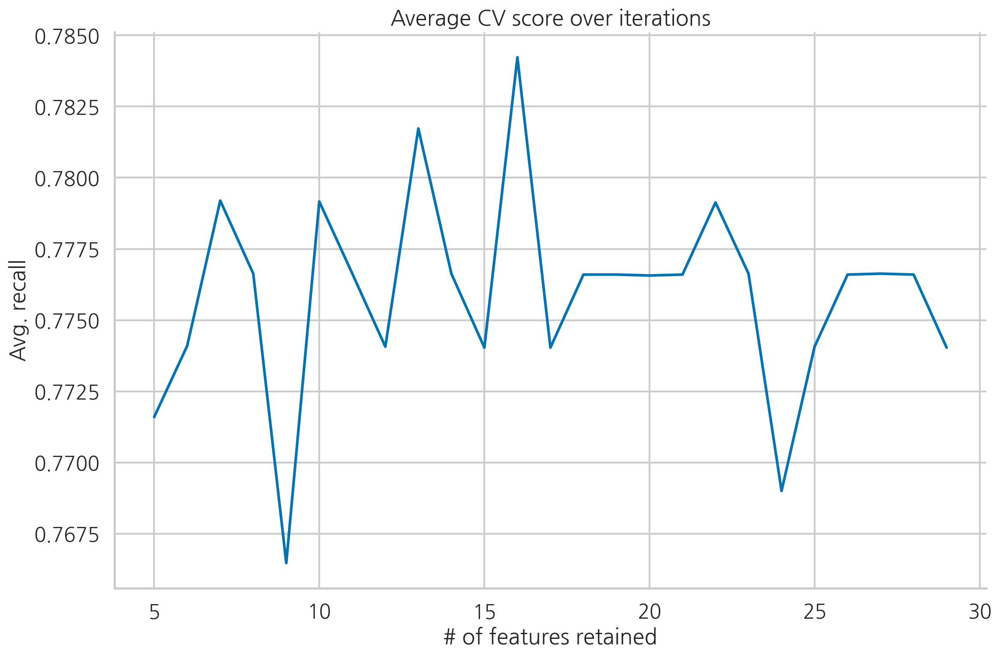

In [22]:
(
    cv_results_df["mean_test_score"]
    .plot(title="Average CV score over iterations",
          xlabel="# of features retained",
          ylabel="Avg. recall")
)

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_34", dpi=200)

그림 14.34: RFE 절차의 각 단계별 평균 CV 점수

그림을 살펴보면 16개의 특성을 사용했을 때 가장 높은 평균 재현율을 얻었음을 확인할 수 있습니다.

특성 선택의 이점을 평가할 때는 두 가지 시나리오를 고려해야 합니다. 더 명백한 첫 번째 시나리오에서는 일부 특성을 제거했을 때 모델의 성능이 향상됩니다. 이는 추가 설명이 필요하지 않습니다. 두 번째 시나리오는 더 흥미롭습니다. 특성을 제거한 후에도 초기와 비슷하거나 약간 더 나쁜 성능을 얻을 수 있습니다. 하지만 이것이 반드시 실패를 의미하지는 않습니다. 동일한 성능을 유지하면서 특성의 약 60%를 제거한 경우를 생각해보세요. 이는 데이터셋과 모델에 따라 훈련 시간을 몇 시간 또는 며칠까지 단축할 수 있는 큰 개선이 될 수 있습니다. 또한 이러한 모델은 해석하기가 더 쉽습니다.

In [23]:
import numpy as np
np.ceil((29 - 5) / 1) + 1

25.0

In [24]:
# feature importances derived from the last fitted model
rfe_cv.estimator_.feature_importances_

array([0.02196562, 0.03372461, 0.02203109, 0.03806824, 0.02769604,
       0.08288049, 0.06599013, 0.19487935, 0.13542467, 0.01912116,
       0.06538599, 0.18863255, 0.02406916, 0.02156627, 0.02517988,
       0.03338473])

### There's more

#### 사용 가능한 다른 접근 방식들

우리는 이미 몇 가지 단변량 필터 방법을 언급했습니다. 추가로 주목할 만한 방법은 다음과 같습니다:

- **분산 임계값 설정(Variance Thresholding)** — 이 방법은 지정된 임계값보다 분산이 낮은 피처을 제거합니다. 따라서, 일정한 값 또는 거의 일정한 값을 갖는 피처을 제거하는 데 사용할 수 있습니다. 후자는 대부분의 값이 동일하여 변동성이 거의 없는 피처을 의미합니다. 기본적으로 이 방법은 목표 값을 보지 않고 피처만 고려합니다.
- **상관 기반(Correlation-based)** — 상관 관계를 측정하는 여러 방법이 있습니다. 우리는 이 접근 방식의 일반적인 논리에만 집중할 것입니다. 먼저, 피처과 목표 간의 상관 관계를 결정한 후, 모델링을 위해 유지할 상관 관계의 임계값을 선택할 수 있습니다.

다음으로, 서로 높은 상관 관계가 있는 피처을 제거하는 것을 고려해야 합니다. 이러한 그룹을 식별한 후, 데이터셋에서 각 그룹에서 하나의 피처만 남길 수 있습니다. 대안적으로, 다중공선성을 확인하고 높은 VIF 값에 따라 피처을 제거하기 위해 `statsmodels`에서 제공하는 **분산 팽창 계수(VIF)** 를 사용할 수도 있습니다.

우리는 이 레시피에서 상관 관계를 기준으로 고려하지 않았습니다. 이는 신용카드 사기 데이터셋의 피처들이 PCA 결과물이므로, 정의에 따라 이들은 직교하고, 즉 상관 관계가 없기 때문입니다.

다변량 필터 방법도 몇 가지 사용할 수 있습니다. 예를 들어, **최대 관련성 최소 중복도(MRMR)** 는 목표 변수와 높은 관련성을 가지면서 상호 중복성이 적은 피처 하위 집합을 식별하려는 알고리즘 계열입니다.

다음과 같은 **래퍼(wrapper)** 기술들도 탐구할 수 있습니다:

- **순방향 피처 선택(Forward Feature Selection)** — 초기에는 피처가 없는 상태에서 시작합니다. 각 피처을 개별적으로 테스트하여 모델을 가장 잘 개선하는 피처을 선택합니다. 선택한 피처을 피처 집합에 추가한 후, 정지 조건(최대 피처 수 또는 더 이상의 개선이 없을 때)에 도달할 때까지 하나씩 피처을 추가합니다. 전통적으로 추가할 피처은 p-값을 기준으로 결정되었지만, 현대 라이브러리는 교차 검증된 메트릭을 개선한 것을 선택 기준으로 사용하는 경우가 많습니다.
- **역방향 피처 선택(Backward Feature Selection)** — 순방향 피처 선택과 유사하게, 초기에는 모든 피처을 사용하여 시작한 후, 한 번에 하나씩 피처을 제거하여 더 이상의 개선이 없거나 모든 피처이 통계적으로 유의미할 때까지 진행합니다. 이 방법은 피처 제거 시 RFE와 달리, 차이를 측정하여 성능 개선을 최적화합니다.
- **완전 탐색 피처 선택(Exhaustive Feature Selection)** — 쉽게 말해, 이 강력한 접근 방식은 가능한 모든 피처 조합을 테스트합니다. 당연히 피처 수가 많아질수록 계산 비용이 크게 증가합니다. 예를 들어, **a**, **b**, **c** 세 개의 피처이 있다면, 우리는 [a], [b], [c], [ab], [ac], [bc], [abc]의 조합을 테스트해야 합니다.
- **단계적 선택(Stepwise Selection)** — 순방향 및 역방향 피처 선택을 결합한 하이브리드 접근 방식입니다. 이 과정은 피처이 없는 상태에서 시작하여 p-값이 가장 낮은 것을 추가하고, 각 추가 단계에서 현재 피처 중 통계적으로 유의미하지 않은 것이 있으면 제거합니다. 최종 모델은 통계적으로 유의미한 피처만 포함하도록 합니다.

위의 첫 두 접근 방식은 `scikit-learn`에서 구현되었으며, 모든 접근 방식은 `mlxtend` 라이브러리에서 찾을 수 있습니다.

래퍼 기술을 사용할 때 몇 가지 고려해야 할 중요한 사항이 있습니다:

- 최적의 피처 수는 기계 학습 알고리즘에 따라 다릅니다.
- 반복적인 특성으로 인해 피처 간의 상호작용을 감지할 수 있습니다.
- 이 방법들은 주어진 알고리즘에 대해 가장 성능이 좋은 피처 하위 집합을 제공해야 합니다.
- 가장 높은 계산 비용이 소요되며, 탐욕적으로 접근하여 여러 번 모델을 재훈련합니다.

마지막 래퍼 방법으로, **Boruta 알고리즘**을 언급하겠습니다. 이 알고리즘은 원본 피처의 섀도 피처(무작위로 셔플된 복제본)을 생성하여 단순한 휴리스틱을 사용하여 중요한 피처을 선택합니다. 이 알고리즘은 `scikit-learn`의 `ensemble` 모듈에 있는 ML 모델과 호환되며, XGBoost 및 LightGBM과 같은 알고리즘과도 사용할 수 있습니다. 알고리즘에 대한 자세한 내용은 '참고' 섹션에서 언급한 논문을 참조하십시오.

마지막으로, 여러 피처 선택 접근 방식을 결합하여 신뢰성을 높일 수 있음을 언급할 가치가 있습니다. 예를 들어, 몇 가지 접근 방식을 사용해 피처을 선택한 후, 대부분의 접근 방식에서 나타난 피처을 최종 선택으로 확정할 수 있습니다.

#### 기능 선택과 하이퍼파라미터 튜닝의 결합

이미 언급한 것처럼, 우리는 미리 유지할 최적의 기능 수를 알지 못합니다. 따라서 기능 선택을 하이퍼파라미터 튜닝과 결합하여 유지할 기능 수를 또 다른 하이퍼파라미터로 취급하는 것이 좋을 수 있습니다.

`scikit-learn`의 파이프라인과 `GridSearchCV`를 사용하여 쉽게 결합할 수 있습니다:
다음 스니펫을 실행하면 하이퍼파라미터의 최적 세트가 반환됩니다:

필터 기능 선택 방법을 교차 검증과 결합할 때, 교차 검증 절차 내에서 필터링을 수행해야 합니다. 그렇지 않으면 모든 사용 가능한 관측치를 사용하여 기능을 선택하게 되어 편향이 발생할 수 있습니다.

유념해야 할 한 가지는, 다양한 교차 검증 폴드에서 선택된 기능이 다를 수 있다는 점입니다. 예를 들어, 3개의 기능을 유지하는 5-폴드 교차 검증 절차를 고려해 봅시다. 5개의 교차 검증 라운드 중 일부에서 선택된 3개의 기능이 겹치지 않을 수 있습니다. 그러나 이러한 차이는 너무 커서는 안 되며, 데이터의 전반적인 패턴과 각 폴드 간 기능의 분포가 매우 유사해야 합니다.

In [25]:
# Pipeline과 GridSearchCV를 임포트
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV

# 특징 선택기와 모델을 포함하는 파이프라인 생성
pipeline = Pipeline(
   [
    ("selector", SelectKBest(mutual_info_classif)), # 상호 정보량 기반 특징 선택
    ("model", rf) # 랜덤 포레스트 모델
   ]
)

# 그리드 서치를 위한 파라미터 정의
param_grid = {
   "selector__k": [5, 10, 20, 29], # 선택할 특징 수
   "model__n_estimators": [10, 50, 100, 200] # 트리 개수  
}

# 그리드 서치 객체 생성
gs = GridSearchCV(
   estimator=pipeline,
   param_grid=param_grid,
   n_jobs=-1, # 모든 CPU 코어 사용
   scoring="recall", # 재현율 기준 최적화
   cv=k_fold, # k-fold 교차 검증
   verbose=1 # 진행 상황 출력
)

# 모델 학습
gs.fit(X_train, y_train)
print(f"Best hyperparameters: {gs.best_params_}")

Fitting 5 folds for each of 16 candidates, totalling 80 fits


/home/restful3/anaconda3/envs/ml4t/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best hyperparameters: {'model__n_estimators': 50, 'selector__k': 20}


### See also

관련 주제에 대한 추가 참조 자료:

- Bommert, A., Sun, X., Bischl, B., Rahnenführer, J., & Lang, M. 2020. "Benchmark for filter methods for feature selection in high-dimensional classification data." *Computational Statistics & Data Analysis*, 143: 106839.
- Ding, C., & Peng, H. 2005. "Minimum redundancy feature selection from microarray gene expression data." *Journal of bioinformatics and computational biology*, 3(2): 185–205.
- Kira, K., & Rendell, L. A. 1992. A practical approach to feature selection. In *Machine learning proceedings*, 1992: 249–256. Morgan Kaufmann.
- Kira, K., & Rendell, L. A. 1992, July. The feature selection problem: Traditional methods and a new algorithm. In *Aaai*, 2(1992): 129–134.
- Kuhn, M., & Johnson, K. 2019. *Feature engineering and selection: A practical approach for predictive models*. CRC Press.
- Kursa M., & Rudnicki W. Sep. 2010. "Feature Selection with the Boruta Package" *Journal of Statistical Software*, 36(11): 1-13.
- Urbaniakowicz, RJ, et al. 2018. "Relief-based feature selection: Introduction and review." *Journal of biomedical informatics*, 85: 189–203.
- Yu, L., & Liu, H. 2003. Feature selection for high-dimensional data: A fast correlation-based filter solution. In *Proceedings of the 20th international conference on machine learning (ICML-03)*: 856–863.
- Zhao, Z., Anand, R., & Wang, M. 2019, October. Maximum relevance and minimum redundancy feature selection methods for a marketing machine learning platform. In *2019 IEEE international conference on data science and advanced analytics (DSAA)*: 442–452. IEEE.

위의 추가 데이터를 확인하려면 아래 링크를 참조하세요:
- [https://www.kaggle.com/competitions/bnp-paribas-cardif-claims-management](https://www.kaggle.com/competitions/bnp-paribas-cardif-claims-management) 

## 14.8 설명 가능한 인공지능(XAI) 기술 탐구

이전 레시피 중 하나에서 특징 중요도를 살펴보았으며, 이를 통해 모델이 내부적으로 어떻게 작동하는지 더 잘 이해할 수 있었습니다. 선형 회귀에서는 비교적 간단하지만, 모델이 복잡해질수록 설명이 어려워집니다.

ML/DL 분야의 주요 트렌드 중 하나는 **설명 가능한 인공지능(XAI)** 입니다. XAI는 블랙박스 모델의 예측을 더 잘 이해하도록 돕는 다양한 기술을 의미합니다. 현재 XAI 접근 방식이 블랙박스 모델을 완전히 해석 가능한 모델로 변환하지는 않지만, 주어진 특징에 대한 예측 이유를 더 잘 이해할 수 있게 도와줍니다.

설명 가능한 AI 모델의 몇 가지 이점은 다음과 같습니다:

- **모델에 대한 신뢰 구축**: 모델의 추론이 상식이나 전문가의 지식과 일치하면 신뢰를 높일 수 있음
- **비즈니스 이해관계자와의 소통 촉진**: 프로젝트나 모델 채택을 용이하게 함
- **의사 결정 과정에 대한 통찰 제공**: 모델의 결정 과정에 대한 이유를 제공하여 인사이트를 제시
- **디버깅 용이성 향상**
- **향후 데이터 수집 또는 특징 엔지니어링 방향성 제공**

특정 XAI 기술을 설명하기 전에, **해석 가능성**과 **설명 가능성**의 차이를 명확히 하는 것이 중요합니다. 해석 가능성은 설명 가능성의 강화된 버전으로 볼 수 있으며, 모델의 예측에 대해 인과 관계가 있는 설명을 제공합니다. 반면 설명 가능성은 블랙박스 모델이 내린 예측을 이해할 수 있도록 돕는 개념입니다. XAI 기술은 모델의 예측 과정에서 무슨 일이 일어나고 있는지를 설명할 수는 있지만, 특정 예측이 왜 발생했는지에 대한 인과적 증거를 제공하지는 않습니다.

이 레시피에서는 세 가지 XAI 기술을 다룹니다. 자세한 내용은 **There’s more...** 섹션에서 더 많은 접근 방식을 참조하세요.

첫 번째 기술은 **개별 조건부 기대값(ICE)** 입니다. ICE는 로컬 및 모델 비의존적 설명 방법으로, 특정 특징의 변화가 개별 관측치의 예측에 미치는 영향을 나타냅니다. ICE는 그래프로 가장 자주 표시되며, 관측치가 특정 특징 값의 변화에 따라 어떻게 예측이 달라지는지를 보여줍니다.

ICE 값을 얻기 위해, 데이터셋의 하나의 관측치와 특징에 대해 여러 복사본을 만들어야 합니다. 모든 복사본에서 다른 모든 특징 값은 동일하게 유지하면서, 관심 있는 특징 값을 그리드 값으로 변경하여 모델을 통해 예측을 생성합니다. 이렇게 생성된 예측값이 ICE 곡선으로 표시됩니다.

**장점**:
- 계산이 쉽고 ICE 곡선이 의미하는 바를 이해하기 쉽습니다.
- 특징 값 간의 다른 구간에서 목표에 미치는 영향이 다를 경우, 이질적 관계를 파악할 수 있습니다.

**단점**:
- 한 번에 한 특징만 의미 있게 표시할 수 있습니다.
- 여러 ICE 곡선을 동시에 표시하면 그래프가 복잡해지고 해석하기 어려워질 수 있습니다.
- 독립성 가정을 위반할 가능성이 있음: 특정 곡선의 일부 지점이 실제 데이터 분포와 동떨어질 수 있습니다.

두 번째 접근법은 **부분 의존도 플롯(PDP)** 으로, ICE와 밀접하게 관련되어 있습니다. PDP는 모델 비의존적 방법이며, 전역적 관점에서 특정 특징이 전체 데이터셋 내 타겟에 미치는 영향을 설명합니다.

PDP는 예측에 대한 특징의 주변 효과를 나타냅니다. 직관적으로, 부분 의존도를 특징의 변화에 따른 타겟의 기대 응답으로 매핑한 것으로 생각할 수 있습니다. PDP는 ICE 곡선의 평균값으로 계산됩니다.

**장점**:
- ICE와 유사하게, 계산이 용이하고 곡선의 의미를 직관적으로 이해할 수 있습니다.
- 특징이 다른 특징과 상관되지 않은 경우, PDP는 특징이 예측에 미치는 영향을 정확히 나타냅니다.
- PDP를 통해 특정 특징이 예측에 미치는 인과적 관계를 모델 내에서 관찰할 수 있습니다.

**단점**:
- PDP도 특징의 독립성을 가정합니다.
- 상호작용으로 인해 생성된 이질적 관계를 PDP가 모호하게 할 수 있습니다.
- PDP는 한 번에 최대 두 개의 특징만 분석할 수 있습니다.

마지막 XAI 기술은 **SHAP(Shapley Additive exPlanations)** 입니다. SHAP은 게임 이론과 로컬 설명을 결합하여 예측을 설명하는 모델 비의존적 프레임워크입니다.
> https://youtu.be/f2XqxOny3NA?si=n1hZnaJvT31eegYU 

SHAP 값은 게임 이론에서 사용되며, 각 플레이어가 기여한 몫에 따라 공정한 분배를 보장합니다. 머신러닝 설정에서 특징이 플레이어이며, 협력적 게임은 모델의 예측을 생성하고, 보상은 관측치의 평균 예측에서 모든 관측치의 평균 예측을 뺀 값입니다.

SHAP은 다음과 같은 장점을 제공합니다:
- 이론적으로 견고한 계산 방법을 통해 SHAP 값을 계산합니다.
- KernelSHAP, TreeSHAP 등 다양한 모델에 대한 효율적인 SHAP 값 계산 방법을 제공합니다.
- SHAP 값의 집계를 통해 다양한 전역 해석 방법을 제공합니다.

>SHAP를 더 잘 이해하기 위해서는 LIME에 대해서도 익숙해지는 것이 좋습니다. 자세한 설명은 There's more... 섹션을 참조하세요.

**장점**:

- 샤플리 값은 이론적 배경이 탄탄합니다(효율성, 대칭성, 더미, 가산성의 공리). Lundberg 외 (2017)는 샤플리 값의 공리와 SHAP 값의 특성(지역 정확성, 누락성, 일관성) 간의 경미한 차이를 설명합니다.
- 효율성 속성 덕분에 SHAP는 예측이 특징 값 간에 공정하게 분배되는 유일한 프레임워크일 수 있습니다.
- SHAP는 전역적 해석 가능성을 제공합니다. 특징 중요도, 특징 의존성, 상호작용, 특정 특징이 모델 예측에 미치는 긍정적 또는 부정적 영향을 나타냅니다.
- SHAP는 로컬 해석 가능성도 제공합니다. 다른 많은 기법이 전체적 설명에만 초점을 맞추는 반면, SHAP는 개별 예측에 대한 SHAP 값을 계산하여 각 예측에 특징이 어떻게 기여하는지 학습할 수 있습니다.
- SHAP는 선형 모델, 트리 기반 모델, 신경망 등 다양한 모델을 설명하는 데 사용할 수 있습니다.
- 트리 기반 모델을 위한 빠른 구현(TreesSHAP)을 통해 실생활의 사용 사례에 적용 가능하게 만듭니다.

**단점**:

- 계산 시간: 고려된 특징 수가 많아지면 특징 조합의 수가 기하급수적으로 증가하여 SHAP 값 계산 시간이 증가합니다. 따라서 근사치를 사용해야 합니다.
- 순열 특징 중요도와 유사하게, SHAP 값은 특징 간 높은 상관관계에 민감합니다. 이러한 경우, 모델 점수는 해당 특징들 사이에서 임의로 나뉘어져 실제 중요성보다 덜 중요하게 보일 수 있습니다.
- 샤플리 값은 예측 모델을 제공하지 않기 때문에, 입력값이 변함에 따라 예측이 어떻게 변하는지에 대한 설명을 제공할 수 없습니다.
- KernelSHAP은 느리며, 다른 순열 기반 해석 방법과 유사하게 특징 간의 종속성을 무시합니다.


### Getting ready

이 레시피에서는 **불균형 데이터 처리 방법 조사** 레시피에서 사용한 신용카드 사기 데이터셋을 사용할 것입니다. 편의를 위해, 모든 준비 단계는 해당 Jupyter 노트북 섹션에 포함되어 있습니다.


In [4]:
import pandas as pd
from sklearn.model_selection import train_test_split

RANDOM_STATE = 42

df = pd.read_csv("./datasets/credit_card_fraud.csv")

X = df.copy().drop(columns=["Time"])
y = X.pop("Class")

X_train, X_test, y_train, y_test = train_test_split(
    X, y, 
    test_size=0.2, 
    stratify=y, 
    random_state=RANDOM_STATE
)

### How to do it...

1. Import the libraries:

In [8]:
# XGBoost 분류기 모델 가져오기
from xgboost import XGBClassifier
# 재현율 점수 계산을 위한 메트릭 가져오기
from sklearn.metrics import recall_score
# 부분 의존성 플롯을 위한 도구 가져오기
from sklearn.inspection import (partial_dependence, 
                                PartialDependenceDisplay)
# SHAP 값 계산을 위한 라이브러리 가져오기
import shap

2. Train the ML model:

라이브러리를 가져온 후, 신용카드 사기를 탐지하기 위해 XGBoost 모델을 훈련합니다.

In [9]:
# XGBoost 분류기 모델 생성 (random_state로 재현성 보장, n_jobs=-1로 모든 CPU 코어 사용)
xgb = XGBClassifier(random_state=RANDOM_STATE, 
                    n_jobs=-1)

# 훈련 데이터로 모델 학습
xgb.fit(X_train, y_train)

# 훈련 세트와 테스트 세트에 대한 재현율(recall) 점수 계산
recall_train = recall_score(y_train, xgb.predict(X_train))
recall_test = recall_score(y_test, xgb.predict(X_test))

# 재현율 점수 출력
print(f"Recall score training: {recall_train:.4f}")
print(f"Recall score test: {recall_test:.4f}")

Recall score training: 1.0000
Recall score test: 0.8265


3. Plot the ICE curves:

**Step 3**에서는 ICE 곡선을 `PartialDependenceDisplay` 클래스를 사용하여 플로팅합니다. 모델, 데이터셋(훈련 세트를 사용), 그리고 관심 기능을 제공해야 합니다. 또한 `subsample` 인수를 통해 ICE 곡선을 플로팅할 무작위 관측치 수를 지정합니다. 데이터셋에 200,000개 이상의 관측치가 있기 때문에, 관리 가능한 곡선 수로 5,000을 임의로 선택합니다.

>ICE(Individual Conditional Expectation) 곡선은 특정 특성의 값이 변할 때 개별 데이터 포인트에 대한 모델의 예측이 어떻게 변하는지 보여주는 시각화 도구입니다.각 곡선은 하나의 데이터 포인트를 나타내며, x축은 관심 특성의 값, y축은 모델의 예측값을 표시합니다.PDP(Partial Dependence Plot)가 전체 데이터의 평균적인 효과를 보여주는 반면, ICE는 각 개별 데이터 포인트의 변화를 보여줘서 더 상세한 분석이 가능합니다.

그리드를 구성하는 데 가장 자주 사용하는 고유한 값은 데이터셋에 있는 모든 값을 포함합니다. `scikit-learn`은 기본적으로 가장 극단적인 값 사이의 범위를 균등하게 분할된 그리드를 만듭니다. 그리드 밀도를 `grid_resolution` 인수로 사용자 정의할 수 있습니다.

`PartialDependenceDisplay`의 `from_estimator` 메서드는 `kind` 인수를 받아 다음과 같은 값을 사용할 수 있습니다:

- `kind="individual"` — ICE 곡선을 플로팅합니다.
- `kind="average"` — 부분 종속 플롯(PDP)을 표시합니다.
- `kind="both"` — PDP와 ICE 곡선을 모두 표시합니다.

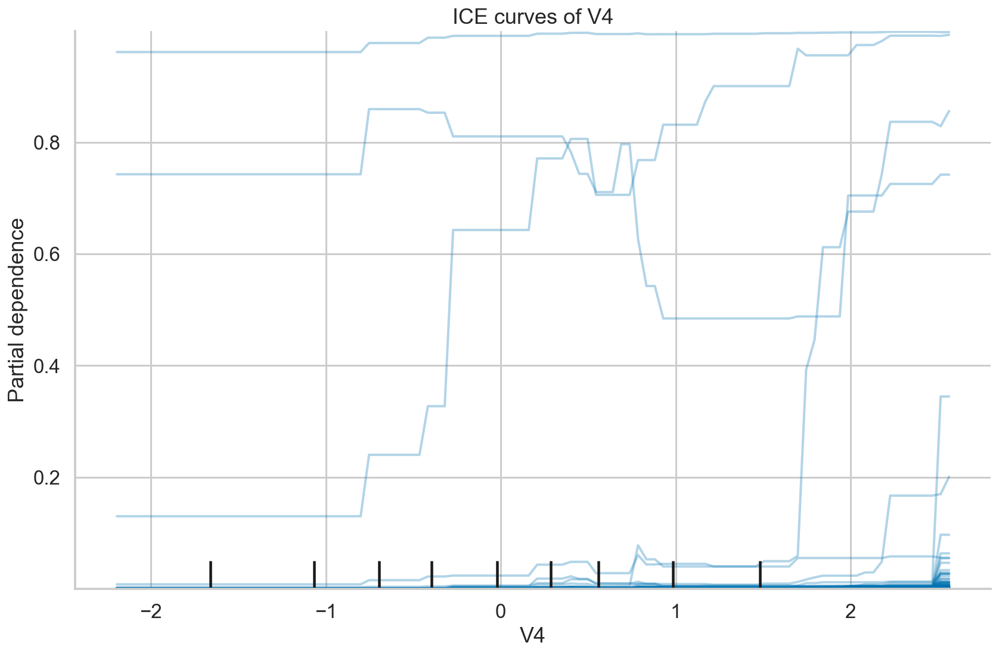

In [21]:
# PartialDependenceDisplay.from_estimator()를 사용하여 V4 특성에 대한 ICE 곡선 생성
# - xgb: 학습된 XGBoost 모델
# - X_train: 훈련 데이터
# - features=["V4"]: V4 특성에 대해 ICE 곡선 생성
# - kind="individual": 개별 ICE 곡선 표시
# - subsample=5000: 5000개의 랜덤 샘플 사용
# - line_kw: 선 두께 설정
# - random_state: 재현성을 위한 랜덤 시드 설정
PartialDependenceDisplay.from_estimator(
    xgb, X_train, features=["V4"], 
    kind="individual", 
    subsample=5000, 
    line_kw={"linewidth": 2},
    random_state=RANDOM_STATE
)

# 그래프 제목 설정
plt.title("ICE curves of V4")

# 그래프 레이아웃 조정
plt.tight_layout()

# 테두리 제거
sns.despine()
# plt.savefig("images/figure_14_35", dpi=200)

그림 14.35: 훈련 데이터에서 5,000개의 무작위 샘플을 사용하여 생성한 V4 특성의 ICE 플롯

플롯에서 대부분의 관측치가 0 주변에 위치해 있는 반면, 일부 곡선은 예측 확률에서 상당히 큰 변화를 보여줍니다. 플롯 하단의 검은색 표시는 특성값의 백분위수를 나타냅니다. 기본적으로 ICE 플롯과 PDP는 특성값의 5번째와 95번째 백분위수로 제한되지만, percentiles 인수를 사용하여 이를 변경할 수 있습니다. ICE 곡선의 잠재적인 문제점은 관측치마다 서로 다른 예측값에서 시작하기 때문에 곡선 간의 차이를 보기 어려울 수 있다는 것입니다. 이에 대한 해결책은 특정 지점에서 곡선의 중심을 맞추고 해당 지점과 비교한 예측의 차이만 표시하는 것입니다.

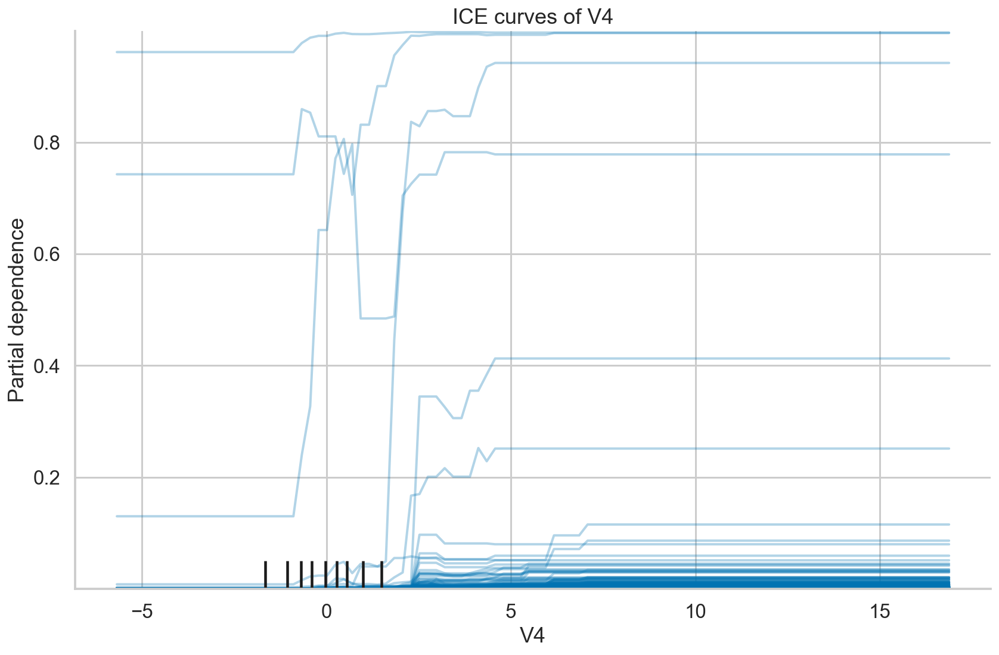

In [ ]:
PartialDependenceDisplay.from_estimator(
    xgb, X_train, features=["V4"], 
    kind="individual", 
    subsample=5000, 
    line_kw={"linewidth": 2},
    percentiles = (0,1),
    random_state=RANDOM_STATE
)
# plt.title("ICE curves of V4 - full range of the feature")

4. Plot the centered ICE curves:

**Step 4**에서는 동일한 ICE 곡선을 플로팅하지만, 이를 원점으로 중심을 맞춥니다. 이를 위해 `centered` 인수를 `True`로 설정합니다. 이는 목표 벡터에서 평균 목표 값을 빼서 목표 값을 0으로 중심에 맞추는 효과를 가져옵니다.

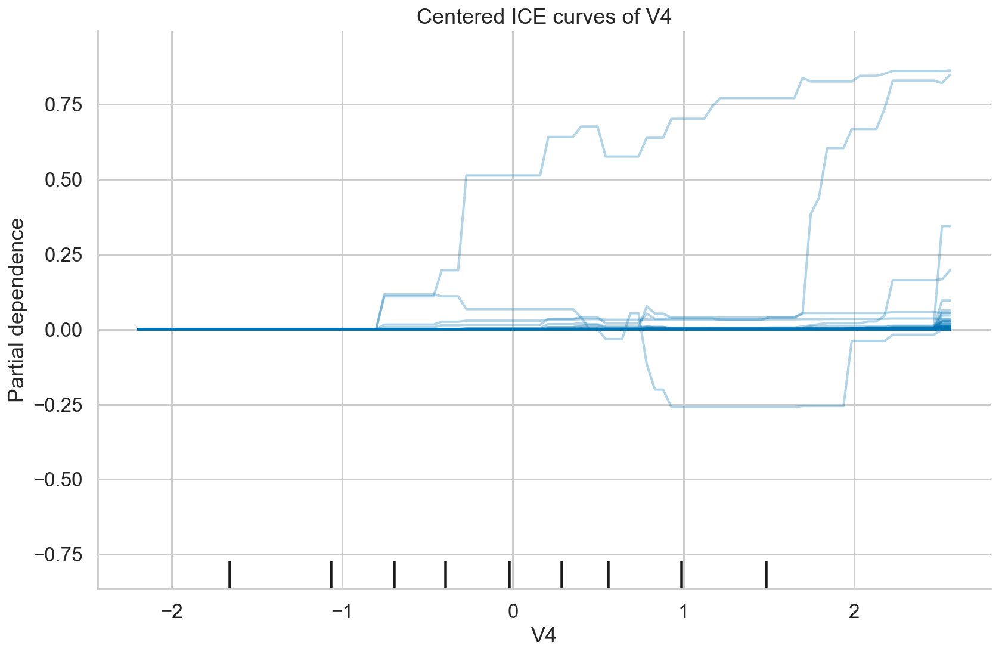

In [7]:
PartialDependenceDisplay.from_estimator(
    xgb, X_train, features=["V4"], 
    kind="individual", 
    subsample=5000,
    centered=True,
    line_kw={"linewidth": 2},
    random_state=RANDOM_STATE
)
plt.title("Centered ICE curves of V4")

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_36", dpi=200)

그림 14.36: 훈련 데이터에서 5,000개의 무작위 샘플을 사용하여 생성한 V4 특성의 중심화된 ICE 플롯
 
중심화된 ICE 곡선의 해석은 약간만 다릅니다. 특성값 변화가 예측에 미치는 영향을 보는 대신, 평균 예측값과 비교하여 예측값의 상대적인 변화를 살펴봅니다. 이러한 방식으로 예측값 변화의 방향을 분석하기가 더 쉬워집니다.

5. Generate the Partial Dependence Plot:

**Step 5**에서는 `PartialDependenceDisplay.from_estimator`를 사용하여 부분 종속 플롯을 플로팅합니다. PDP가 기본값이기 때문에 `kind` 인수를 지정할 필요가 없습니다. 또한, PDP와 ICE 곡선을 같은 그림에 모두 표시하는 결과도 보여줍니다. 양방향 PDP는 시간이 상당히 걸리기 때문에, 훈련 세트에서 중복 없이 20,000개의 관측치를 샘플링했습니다.

`PartialDependenceDisplay`에 대해 유념해야 할 한 가지는 범주형 기능을 숫자로 취급한다는 점입니다.

부분 종속 플롯은 `pdpbox` 라이브러리에서도 사용할 수 있습니다.

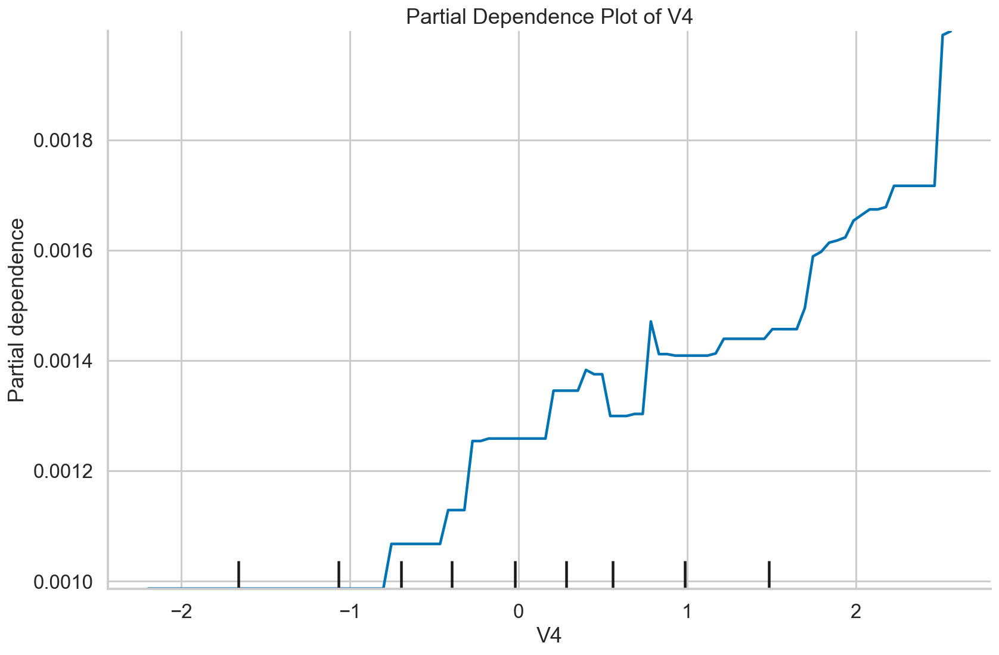

In [8]:
PartialDependenceDisplay.from_estimator(
    xgb, X_train, 
    features=["V4"], 
    random_state=RANDOM_STATE
)
plt.title("Partial Dependence Plot of V4")

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_37", dpi=200)

그림 14.37: 훈련 데이터를 사용하여 준비한 V4 특성의 부분 종속 플롯
 
플롯을 분석해보면, 평균적으로 V4 특성이 증가함에 따라 예측 확률이 매우 작게 증가하는 것으로 보입니다.
 
>ICE 곡선과 마찬가지로, PDP도 중심화할 수 있습니다.

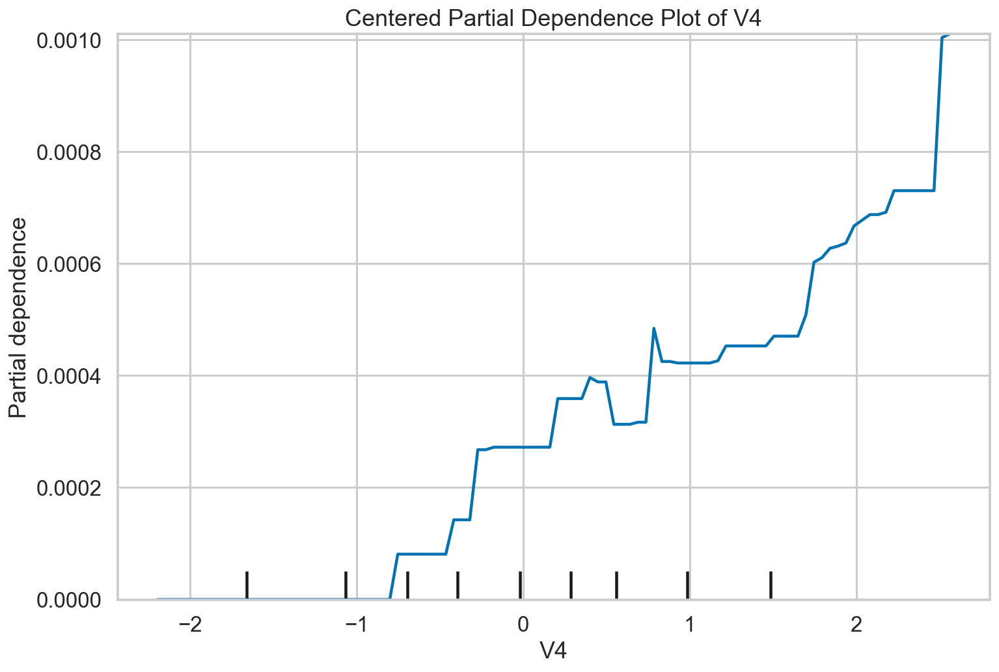

In [9]:
PartialDependenceDisplay.from_estimator(xgb, X_train, features=["V4"], 
                                        random_state=RANDOM_STATE, centered=True)
plt.title("Centered Partial Dependence Plot of V4");

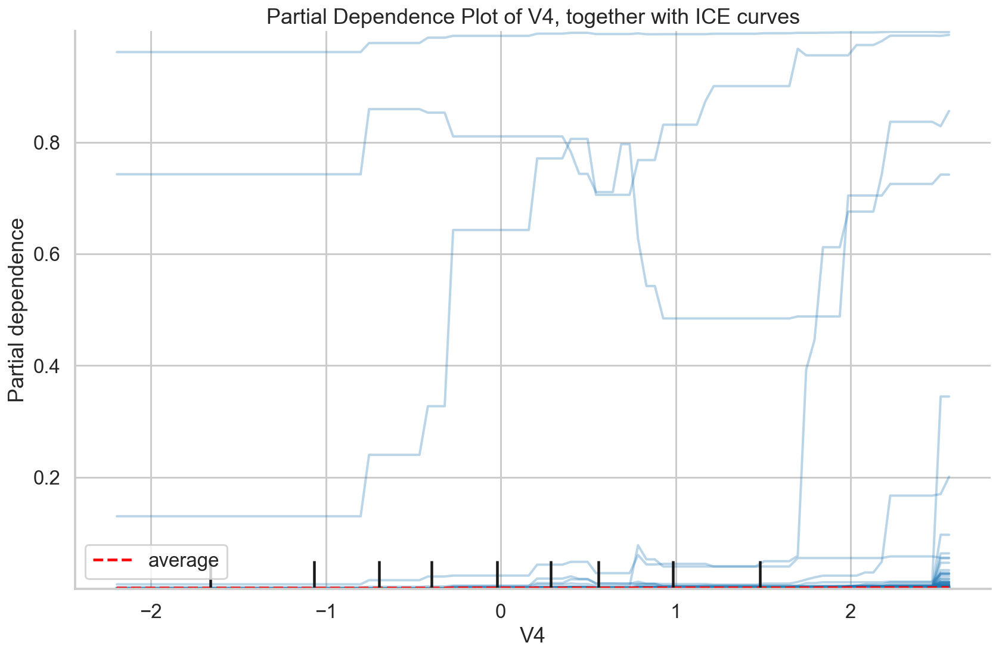

In [19]:
PartialDependenceDisplay.from_estimator(
    xgb, X_train, features=["V4"], 
    kind="both", 
    subsample=5000, 
    ice_lines_kw={"linewidth": 2},
    pd_line_kw={"color": "red"},
    random_state=RANDOM_STATE
)
# plt.ylim(0, 0.05)
plt.title("Partial Dependence Plot of V4, together with ICE curves")

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_38", dpi=200)

그림 14.38: 훈련 데이터를 사용하여 준비한 V4 특성의 부분 종속 플롯과 ICE 곡선
 
보시다시피 부분 종속(PD) 선은 0에서 거의 수평입니다. 스케일의 차이로 인해(그림 14.37 참조), 이러한 플롯에서 PD 선은 사실상 의미가 없습니다. 플롯을 더 읽기 쉽게 하거나 해석하기 쉽게 하기 위해서는 plt.ylim 함수를 사용하여 y축의 범위를 제한해볼 수 있습니다. 이렇게 하면 대다수의 ICE 곡선이 있는 영역에 초점을 맞추고, 곡선의 주요 부분에서 멀리 떨어진 소수의 곡선들은 무시할 수 있습니다. 하지만 이러한 이상치 곡선들도 분석에 중요하다는 점을 명심해야 합니다.

6. Generate the individual PDPs of two features and a joint one:

**Step 6**에서는 `PartialDependenceDisplay`의 동일한 기능을 사용하여 더 복잡한 그림을 만듭니다. 하나의 그림에서 두 개의 기능(V4와 V8)의 개별 PDP와 그들의 공동 PDP(양방향 PDP라고도 함)를 플로팅합니다. 마지막 PDP를 얻기 위해 관심 있는 두 기능을 튜플로 제공해야 했습니다. `features=["V4", "V8", ("V4", "V8")]`로 지정하여 두 개의 개별 PDP와 두 기능의 공동 PDP를 모두 플로팅하도록 지시했습니다. 물론, 세 가지 플롯을 동일한 그림에 모두 플로팅할 필요는 없습니다. `features=[("V4", "V8")]`를 사용하여 공동 PDP만 생성할 수도 있었습니다.

또한 흥미로운 탐구 방향으로는, 동일한 기능에 대해 다른 ML 모델을 사용하여 두 개의 부분 종속 플롯을 오버레이하여 비교할 수 있습니다. 이를 통해 예측에 대한 예상 영향을 다양한 모델에서 비교할 수 있습니다.

ICE 곡선과 부분 종속선을 플로팅하는 것에 중점을 두었지만, 값을 자동으로 플로팅하지 않고 계산할 수도 있습니다. 이를 위해 `partial_dependence` 함수를 사용할 수 있습니다. 이 함수는 그리드의 모든 지점에 대한 평가된 그리드, 데이터셋의 모든 샘플에 대한 예측(ICE 곡선에 사용), 그리고 모든 샘플에 대한 예측의 평균값(PDP에 사용)을 포함하는 사전을 반환합니다.

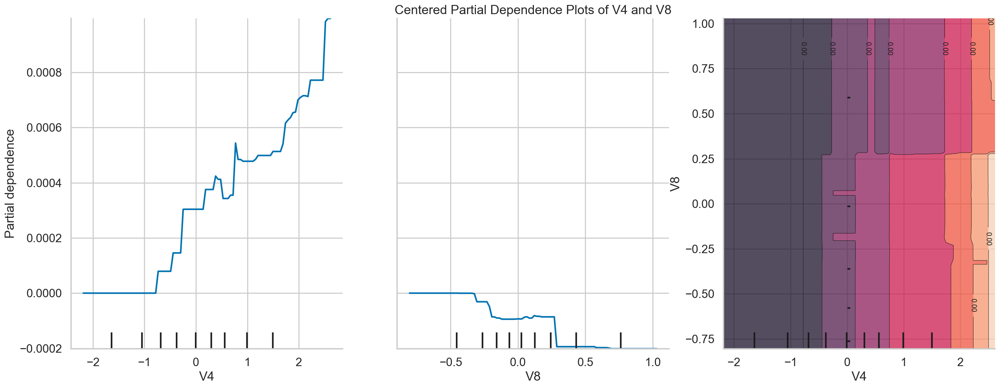

In [8]:
fig, ax = plt.subplots(figsize=(20, 8))

PartialDependenceDisplay.from_estimator(
    xgb,
    X_train.sample(20000, random_state=RANDOM_STATE),
    features=["V4", "V8", ("V4", "V8")],
    centered=True,
    ax=ax
)
ax.set_title("Centered Partial Dependence Plots of V4 and V8")

plt.tight_layout()
sns.despine()
# plt.savefig("images/figure_14_39", dpi=200)

그림 14.39: V4와 V8 특성의 중심화된 부분 종속 플롯(개별 및 결합)
 
두 특성의 PDP를 함께 플로팅함으로써 특성들 간의 상호작용을 시각화할 수 있습니다. 그림 14.39를 보면 V4 특성이 더 중요하다는 결론을 내릴 수 있습니다. 가장 오른쪽 플롯에서 볼 수 있는 대부분의 선들이 V4 축에 수직이고 V8 축에 평행하기 때문입니다. 하지만 V8 특성에 의해 결정되는 결정선에도 약간의 변화가 있습니다. 예를 들어 0.25 값 주변에서 이러한 변화가 나타납니다.

7. Instantiate an explainer and calculate the SHAP values:

**Step 7**에서는 설명을 위한 주된 클래스로, `shap` 라이브러리를 사용하여 `explainer` 객체를 인스턴스화합니다. 더 구체적으로는, XGBoost 모델을 설명하려고 하므로 `TreeExplainer` 클래스를 사용합니다. 그런 다음, `explainer` 객체의 `shap_values` 메서드를 사용하여 SHAP 값을 계산합니다. 모델 예측을 설명하기 위해 전체 데이터셋을 사용합니다. 이 시점에서는 훈련 또는 검증/테스트 세트를 사용할 수도 있었습니다.

정의에 따라, SHAP 값은 계산이 매우 복잡한 문제(NP-하드 문제)입니다. 그러나 선형 모델의 단순성 덕분에, 부분 종속 플롯에서 SHAP 값을 읽을 수 있습니다. 이 주제에 대한 추가 정보는 `shap`의 문서를 참조하십시오.

In [10]:
# TreeExplainer 객체를 생성하여 XGBoost 모델을 설명할 수 있게 함
explainer = shap.TreeExplainer(xgb)

# 전체 데이터셋 X에 대한 SHAP 값을 계산
# 이는 각 특성이 모델의 예측에 미치는 영향을 수치화함
shap_values = explainer.shap_values(X)

# explainer 객체를 사용하여 데이터셋 X에 대한 설명자를 생성
# 이를 통해 추가적인 SHAP 분석이 가능해짐
explainer_x = explainer(X)

In [11]:
shap_values.shape

(284807, 29)

In [12]:
# it might be required to run this command before creating the plots
shap.initjs()

8. Generate the SHAP summary plot:

**Step 8**에서는 글로벌 설명 접근 방식으로 시작하여 `shap.summary_plot` 함수를 사용하여 요약 플롯의 두 가지 변형을 만듭니다. 첫 번째는 각 기능에 대한 SHAP 값의 밀도 산점도입니다. 이는 전체 기능 중요도를 기능 효과와 결합하여 보여줍니다. 두 번째는 전체 데이터셋에 걸쳐 SHAP 값의 평균을 보여주는 막대 그래프입니다. 두 경우 모두 `shap.summary_plot` 함수를 호출할 때 `plot_type="bar"`을 추가로 전달하여 기능 중요도를 추론할 수 있습니다.

글로벌 설명을 확인한 후, 분석을 더 흥미롭게 만들기 위해 음성 및 양성 클래스에 속하는 관측치에 대한 설명을 제시하려고 합니다. 그래서 **Step 9**에서는 이러한 관측치의 인덱스를 식별합니다.

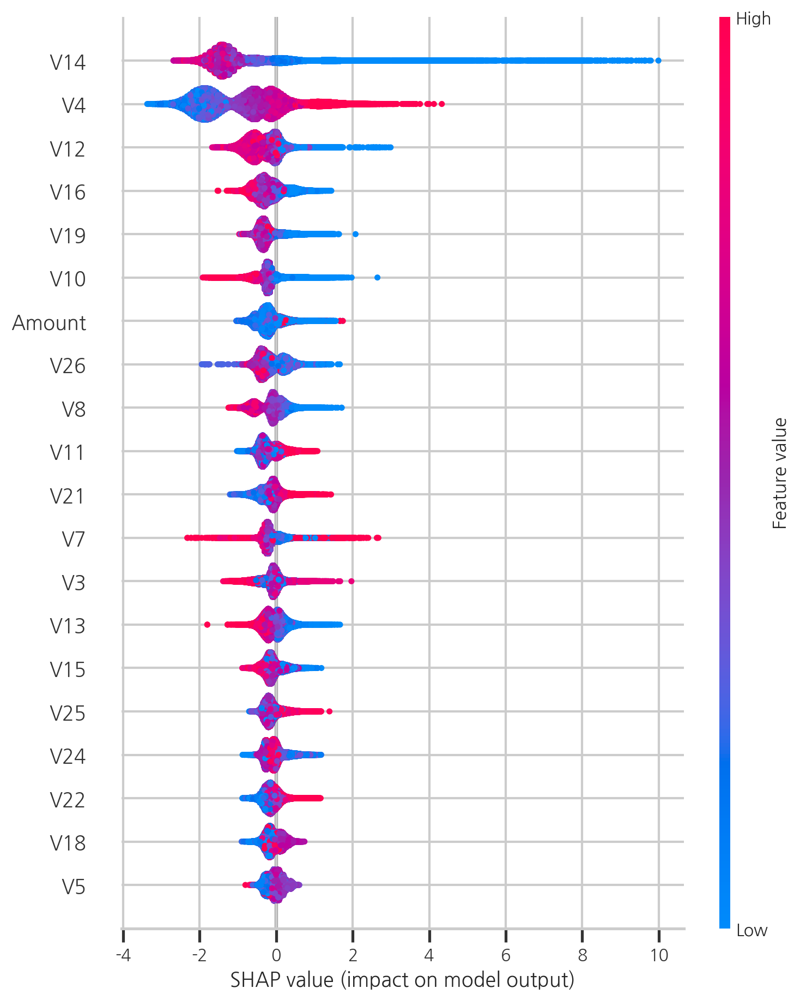

In [13]:
shap.summary_plot(shap_values, X);

Figure 14.40: The summary plot calculated using SHAP values 

요약 플롯을 볼 때, 다음 사항을 염두에 두어야 합니다:

- 피처들은 모든 관측치에 걸쳐 SHAP 값 크기(절대값)의 합으로 정렬됩니다.
- 점의 색상은 해당 관측치에서 해당 피처이 높은 값인지 낮은 값인지를 나타냅니다.
- 플롯의 수평 위치는 해당 피처의 값이 더 높은 예측 또는 더 낮은 예측을 유도했는지 여부를 나타냅니다.
- 기본적으로, 플롯은 상위 20개의 중요한 피처을 표시합니다. `max_display` 인수를 사용하여 조정할 수 있습니다.
- 겹치는 점들은 y축 방향으로 약간 이동됩니다. 따라서 각 피처에 대한 SHAP 값의 분포를 파악할 수 있습니다.
- 이러한 유형의 플롯이 다른 기피처 중요도 메트릭(예: 순열 중요도)보다 가지는 장점 중 하나는 글로벌 피처 중요도를 이해하는 데 도움이 되는 더 많은 정보를 포함한다는 점입니다. 예를 들어, 어떤 피처이 중간 정도의 중요도를 갖는다고 가정했을 때, 이 플롯을 사용하면 해당 피처 값이 일부 관측치에서는 예측에 큰 영향을 미치지만, 일반적으로는 영향이 거의 없거나, 모든 예측에 중간 정도의 영향을 미쳤는지 확인할 수 있습니다.

전체적인 고려 사항을 논의한 후, **그림 14.40**에서 몇 가지 관찰을 언급해 보겠습니다:

- 전반적으로, V4 피처(가장 중요한 피처)의 값이 높으면 더 높은 예측으로 이어졌고, 값이 낮으면 더 낮은 예측(해당 관측치가 사기일 가능성이 낮음을 의미)으로 이어졌습니다.
- V14 피처의 예측에 대한 전체적인 영향은 음수였지만, 해당 피처 값이 낮은 일부 관측치에서는 더 높은 예측으로 이어졌습니다.

대안적으로, 동일한 정보를 막대 그래프를 사용하여 제시할 수 있습니다. 그런 다음, 피처 효과에 대한 인사이트는 무시한 채로 집계된 피처 중요도에 집중합니다.

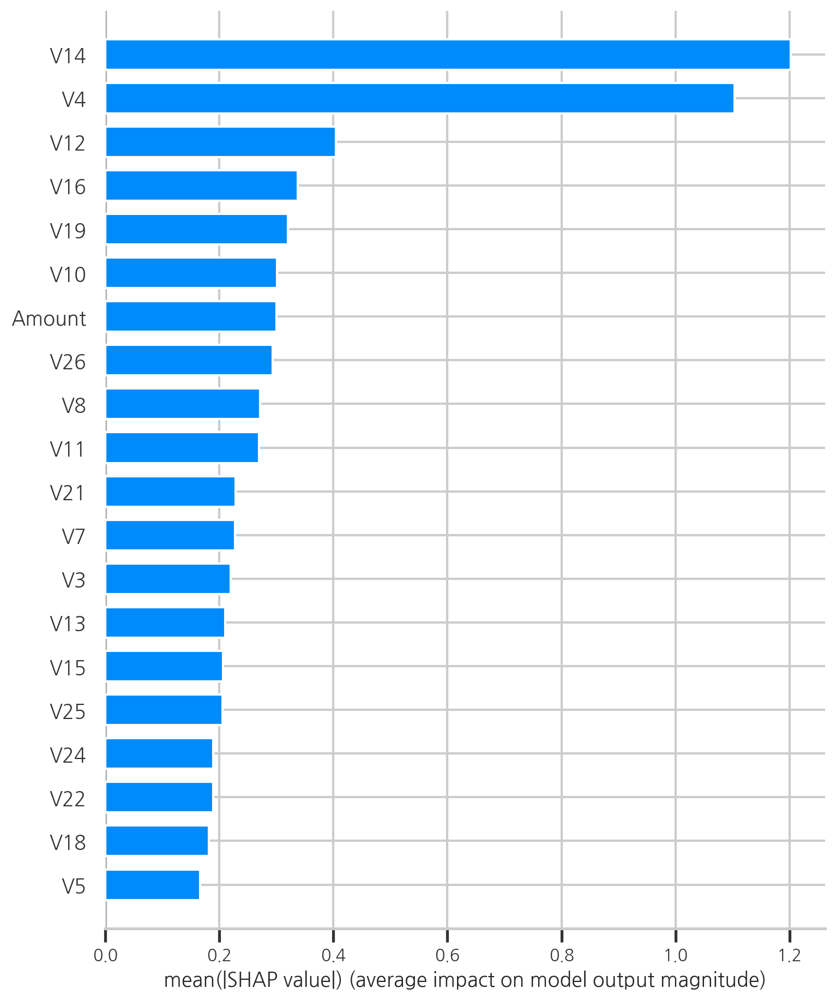

In [14]:
shap.summary_plot(shap_values, X, plot_type="bar");

그림 14.41: SHAP 값을 사용하여 계산된 요약 플롯(막대 차트)
 
당연히 피처들의 순서(중요도)는 그림 14.40과 동일합니다. 이 플롯을 순열 기능 중요도의 대안으로 사용할 수 있습니다. 하지만 그럴 경우 근본적인 차이점을 염두에 두어야 합니다. 순열 피처 중요도는 모델 성능의 감소(선택한 메트릭을 사용하여 측정)를 기반으로 하는 반면, SHAP는 기능 귀속의 크기를 기반으로 합니다.

>다음 명령을 사용하면 요약 차트를 더욱 간결하게 표현할 수 있습니다: shap.plots.bar(explainer_x).

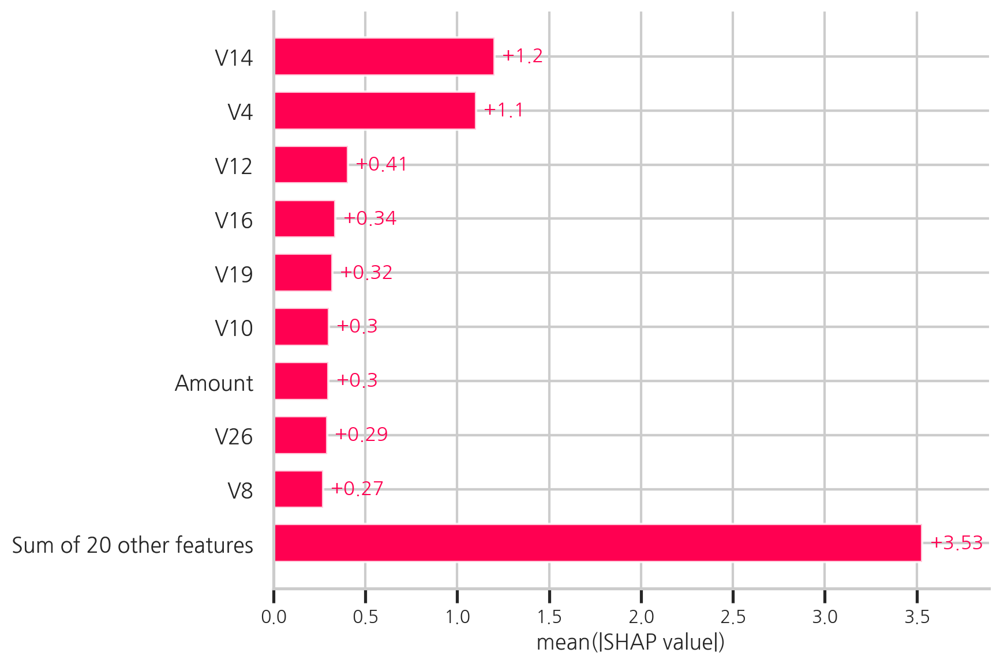

In [15]:
shap.plots.bar(explainer_x)

9. Locate an observation belonging to the positive and negative class:

단일 예측 설명하기
 
작고 간단하게 시작해보겠습니다. SHAP를 사용하면 단일 예측에 대한 설명을 생성할 수 있습니다. SHAP 플롯은 기본값(평균 모델 출력)에서 실제 예측값으로 출력을 밀어내는 데 기여하는 특성들을 보여줍니다.

빨간색은 예측을 더 높게 밀어내는 특성들을 나타내고, 파란색은 그 반대를 나타냅니다.

In [17]:
# 음성 클래스(y=0)에 속하는 첫 번째 관측치의 인덱스 찾기
negative_ind = y[y == 0].index[0]
# 양성 클래스(y=1)에 속하는 첫 번째 관측치의 인덱스 찾기 
positive_ind = y[y == 1].index[0]

10. Explain those observations:

**Step 10**에서는 `shap.force_plot`을 사용하여 두 관측치의 예측에 대한 관측치 수준의 설명을 수행합니다. 함수를 호출할 때 다음 세 가지 입력을 제공해야 했습니다:

- 기본값(전체 데이터셋에 대한 평균 예측값)은 explainer 객체에서 사용할 수 있는 값입니다 (`explainer.expected_value`)
- 특정 관측치에 대한 SHAP 값
- 특정 관측치의 기능 값

In [18]:
# 음성 클래스 관측치에 대한 SHAP force plot 생성
# explainer.expected_value: 전체 데이터셋의 평균 예측값
# shap_values[negative_ind, :]: 음성 클래스 관측치의 SHAP 값
# X.iloc[negative_ind, :]: 음성 클래스 관측치의 특성값
shap.force_plot(
    explainer.expected_value, 
    shap_values[negative_ind, :], 
    X.iloc[negative_ind, :]
)

그림 14.42: 음성 클래스에 속하는 관측치를 설명하는 (축약된) 포스 플롯

간단히 말해, 포스 플롯(force plot)은 기능들이 기본값(평균 예측값)에서 실제 예측값으로 예측을 이동시키는 데 어떻게 기여하는지 보여줍니다. 플롯에 더 많은 정보가 포함되어 있고 페이지에 맞추기에는 너무 넓었기 때문에 가장 관련성 있는 부분만 제시했습니다. 전체 플롯을 확인하려면 동반된 Jupyter 노트북을 참조하십시오.

아래는 **그림 14.42**를 기반으로 한 몇 가지 관찰 사항입니다:

- 기본값(-8.589)은 전체 데이터셋의 평균 예측값입니다.
- \( f(x) = -13.37 \)은 이 관측값의 예측값입니다.
- 화살표는 주어진 예측에 대한 각 기능의 영향을 나타낼 수 있습니다. 빨간색 화살표는 예측 증가를, 파란색 화살표는 예측 감소를 나타냅니다. 화살표의 크기는 기능의 영향 크기에 대응합니다. 기능 이름 옆의 값은 기능 값들을 보여줍니다.
- 빨간색 화살표의 총 길이에서 파란색 화살표의 총 길이를 빼면, 기본값에서 최종 예측까지의 거리를 구할 수 있습니다.
- 따라서 예측 감소에 가장 큰 기여를 한 기능(평균 예측과 비교했을 때)은 값이 -0.3112인 V14 기능이었습니다.

이후 동일한 단계를 양의 관측값에 대해서도 따릅니다.

In [19]:
explainer.expected_value

-8.422197

In [20]:
shap.force_plot(
    explainer.expected_value, 
    shap_values[positive_ind, :], 
    X.iloc[positive_ind, :]
)

그림 14.43: 양성 클래스에 속하는 관측치를 설명하는 (축약된) 포스 플롯
 
그림 14.42와 비교했을 때, 파란색 특성(예측에 부정적인 영향을 미치며 낮게 표시됨)이 빨간색 특성(높게 표시됨)에 비해 얼마나 불균형한지 명확하게 볼 수 있습니다. 또한 두 그림 모두 데이터셋의 평균 예측값인 동일한 기준값을 가지고 있음을 알 수 있습니다.

11. Create a waterfall plot for the positive observation:

**Step 11**에서는 관측치 수준의 예측을 설명하는 또 다른 플롯도 생성합니다. 다만, 약간 다른 표현 방식을 사용합니다. 양성 관측치를 설명하기 위해 워터폴 플롯(`shap.plots.waterfall` 함수 사용)을 생성합니다. 여기서 언급할 만한 유일한 점은 함수가 `Explanation` 객체의 한 행을 입력으로 기대한다는 것입니다.


/home/restful3/anaconda3/envs/ml4t/lib/python3.12/site-packages/shap/plots/_waterfall.py:237: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  text_bbox = txt_obj.get_window_extent(renderer=renderer)
/home/restful3/anaconda3/envs/ml4t/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


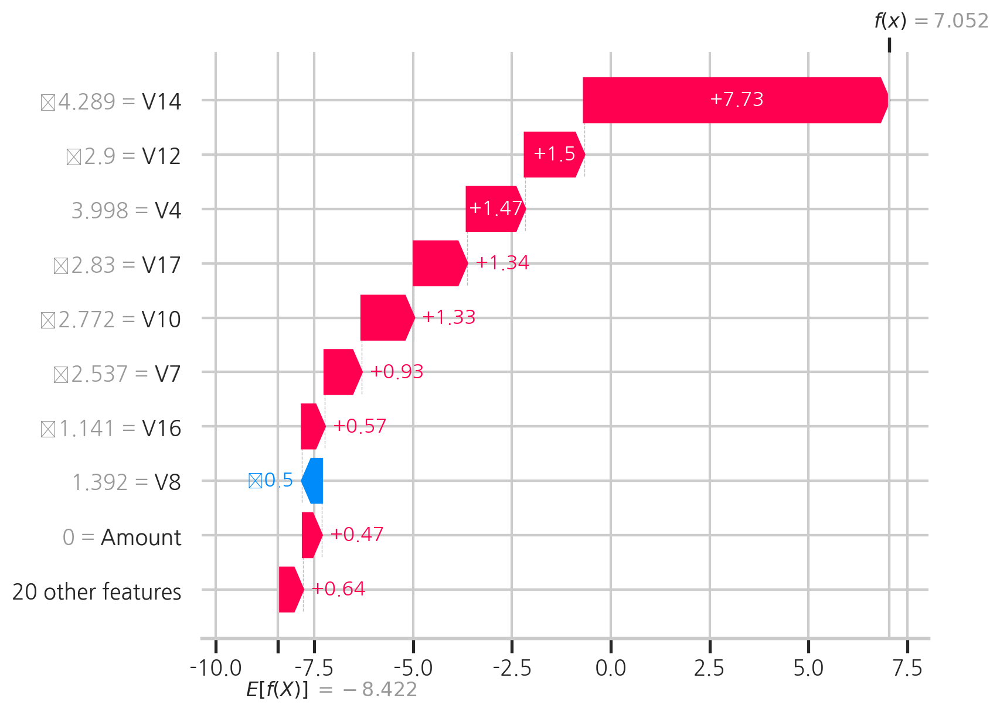

In [21]:
# 양성 클래스에 속하는 관측치에 대한 워터폴 플롯 생성
shap.plots.waterfall(explainer(X)[positive_ind])
# shap.plots.waterfall(explainer(X)[positive_ind], max_display=30)

Figure 14.44: A waterfall plot explaining an observation from the positive class

**그림 14.44**를 살펴보면, **그림 14.43**과 많은 유사점을 발견할 수 있습니다. 두 플롯 모두 약간 다른 시각화를 사용하여 동일한 관측치를 설명하고 있습니다. 따라서, 워터폴 플롯을 해석할 때 얻을 수 있는 대부분의 통찰은 포스 플롯과 동일합니다. 몇 가지 미묘한 차이는 다음과 같습니다:

- 플롯의 하단은 기준값(모델의 평균 예측)에서 시작합니다. 그런 다음, 각 행은 해당 관측치에 대한 모델의 최종 예측으로 이어지는 각 피처의 긍정적 또는 부정적 기여를 보여줍니다.
- SHAP는 XGBoost 분류기를 마진 출력 기준으로 설명합니다. 이는 x축의 단위가 로그 오즈(log-odds) 단위임을 의미합니다. 음수 값은 해당 관측치가 사기일 확률이 0.5보다 낮음을 나타냅니다.
- 영향이 가장 적은 기능들은 공동 항목으로 축소됩니다. 우리는 함수의 `max_display` 인수를 사용하여 이를 조절할 수 있습니다.

>로그 오즈(log-odds)는 확률을 오즈(odds)로 변환한 후 자연로그를 취한 값입니다.
>예를 들어 사기 확률이 0.8이면 오즈는 4(=0.8/0.2)이고 로그 오즈는 ln(4)=1.386입니다.


12. Create a dependence plot of the `V4` feature:

마지막 단계에서는 `shap.dependence_plot` 함수를 사용하여 SHAP 의존 플롯(전역 수준 설명)을 생성합니다. 관심 있는 기능, SHAP 값, 그리고 기능 값을 제공해야 했습니다. 선택한 기능으로는 요약 플롯에서 가장 중요한 기능으로 확인된 V4를 사용했고, 두 번째 기능(V12)은 라이브러리에서 자동으로 결정되었습니다.

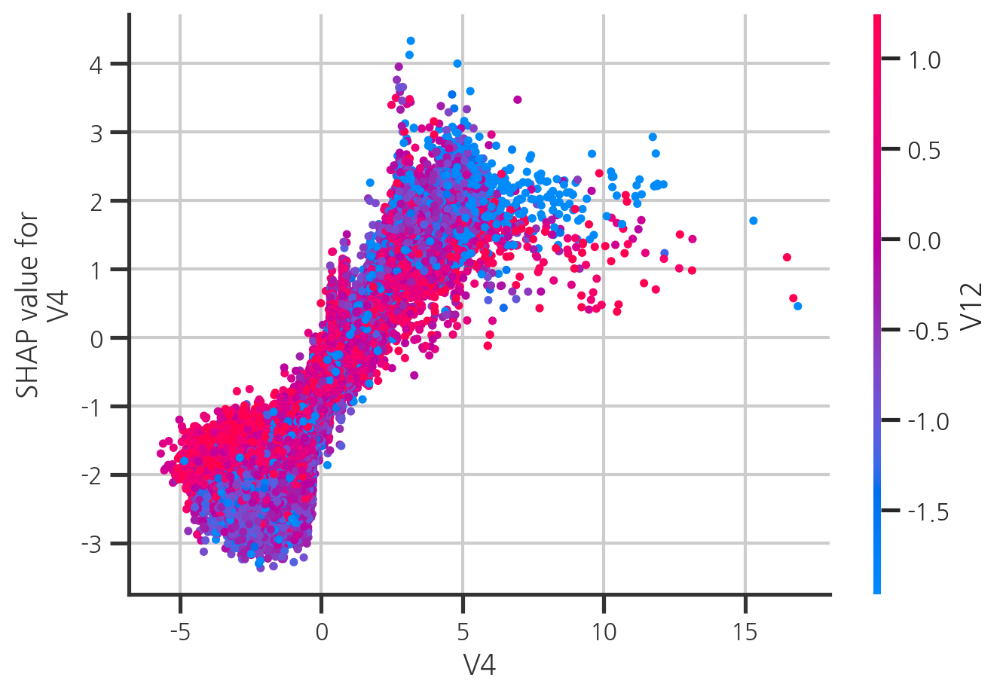

In [23]:
shap.dependence_plot("V4", shap_values, X)

Figure 14.45: A dependence plot visualizing the dependence between the V4 and V12 features

의존 플롯에 대해 알아야 할 몇 가지 사항:

- 잠재적으로 가장 간단한 전역 해석 플롯입니다.
- 이 플롯 유형은 부분 종속 플롯(Partial Dependence Plots, PDPs)의 대안입니다. PDP는 평균 효과를 보여주는 반면, SHAP 의존 플롯은 y축의 분산을 추가로 보여주어 효과의 분포에 대한 정보를 제공합니다.
- 플롯은 기능의 값(x축)과 해당 기능의 SHAP 값(y축)을 데이터셋의 모든 관측치에 대해 나타냅니다. 각 점은 개별 관측치를 나타냅니다.
- XGBoost 분류 모델을 설명하고 있으므로, y축의 단위는 사기일 확률의 로그 오즈(log odds)입니다.
- 색상은 지정한 기능과의 상호작용 효과가 있을 수 있는 두 번째 기능에 해당합니다. 이는 `shap` 라이브러리에 의해 자동으로 선택됩니다. 문서에서는 두 기능 간에 상호작용 효과가 존재할 경우, x축의 동일한 값에서 색상 간의 뚜렷한 수직 분포로 나타날 것이라고 설명하고 있습니다.

분석을 완료하기 위해, **그림 14.45**에서 잠재적인 결론을 언급할 수 있습니다. 불행히도, 해당 기능들이 익명화되었기 때문에 직관적으로 이해하기는 어려울 것입니다.

예를 들어, V4 기능의 값이 약 5인 관측치를 살펴봅시다. 해당 샘플들에서 V12 기능의 값이 낮을수록 사기일 가능성이 높고, 값이 높을수록 사기일 가능성이 낮음을 알 수 있습니다.

### There's more

이 레시피에서는 XAI(설명 가능한 인공지능) 분야의 단면만을 다룹니다. 설명 가능한 방법들이 점점 더 중요해지면서, XAI 분야는 꾸준히 성장하고 있으며 전문가와 비즈니스에 중요하게 작용하고 있습니다.

또 다른 인기 있는 XAI 기법으로 LIME이 있습니다. LIME은 **모델 불가지론적 설명을 위한 지역 해석 모델(Local Interpretable Model-Agnostic Explanations)**을 의미합니다. LIME은 설명이 어려운 모델을 해석 가능한 모델(예: 규제화된 선형 모델)로 근사하여 모델의 예측을 설명하는 데 사용됩니다. 설명을 얻기 위해, LIME은 원본 관측치에 소량의 노이즈를 추가하여 소규모의 변형된 데이터를 사용해 로컬 근사를 제공합니다.

**Treeinterpreter**는 랜덤 포레스트 모델을 설명하는 데 유용한 관측치 수준의 또 다른 XAI 방법입니다. 이 방법의 핵심은 각 기능이 최종 결과에 얼마나 기여하는지를 설명하기 위해 모델의 나무 구조를 사용하는 것입니다. 예측값은 각 기능의 기여도와 전체 훈련 세트를 기반으로 하는 초기 노드의 평균값의 합으로 정의됩니다. 이 접근 방식을 통해, 의사결정 트리 내에서 예측 경로(각 분할 이후)를 따라 예측값이 어떻게 변화하는지와 어떤 기능이 분할을 유발했는지를 관찰할 수 있습니다. 즉, 예측의 변화를 확인할 수 있습니다.

자연스럽게, 사용할 수 있는 많은 다른 접근 방식이 있습니다. 예를 들어:

- Ceteris-paribus 프로파일
- 분해(브레이크다운) 플롯
- 누적 지역 효과(ALE)
- 글로벌 대리 모델
- 반사실적(가상) 설명
- 앵커

다음과 같은 AI 설명 가능성에 중점을 둔 Python 라이브러리를 조사해 보기를 권장합니다:

- **shapash** — SHAP/LIME에서 다양한 시각화를 대시보드 형태의 웹 애플리케이션으로 구성합니다.
- **explainerdashboard** — scikit-learn과 호환되는 ML 모델을 설명하는 대시보드 웹 애플리케이션을 준비합니다. 대시보드는 모델 성능, 기능 중요도, 개별 예측에 대한 기능 기여도, 개별 의사결정 트리 등을 다룹니다.
- **dalex** — 이 라이브러리는 다양한 XAI 방법을 포함하며, 기능 중요도, PDP 및 ALE 플롯, 브레이크다운 및 SHAP 워터폴 플롯, "what if" 분석, SHAP 값, 개별 결정 트리 시각화 등을 제공합니다.
- **interpret** — Microsoft에서 만든 InterpretML 라이브러리로, 블랙박스 모델의 인기 있는 설명 방법(PDP, SHAP, LIME 등)을 다루며 해석 가능한 모델도 훈련할 수 있게 합니다. 예를 들어, **ExplainableBoostingClassifier**는 완전히 해석 가능하게 설계되었으면서도 최신 알고리즘과 유사한 정확성을 제공합니다.
- **eli5** — 다양한 글로벌 및 로컬 설명을 제공하는 설명 라이브러리로, 텍스트 설명(LIME에 의해 제공됨) 및 순열 기능 중요도도 포함합니다.
- **alibi** — 모델 검사와 해석에 중점을 둔 라이브러리로, 앵커 설명, 통합 기울기, 반사실적 예제, 대조 설명 방법, 누적 지역 효과 등 다양한 접근 방식을 포함합니다.

In [ ]:
dependence_dict = partial_dependence(rf, X_train, "V17", kind="both")
dependence_dict.keys()

dict_keys(['average', 'individual', 'values'])

In [ ]:
dependence_dict["average"]

array([[0.00188321, 0.00188321, 0.00188321, 0.00188321, 0.00188229,
        0.0022492 , 0.00165529, 0.00164213, 0.00164037, 0.00163787,
        0.00163629, 0.00163629, 0.00163537, 0.00163537, 0.00163497,
        0.00163497, 0.00163453, 0.00163409, 0.00163335, 0.00162966,
        0.00162909, 0.00162909, 0.00162909, 0.00162909, 0.00162909,
        0.00162909, 0.00161224, 0.00160311, 0.00160311, 0.00160311,
        0.00160311, 0.00160311, 0.00160311, 0.00160311, 0.00160258,
        0.00160258, 0.00160258, 0.00160258, 0.00160197, 0.00160197,
        0.00160258, 0.00160333, 0.00160205, 0.00160144, 0.00160113,
        0.00160113, 0.00160131, 0.00160135, 0.00160205, 0.00160333,
        0.00160302, 0.00160236, 0.00160249, 0.00160618, 0.00161017,
        0.00160715, 0.0016132 , 0.00161325, 0.00161373, 0.00161136,
        0.00161171, 0.00161171, 0.00161171, 0.00161184, 0.00161926,
        0.00161987, 0.00162198, 0.0016333 , 0.00171656, 0.00164682,
        0.00165288, 0.00165161, 0.00166354, 0.00

In [ ]:
dependence_dict["individual"].shape

(1, 227845, 100)

In [ ]:
dependence_dict["values"]

[array([-0.98213146, -0.95935212, -0.93657278, -0.91379343, -0.89101409,
        -0.86823475, -0.84545541, -0.82267607, -0.79989672, -0.77711738,
        -0.75433804, -0.7315587 , -0.70877936, -0.68600002, -0.66322067,
        -0.64044133, -0.61766199, -0.59488265, -0.57210331, -0.54932397,
        -0.52654462, -0.50376528, -0.48098594, -0.4582066 , -0.43542726,
        -0.41264791, -0.38986857, -0.36708923, -0.34430989, -0.32153055,
        -0.29875121, -0.27597186, -0.25319252, -0.23041318, -0.20763384,
        -0.1848545 , -0.16207515, -0.13929581, -0.11651647, -0.09373713,
        -0.07095779, -0.04817845, -0.0253991 , -0.00261976,  0.02015958,
         0.04293892,  0.06571826,  0.0884976 ,  0.11127695,  0.13405629,
         0.15683563,  0.17961497,  0.20239431,  0.22517366,  0.247953  ,
         0.27073234,  0.29351168,  0.31629102,  0.33907036,  0.36184971,
         0.38462905,  0.40740839,  0.43018773,  0.45296707,  0.47574641,
         0.49852576,  0.5213051 ,  0.54408444,  0.5

### See also

추가 자료는 아래에서 확인할 수 있습니다:

- Biecek, P., & Burzykowski, T. 2021. *설명 가능한 모델 분석: 예측 모델 탐색, 설명 및 검사*. Chapman and Hall/CRC.
- Friedman, J. H. 2001. "탐욕스러운 기능 추정: 순차적 부스팅 머신". *Annals of Statistics*, 1189–1232.
- Goldstein, A., Kapelner, A., Bleich, J., & Pitkin, E. 2015. "블랙박스 내부 살펴보기: 개별 조건 기대의 통계적 학습 시각화". *Journal of Computational and Graphical Statistics*, 24(1): 44–65.
- Hastie, T., Tibshirani, R., Friedman, J. H., & Friedman, J. H. 2009. *통계적 학습의 요소: 데이터 마이닝, 추론 및 예측*, 2: 1–758. 뉴욕: Springer.
- Lundberg, S. M., Erion, G., Chen, H., DeGrave, A., Prutkin, J. M., Nair, B., … & Lee, S. I. 2020. "트리 모델의 설명 가능한 AI와 일관된 개별화된 기능 속성 부여". *Nature Machine Intelligence*, 2(1): 56–67.
- Lundberg, S. M., Erion, G. G., & Lee, S. I. 2018. "트리 앙상블의 일관된 개별화된 기능 속성 부여". arXiv preprint arXiv:1802.03888.
- Lundberg, S. M., & Lee, S. I. 2017. "모델 예측을 통합하여 설명하기 위한 통합 접근 방식". *Advances in Neural Information Processing Systems*, 30.
- Molnar, C. 2020. *해석 가능한 기계 학습*. [https://christophm.github.io/interpretable-ml-book/](https://christophm.github.io/interpretable-ml-book/)
- Ribeiro, M.T., Singh, S., & Guestrin, C. 2016. "왜 당신을 신뢰해야 하는가? 분류기 예측을 설명하기". *제22회 ACM SIGKDD 국제 지식 발견 및 데이터 마이닝 컨퍼런스 논문집*. ACM.
- Saabas, A. *랜덤 포레스트 해석하기*. [http://blog.datadive.net/interpreting-random-forests/](http://blog.datadive.net/interpreting-random-forests/)

## Summary

이 장에서는 대부분의 ML 또는 DL 프로젝트를 개선하는 데 도움이 될 다양한 주제를 다룹니다. 더 복잡한 분류기를 탐색하고(회귀 문제에 대한 변형도 포함), 범주형 기능 인코딩, 스태킹 앙상블 생성, 클래스 불균형 문제에 대한 가능한 해결책을 고려하는 것에서 시작합니다. 또한 하이퍼파라미터 튜닝을 위한 베이즈 접근 방식을 통해 비효율적이지만 널리 사용되는 비알림 그리드 검색 방법보다 최적의 하이퍼파라미터 세트를 더 빠르게 찾는 방법도 보여줍니다.

또한 기능 중요도와 AI 해석 가능성 주제도 다룹니다. 이를 통해 소위 블랙박스 모델에서 무슨 일이 일어나는지 더 잘 이해할 수 있습니다. 이는 ML/DL 프로젝트 작업자뿐만 아니라 비즈니스 이해관계자에게도 중요한 주제입니다. 추가적으로, 기능 선택 통찰을 결합하여 모델 성능을 더욱 향상하거나 학습 시간을 줄일 수도 있습니다.

데이터 과학 분야는 지속적으로 성장하며 매일 새로운 유용한 도구들이 등장하고 있습니다. 이 책에서 모든 도구를 다룰 수는 없지만, 아래에는 프로젝트에 유용할 수 있는 몇 가지 라이브러리/도구 목록이 있습니다:

- **DagsHub** — GitHub과 유사한 플랫폼으로, 데이터 과학자 및 기계 학습 실무자를 위해 특화되었습니다. Git, DVC, MLflow 및 Label Studio와 같은 오픈 소스 도구를 통합하여, 사용자가 ML 프로젝트를 구축, 관리 및 확장할 수 있도록 지원합니다.
- **deepchecks** — ML 모델 및 데이터를 테스트하기 위한 오픈 소스 Python 라이브러리입니다. 데이터의 무결성을 확인하고, 기능과 목표의 분포를 검사하며, 유효한 데이터 분할을 확인하고, 모델 성능을 평가할 수 있습니다.
- **DVC** — 오픈 소스 데이터 버전 관리 시스템으로, 다양한 버전의 데이터(표 형식, 이미지 등) 및 모델을 Git에 저장할 수 있습니다. AWS, GCS, Google Drive 등을 이용한 외부 저장소를 사용해 데이터의 중간 버전을 저장하며, Git과 동일한 문법을 사용합니다.
- **MLflow** — 기계 학습의 실험, 재현성, 배포 및 모델 레지스트리를 다루는 오픈 소스 플랫폼입니다.
- **nannyML** — 데이터 드리프트 감지 및 모델 성능 추정에 중점을 둔 오픈 소스 Python 라이브러리로, 시간이 지난 후 발생하는 성능 변화를 추적하는 데 유용합니다.
- **pycaret** — 저코드, 오픈 소스 ML 라이브러리로, 몇 줄의 코드로 분류 및 회귀 작업을 위해 다수의 ML 모델을 훈련하고 조정할 수 있습니다. 또한 이상 감지 또는 시계열 예측을 위한 별도의 모듈도 포함합니다.
